# Import of required library

In [1]:
import pandas as pd
import numpy as np
from sklearn import preprocessing 
from sklearn.preprocessing import StandardScaler
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings(action = 'ignore')

# Content Index-

1.0 Import of Data

-  1.1 Global Terrorism Dataset
-  1.2 World Development Indicator Dataset

2.0 Integration of Data

3.0 Data Cleaning

- 3.1 Removal of Features    
- 3.2 Imputation - Filling of missing values    
- 3.3 Normalisation of numerical values    
- 3.4 Label Encoder    
- 3.5 Correlation Matrix
    
4.0 Machine Learning Prediction

    
- 4.1 Classification Problem Q1 - will the attack be successful?
- 4.2 Classification Problem Q2 - Will there be any death?    
- 4.3 Classification Problem Q3 - Whether it will be Suicide attack?
- 4.4 Regression Problem Q4 - No of lives lost
- 4.5 Regression Problem Q5 - No of people wounded
- 4.6 Classification Problem Q6 - Group responsible for attack
- 4.7 Classification Problem Q7 - Will it be a part of multiple attacks?    


    



### Table of Contents

* [Chapter 1](#chapter1)
    * [Section 1.1](#section_1_1)
    * [Section 1.2](sSection_1_2)
        * [Section 1.2.1](#section_1_2_1)
        * [Section 1.2.2](#section_1_2_2)
        * [Section 1.2.3](#section_1_2_3)
* [Chapter 2](#chapter2)
    * [Section 2.1](#section_2_1)
    * [Section 2.2](#section_2_2)

### Chapter 1<a class="anchor" id="chapter1">"abc"</a>

#### Section 1.1 <a class="anchor" id="section_1_1"></a>

#### Section 1.2 <a class="anchor" id="section_1_2"></a>

##### Section 1.2.1 <a class="anchor" id="section_1_2_1"></a>

##### Section 1.2.2 <a class="anchor" id="section_1_2_2"></a>

##### Section 1.2.3 <a class="anchor" id="section_1_2_3"></a>

### Chapter 2 <a class="anchor" id="chapter2"></a>

#### Section 2.1 <a class="anchor" id="section_2_1"></a>

#### Section 2.2 <a class="anchor" id="section_2_2"></a>

# 1.0 Data Import
## 1.1 Import of Global Terrorism Dataset
source: https://gtd.terrorismdata.com/ 

In [2]:
data_terrorism=pd.read_excel('globalterrorismdb_0221dist.xlsx')
data_terrorism=data_terrorism.rename(columns={'iyear':'Year','country_txt':'Country Name'})

data_terrorism.head()
#print("size of Global Terrorism Dataset:", data_terrorism.shape)

,eventid,Year,imonth,iday,approxdate,extended,resolution,country,Country Name,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaT,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaT,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaT,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaT,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaT,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [3]:
print("size of Global Terrorism Dataset:", data_terrorism.shape)

size of Global Terrorism Dataset: (201183, 135)


## 1.2 Import of World Development Indicator(WDI) dataset
source: https://databank.worldbank.org/reports.aspx?source=2&country=NGA#

Individual datasets have been downloaded from this weblink and have been combined on a seperate python notebook file(python notebook can be found in the project attachment). Combined csv file has been used for integrating the 'World Development Indicator' dataset with 'Global Terrorism Dataset'.

In [4]:
data_WDI = pd.read_csv('combined_WDI_Data.csv')
data_WDI = data_WDI.drop(['GDP'], axis = 1) #since GDP per capita is already included
data_WDI = data_WDI.drop(['Population'], axis = 1) #since population is country population
data_WDI = data_WDI.drop(['gni_atlas_method'], axis = 1) #since gni_per capita is already included

print("size of World Development Indicator Dataset:", data_WDI.shape)

pd.set_option('display.max_columns', None)  
pd.set_option('display.max_rows', None)  
pd.set_option('display.max_colwidth', None)
data_WDI.head()


size of World Development Indicator Dataset: (13237, 33)


,Unnamed: 0,Country Name,Year,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,0,Afghanistan,1960,..,0.046056743,..,..,4.132233215,..,7.45,..,..,59.7732337,..,..,..,..,..,..,32.446,..,25.47520503,..,0,358.2,..,..,..,..,..,..,..,..
1,1,Afghanistan,1961,..,0.053588858,..,..,4.453443266,..,7.45,..,..,59.86089999,..,..,..,..,..,..,32.962,..,27.69230736,..,..,352.2,..,..,..,..,..,..,..,..
2,2,Afghanistan,1962,..,0.073720823,..,..,4.87805112,..,7.45,..,..,58.4580087,..,..,..,..,..,..,33.471,..,31.82926765,..,..,346.3,-20000,..,..,..,..,..,..,..
3,3,Afghanistan,1963,..,0.074160764,..,..,9.171601094,..,7.45,..,..,78.70642878,..,..,..,..,..,..,33.971,..,25.9615357,..,..,340.6,..,..,..,..,..,..,..,..
4,4,Afghanistan,1964,..,0.086173694,..,..,8.888892562,..,7.45,..,..,82.09530653,..,..,..,..,..,..,34.463,..,23.49999869,..,..,335.1,..,..,..,..,..,..,..,..


# 2.0 Integration of datasets
Integrating Global terrorism dataset with World Development Indicator data 

In [5]:
integrated_data=pd.merge(data_terrorism,data_WDI,how='left',on=['Year','Country Name'])
print("size of Integrated Dataset:", integrated_data.shape)
integrated_data.head()

size of Integrated Dataset: (201183, 166)


,eventid,Year,imonth,iday,approxdate,extended,resolution,country,Country Name,region,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,targtype2,targtype2_txt,targsubtype2,targsubtype2_txt,corp2,target2,natlty2,natlty2_txt,targtype3,targtype3_txt,targsubtype3,targsubtype3_txt,corp3,target3,natlty3,natlty3_txt,gname,gsubname,gname2,gsubname2,gname3,gsubname3,motive,guncertain1,guncertain2,guncertain3,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,claim2,claimmode2,claimmode2_txt,claim3,claimmode3,claimmode3_txt,compclaim,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weaptype2,weaptype2_txt,weapsubtype2,weapsubtype2_txt,weaptype3,weaptype3_txt,weapsubtype3,weapsubtype3_txt,weaptype4,weaptype4_txt,weapsubtype4,weapsubtype4_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related,Unnamed: 0,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,197000000001,1970,7,2,NaN,0,NaT,58,Dominican Republic,2,Central America & Caribbean,National,Santo Domingo,18.456792,-69.951164,1.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,1,Assassination,NaN,NaN,NaN,NaN,14,Private Citizens & Property,68.0,Named Civilian,NaN,Julio Guzman,58.0,Dominican Republic,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MANO-D,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN,3426.0,23.23796701,0.69106847,..,..,17.95302552,389548000,6.182,-71600000,..,330.1315059,340,..,..,..,25.16171561,3.816666666,58.093,..,37.22652306,2.416694716,0,123.7,..,..,..,..,..,..,3.140563397,..
1,197000000002,1970,0,0,NaN,0,NaT,130,Mexico,1,North America,Federal,Mexico city,19.371887,-99.086624,1.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,6,Hostage Taking (Kidnapping),NaN,NaN,NaN,NaN,7,Government (Diplomatic),45.0,"Diplomatic Personnel (outside of embassy, consulate)",Belgian Ambassador Daughter,"Nadine Chaval, daughter",21.0,Belgium,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23rd of September Communist League,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,1.0,1.0,0.0,NaN,NaN,NaN,Mexico,1.0,800000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN,7757.0,12.12056306,2.215287211,..,..,7.754617117,7097271964,6.611,..,..,689.7949287,680,..,..,..,30.60470721,5.003412055,61.362,..,10.87556306,0.497411659,0,106.7,..,..,..,..,..,..,3.765080551,..
2,197001000001,1970,1,0,NaN,0,NaT,160,Philippines,5,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,4.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,1,Assassination,NaN,NaN,NaN,NaN,10,Journalists & Media,54.0,Radio Journalist/Staff/Facility,Voic

In [6]:
integrated_data=integrated_data.drop_duplicates()
print("size of Integrated Dataset:", integrated_data.shape)

size of Integrated Dataset: (201183, 166)


# 3.0 Data Cleaning
## 3.1 Removing features 
Removing features which have comments/statements inside it.
This step also removes some features which are not required.

In [7]:
data = integrated_data.copy()
print("Number of features before dropping columns:", data.shape[1])
data = data.drop(['eventid','scite1', 'scite2','scite3','summary','weapdetail','motive','summary', 'addnotes', 'corp1', 'Unnamed: 0'], axis = 1)

print("Number of features after dropping columns:", data.shape[1])

Number of features before dropping columns: 166
Number of features after dropping columns: 156


Removing features which are text decription of another column

In [8]:
redundant_columns = [col for col in data.columns if "_txt" in col]
print("There are %.2d duplicated columns to be removed"%(len(redundant_columns)))
#redundant_columns
data = data.drop(redundant_columns, axis=1)
data = data.drop(['Country Name'], axis=1)
print("Number of features after dropping columns:", data.shape[1])

There are 27 duplicated columns to be removed
Number of features after dropping columns: 128


Removing features with more than 50% of missing values

In [9]:
print("Number of features before dropping columns with >50%% of NAN: %.1d" % data.shape[1])
columns = data.columns
percent_missing = data.isnull().sum() * 100 / len(data)
#percent_missing
unique = data.nunique()

dtypes = data.dtypes

missing_value_data = pd.DataFrame({'column_name': columns,
                                 'percent_missing': percent_missing,
                                 'unique': unique,
                                 'types': dtypes})

missing_value_data = missing_value_data[missing_value_data['percent_missing']>0]
missing_drop = list(missing_value_data[missing_value_data.percent_missing>50].column_name)
data = data.drop(missing_drop, axis=1)
print("Number of features after dropping columns with >50%% of NAN: %.1d" % data.shape[1])
data.head()

Number of features before dropping columns with >50% of NAN: 128
Number of features after dropping columns with >50% of NAN: 75


,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,National,Santo Domingo,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,Julio Guzman,58.0,MANO-D,0.0,0,NaN,NaN,NaN,13,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,0.0,PGIS,0,0,0,0,23.23796701,0.69106847,..,..,17.95302552,389548000,6.182,-71600000,..,330.1315059,340,..,..,..,25.16171561,3.816666666,58.093,..,37.22652306,2.416694716,0,123.7,..,..,..,..,..,..,3.140563397,..
1,1970,0,0,0,130,1,Federal,Mexico city,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,"Nadine Chaval, daughter",21.0,23rd of September Communist League,0.0,0,7.0,NaN,NaN,13,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,1.0,PGIS,0,1,1,1,12.12056306,2.215287211,..,..,7.754617117,7097271964,6.611,..,..,689.7949287,680,..,..,..,30.60470721,5.003412055,61.362,..,10.87556306,0.497411659,0,106.7,..,..,..,..,..,..,3.765080551,..
2,1970,1,0,0,160,5,Tarlac,Unknown,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,Employee,217.0,Unknown,0.0,0,NaN,NaN,NaN,13,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,0.0,PGIS,-9,-9,1,1,26.35887826,0.692153645,..,..,..,2196027769,6.264,..,..,211.1290884,250,..,..,..,35.42646709,14.38146168,63.155,..,30.12231673,2.156756502,0,83.6,..,..,..,..,..,..,4.144918298,..
3,1970,1,0,0,78,8,Attica,Athens,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,U.S. Embassy,217.0,Unknown,0.0,0,NaN,NaN,NaN,6,16.0,NaN,NaN,NaN,NaN,NaN,NaN,1,0.0,PGIS,-9,-9,1,1,..,2.748329714,1023.791495,872.783728,7.882934305,..,2.4,..,..,1494.387984,..,..,..,..,..,2.841681991,70.90363415,..,19.79472597,4.197302194,0,30.9,..,..,..,..,..,..,..,..
4,1970,1,0,0,101,4,Fukouka,Fukouka,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,U.S. Consulate,217.0,Unknown,0.0,0,NaN,NaN,NaN,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.0,PGIS,-9,-9,1,1,..,7.435211938,3251.356344,2480.752696,10.36022293,..,2.135,..,..,2056.122046,1880,..,..,..,..,6.764138658,71.9502439,..,17.96676822,0.773230313,0,17.5,..,..,..,..,..,..,..,..


## 3.2 Imputation - Filling the missing values

In [10]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 201183 entries, 0 to 201182
Data columns (total 75 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Year                           201183 non-null  int64  
 1   imonth                         201183 non-null  int64  
 2   iday                           201183 non-null  int64  
 3   extended                       201183 non-null  int64  
 4   country                        201183 non-null  int64  
 5   region                         201183 non-null  int64  
 6   provstate                      201183 non-null  object 
 7   city                           200757 non-null  object 
 8   latitude                       196556 non-null  float64
 9   longitude                      196555 non-null  float64
 10  specificity                    201182 non-null  float64
 11  vicinity                       201183 non-null  int64  
 12  crit1                         

Converting World Devlopment indicator to numeric datatype and filling the missing value with Median value.

In [11]:
WDI_columns = data_WDI.columns
All_columns = data.columns
for column in WDI_columns[3:]:
    if column in All_columns:
        data[column]=pd.to_numeric(data[column], errors="coerce")
        data[column]=data[column].fillna(data[column].median())
        
#data.head()
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 201183 entries, 0 to 201182
Data columns (total 75 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Year                           201183 non-null  int64  
 1   imonth                         201183 non-null  int64  
 2   iday                           201183 non-null  int64  
 3   extended                       201183 non-null  int64  
 4   country                        201183 non-null  int64  
 5   region                         201183 non-null  int64  
 6   provstate                      201183 non-null  object 
 7   city                           200757 non-null  object 
 8   latitude                       196556 non-null  float64
 9   longitude                      196555 non-null  float64
 10  specificity                    201182 non-null  float64
 11  vicinity                       201183 non-null  int64  
 12  crit1                         

Filling the missing values with mode, median and zero.

In [12]:
mode_fill = ['city','longitude','latitude','specificity','targsubtype1','target1','guncertain1','weapsubtype1','nwound','ishostkid', 'doubtterr','multiple',  'provstate', ]
for col in mode_fill:
    data[col].fillna(data[col].mode()[0], inplace=True)

data['claimed'].fillna(0, inplace=True) # No claim was made for any terror group
data['natlty1'].fillna(data['country'], inplace = True) # Nationality of victim is same as country of incident


# replacing the value of -99 with 1 in following column nperps, nperpcap, 
data.nperps=data.nperps.replace(-99,1)
data.nperpcap=data.nperpcap.replace(-99,1)

data['nperps'].fillna(data['nperps'].median(), inplace=True) # No. of perpetrator
data['nperpcap'].fillna(data['nperpcap'].median(), inplace=True) # No. of perpetrator captured

data['nwoundus'].fillna(data['nwoundus'].median(), inplace=True) # No. of US citizen wounded
data['nwoundte'].fillna(data['nwoundte'].median(), inplace=True) # No. of perpetrator wounded
data['nkill'].fillna(0, inplace=True) # No. of US citizen killed
data['nkillus'].fillna(0, inplace=True) # No. of US citizen killed
data['nkillter'].fillna(0, inplace=True) # No. of US citizen killed
#data.info()
print("size of data:", data.shape)
data.head()


size of data: (201183, 75)


,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,National,Santo Domingo,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,Julio Guzman,58.0,MANO-D,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,PGIS,0,0,0,0,23.237967,0.691068,809.182598,763.631851,17.953026,3.895480e+08,6.182,-71600000.0,39648.26,330.131506,340.0,3.038096,73.0,7.1,25.161716,3.816667,58.093000,37.508914,37.226523,2.416695,0.0,123.7,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,3.140563,3.896976
1,1970,0,0,0,130,1,Federal,Mexico city,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,"Nadine Chaval, daughter",21.0,23rd of September Communist League,0.0,0,7.0,0.0,0.0,13,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1.0,PGIS,0,1,1,1,12.120563,2.215287,809.182598,763.631851,7.754617,7.097272e+09,6.611,-200701558.7,39648.26,689.794929,680.0,3.038096,73.0,7.1,30.604707,5.003412,61.362000,37.508914,10.875563,0.497412,0.0,106.7,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,3.765081,3.896976
2,1970,1,0,0,160,5,Tarlac,Unknown,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,Employee,217.0,Unknown,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,PGIS,-9,-9,1,1,26.358878,0.692154,809.182598,763.631851,21.821984,2.196028e+09,6.264,-200701558.7,39648.26,211.129088,250.0,3.038096,73.0,7.1,35.426467,14.381462,63.155000,37.508914,30.122317,2.156757,0.0,83.6,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,4.144918,3.896976
3,1970,1,0,0,78,8,Attica,Athens,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,U.S. Embassy,217.0,Unknown,0.0,0,1.0,0.0,0.0,6,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,PGIS,-9,-9,1,1,15.970157,2.748330,1023.791495,872.783728,7.882934,2.248007e+10,2.400,-200701558.7,39648.26,1494.387984,1790.0,3.038096,73.0,7.1,27.101006,2.841682,70.903634,37.508914,19.794726,4.197302,0.0,30.9,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,2.388559,3.896976
4,1970,1,0,0,101,4,Fukouka,Fukouka,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,U.S. Consulate,217.0,Unknown,0.0,0,1.0,0.0,0.0,8,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,PGIS,-9,-9,1,1,15.970157,7.435212,3251.356344,2480.752696,10.360223,2.248007e+10,2.135,-200701558.7,39648.26,2056.122046,1880.0,3.038096,73.0,7.1,27.101006,6.764139,71.950244,37.508914,17.966768,0.773230,0.0,17.5,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,2.388559,3.896976


## 3.2a Outlier analysis

In [13]:
#extract all numerical columns 
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
numdf = data.select_dtypes(include=numerics)
numdf.head()

,Year,imonth,iday,extended,country,region,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,natlty1,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,58.0,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0,0,0,0,23.237967,0.691068,809.182598,763.631851,17.953026,3.895480e+08,6.182,-71600000.0,39648.26,330.131506,340.0,3.038096,73.0,7.1,25.161716,3.816667,58.093000,37.508914,37.226523,2.416695,0.0,123.7,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,3.140563,3.896976
1,1970,0,0,0,130,1,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,21.0,0.0,0,7.0,0.0,0.0,13,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1.0,0,1,1,1,12.120563,2.215287,809.182598,763.631851,7.754617,7.097272e+09,6.611,-200701558.7,39648.26,689.794929,680.0,3.038096,73.0,7.1,30.604707,5.003412,61.362000,37.508914,10.875563,0.497412,0.0,106.7,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,3.765081,3.896976
2,1970,1,0,0,160,5,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,217.0,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,-9,-9,1,1,26.358878,0.692154,809.182598,763.631851,21.821984,2.196028e+09,6.264,-200701558.7,39648.26,211.129088,250.0,3.038096,73.0,7.1,35.426467,14.381462,63.155000,37.508914,30.122317,2.156757,0.0,83.6,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,4.144918,3.896976
3,1970,1,0,0,78,8,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,217.0,0.0,0,1.0,0.0,0.0,6,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,-9,-9,1,1,15.970157,2.748330,1023.791495,872.783728,7.882934,2.248007e+10,2.400,-200701558.7,39648.26,1494.387984,1790.0,3.038096,73.0,7.1,27.101006,2.841682,70.903634,37.508914,19.794726,4.197302,0.0,30.9,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,2.388559,3.896976
4,1970,1,0,0,101,4,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,217.0,0.0,0,1.0,0.0,0.0,8,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,-9,-9,1,1,15.970157,7.435212,3251.356344,2480.752696,10.360223,2.248007e+10,2.135,-200701558.7,39648.26,2056.122046,1880.0,3.038096,73.0,7.1,27.101006,6.764139,71.950244,37.508914,17.966768,0.773230,0.0,17.5,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,2.388559,3.896976


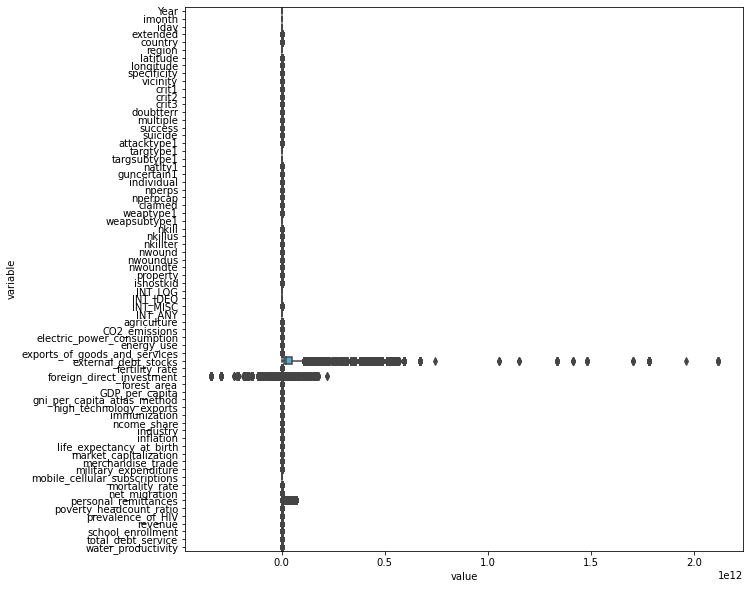

In [14]:
#generate boxplots for visualization of outliers in numerical columns
plt.figure(figsize=(10,10))
sns.boxplot(x="value", y="variable", data=pd.melt(numdf))
plt.show()

In [15]:
upper = data.external_debt_stocks.mean() + 3*data.external_debt_stocks.std()
lower = data.external_debt_stocks.mean() -3*data.external_debt_stocks.std()
data = data[(data.external_debt_stocks<upper) & (data.external_debt_stocks>lower)]
data.shape

(191577, 75)

In [16]:
#extract all categorical columns
categorics = ['object']
catdf = data.select_dtypes(include=categorics)
catdf.head()

,provstate,city,target1,gname,dbsource
0,National,Santo Domingo,Julio Guzman,MANO-D,PGIS
1,Federal,Mexico city,"Nadine Chaval, daughter",23rd of September Communist League,PGIS
2,Tarlac,Unknown,Employee,Unknown,PGIS
3,Attica,Athens,U.S. Embassy,Unknown,PGIS
4,Fukouka,Fukouka,U.S. Consulate,Unknown,PGIS


In [17]:
upper1 = data.foreign_direct_investment.mean() + 3*data.foreign_direct_investment.std()
lower1 = data.foreign_direct_investment.mean() -3*data.foreign_direct_investment.std()
data = data[(data.foreign_direct_investment<upper1) & (data.foreign_direct_investment>lower1)]
data.shape

(189582, 75)

In [18]:
upper2 = data.personal_remittances.mean() + 3*data.personal_remittances.std()
lower2 = data.personal_remittances.mean() -3*data.personal_remittances.std()
data = data[(data.personal_remittances<upper2) & (data.personal_remittances>lower2)]
data.shape

(187483, 75)

In [19]:
#save cleaned(no scaling) data to csv
data_clean_unscaled = data.copy()
#data.to_csv("data_clean_unscaled.csv", index=False)

## 3.3 Normalization/Standarization of numerical values

Normalising numerical values for World Development Indicator dataset.

In [20]:
data_norm = data.copy()
#num_features = df.dtypes[data_norm.dtypes != 'object'].index
#WDI data are numerical data which required to be normalisated
num_features_WDI = ['agriculture', 'CO2_emissions', 'electric_power_consumption',
       'energy_use', 'exports_of_goods_and_services', 'external_debt_stocks',
       'fertility_rate', 'foreign_direct_investment', 'forest_area',
       'GDP_per_capita', 'gni_per_capita_atlas_method',
       'high_technology_exports', 'immunization', 'ncome_share', 'industry',
       'inflation', 'life_expectancy_at_birth', 'market_capitalization',
       'merchandise_trade', 'military_expenditure',
       'mobile_cellular_subscriptions', 'mortality_rate', 'net_migration',
       'personal_remittances', 'poverty_headcount_ratio', 'prevalence_of_HIV',
       'revenue', 'school_enrollment', 'total_debt_service',
       'water_productivity']

[data_norm[col].update((data_norm[col] - data_norm[col].mean()) / (data_norm[col].std())) for col in num_features_WDI]

data_norm.head()

,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,National,Santo Domingo,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,Julio Guzman,58.0,MANO-D,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,PGIS,0,0,0,0,0.814048,-0.607415,-0.291830,-0.301651,-0.496695,-0.740213,1.775850,0.054430,-0.177076,-0.588545,-0.594663,-0.168274,0.166033,0.001653,-0.418445,-0.099285,-1.349957,-0.090272,-0.339961,-0.240698,-1.098485,1.651777,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.005344,-0.118053
1,1970,0,0,0,130,1,Federal,Mexico city,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,"Nadine Chaval, daughter",21.0,23rd of September Communist League,0.0,0,7.0,0.0,0.0,13,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1.0,PGIS,0,1,1,1,-0.419222,-0.151783,-0.291830,-0.301651,-1.250465,-0.596586,2.091516,0.027346,-0.177076,-0.522339,-0.530390,-0.168274,0.166033,0.001653,0.033752,-0.096621,-0.850544,-0.090272,-1.557121,-1.126850,-1.098485,1.233917,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.171547,-0.118053
2,1970,1,0,0,160,5,Tarlac,Unknown,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,Employee,217.0,Unknown,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,PGIS,-9,-9,1,1,1.160255,-0.607090,-0.291830,-0.301651,-0.210738,-0.701532,1.836187,0.027346,-0.177076,-0.610450,-0.611676,-0.168274,0.166033,0.001653,0.434337,-0.075570,-0.576623,-0.090272,-0.668106,-0.360714,-1.098485,0.666118,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.279134,-0.118053
3,1970,1,0,0,78,8,Attica,Athens,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,U.S. Embassy,217.0,Unknown,0.0,0,1.0,0.0,0.0,6,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,PGIS,-9,-9,1,1,0.007819,0.007559,-0.163412,-0.204608,-1.240981,-0.267207,-1.007016,0.027346,-0.177076,-0.374232,-0.320557,-0.168274,0.166033,0.001653,-0.257331,-0.101474,0.607154,-0.090272,-1.145142,0.581426,-1.098485,-0.629250,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053
4,1970,1,0,0,101,4,Fukouka,Fukouka,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,U.S. Consulate,217.0,Unknown,0.0,0,1.0,0.0,0.0,8,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,PGIS,-9,-9,1,1,0.007819,1.408600,1.169523,1.224971,-1.057883,-0.267207,-1.202008,0.027346,-0.177076,-0.270830,-0.303544,-0.168274,0.166033,0.001653,-0.257331,-0.092669,0.767047,-0.090272,-1.229576,-0.999502,-1.098485,-0.958623,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053


Normalising numerical values present in Global Terrorism Dataset.

In [21]:
num_feature_GTD = ['nperps', 'nperpcap', 'nkill', 'nkillus', 'nkillter', 'nwound', 'nwoundus', 'nwoundte']

[data_norm[col].update((data_norm[col]) / (data_norm[col].max())) for col in num_feature_GTD]

data_norm.head()

,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,National,Santo Domingo,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,Julio Guzman,58.0,MANO-D,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,PGIS,0,0,0,0,0.814048,-0.607415,-0.291830,-0.301651,-0.496695,-0.740213,1.775850,0.054430,-0.177076,-0.588545,-0.594663,-0.168274,0.166033,0.001653,-0.418445,-0.099285,-1.349957,-0.090272,-0.339961,-0.240698,-1.098485,1.651777,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.005344,-0.118053
1,1970,0,0,0,130,1,Federal,Mexico city,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,"Nadine Chaval, daughter",21.0,23rd of September Communist League,0.0,0,0.00028,0.0,0.0,13,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,0,1.0,PGIS,0,1,1,1,-0.419222,-0.151783,-0.291830,-0.301651,-1.250465,-0.596586,2.091516,0.027346,-0.177076,-0.522339,-0.530390,-0.168274,0.166033,0.001653,0.033752,-0.096621,-0.850544,-0.090272,-1.557121,-1.126850,-1.098485,1.233917,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.171547,-0.118053
2,1970,1,0,0,160,5,Tarlac,Unknown,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,Employee,217.0,Unknown,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,PGIS,-9,-9,1,1,1.160255,-0.607090,-0.291830,-0.301651,-0.210738,-0.701532,1.836187,0.027346,-0.177076,-0.610450,-0.611676,-0.168274,0.166033,0.001653,0.434337,-0.075570,-0.576623,-0.090272,-0.668106,-0.360714,-1.098485,0.666118,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.279134,-0.118053
3,1970,1,0,0,78,8,Attica,Athens,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,U.S. Embassy,217.0,Unknown,0.0,0,0.00004,0.0,0.0,6,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,PGIS,-9,-9,1,1,0.007819,0.007559,-0.163412,-0.204608,-1.240981,-0.267207,-1.007016,0.027346,-0.177076,-0.374232,-0.320557,-0.168274,0.166033,0.001653,-0.257331,-0.101474,0.607154,-0.090272,-1.145142,0.581426,-1.098485,-0.629250,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053
4,1970,1,0,0,101,4,Fukouka,Fukouka,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,U.S. Consulate,217.0,Unknown,0.0,0,0.00004,0.0,0.0,8,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,PGIS,-9,-9,1,1,0.007819,1.408600,1.169523,1.224971,-1.057883,-0.267207,-1.202008,0.027346,-0.177076,-0.270830,-0.303544,-0.168274,0.166033,0.001653,-0.257331,-0.092669,0.767047,-0.090272,-1.229576,-0.999502,-1.098485,-0.958623,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053


## 3.4 Label encoder

In [22]:
df=data_norm.copy()
df.head()
cat_features = df.dtypes[df.dtypes == 'object'].index

from sklearn import preprocessing
le = preprocessing.LabelEncoder()

for col in cat_features:
    df[col] = le.fit_transform(df[col])

print("size of data:", df.shape)
df.head()
#df.info()

size of data: (187483, 75)


,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,1535,30750,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,40210,58.0,1844,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,13,0,0,0,0,0.814048,-0.607415,-0.291830,-0.301651,-0.496695,-0.740213,1.775850,0.054430,-0.177076,-0.588545,-0.594663,-0.168274,0.166033,0.001653,-0.418445,-0.099285,-1.349957,-0.090272,-0.339961,-0.240698,-1.098485,1.651777,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.005344,-0.118053
1,1970,0,0,0,130,1,694,22943,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,48380,21.0,13,0.0,0,0.00028,0.0,0.0,13,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,0,1.0,13,0,1,1,1,-0.419222,-0.151783,-0.291830,-0.301651,-1.250465,-0.596586,2.091516,0.027346,-0.177076,-0.522339,-0.530390,-0.168274,0.166033,0.001653,0.033752,-0.096621,-0.850544,-0.090272,-1.557121,-1.126850,-1.098485,1.233917,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.171547,-0.118053
2,1970,1,0,0,160,5,2209,35664,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,27229,217.0,3304,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,13,-9,-9,1,1,1.160255,-0.607090,-0.291830,-0.301651,-0.210738,-0.701532,1.836187,0.027346,-0.177076,-0.610450,-0.611676,-0.168274,0.166033,0.001653,0.434337,-0.075570,-0.576623,-0.090272,-0.668106,-0.360714,-1.098485,0.666118,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.279134,-0.118053
3,1970,1,0,0,78,8,157,2796,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,74930,217.0,3304,0.0,0,0.00004,0.0,0.0,6,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,0.007819,0.007559,-0.163412,-0.204608,-1.240981,-0.267207,-1.007016,0.027346,-0.177076,-0.374232,-0.320557,-0.168274,0.166033,0.001653,-0.257331,-0.101474,0.607154,-0.090272,-1.145142,0.581426,-1.098485,-0.629250,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053
4,1970,1,0,0,101,4,717,11663,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,74910,217.0,3304,0.0,0,0.00004,0.0,0.0,8,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,0.007819,1.408600,1.169523,1.224971,-1.057883,-0.267207,-1.202008,0.027346,-0.177076,-0.270830,-0.303544,-0.168274,0.166033,0.001653,-0.257331,-0.092669,0.767047,-0.090272,-1.229576,-0.999502,-1.098485,-0.958623,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053


## 3.5 Correlation Matrix

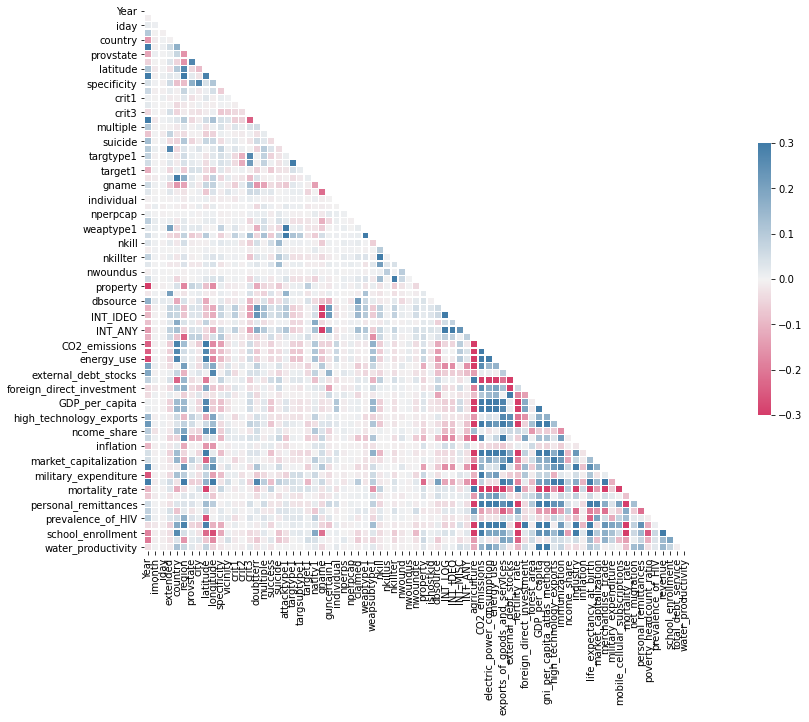

In [23]:
corr_matrix = df.corr()
#abs(corr_matrix['nkill']).sort_values(ascending=False).head(10)
#abs(corr_matrix['casualty']).sort_values(ascending=False).head(10)

mask = np.zeros_like(corr_matrix, dtype = np.bool_)
mask[np.triu_indices_from(mask)] = True
plt.subplots(figsize=(25,10))
cmap = sns.diverging_palette(0,240, as_cmap = True)
sns.heatmap(corr_matrix, mask=mask, cmap=cmap, vmin = -0.3, vmax=0.3, center=0, square=True, linewidths=.3, cbar_kws={"shrink": .5})

df[df == np.inf] = np.nan
df.fillna(df.mean(), inplace = True)

In [24]:
#save cleaned/scaled/normalized data to csv
data_clean = df.copy()
#df.to_csv("data_clean.csv", index=False)

# 4.0 Machine Learning Algorithm - Prediction 


## 4.1 Classification Problem Q1 - will the attack be successful?



In [25]:
df_Q1 = df.copy()
df_Q1.shape

(187483, 75)

### 4.1.1 Target variable - success

Counter({1: 167316, 0: 20167})


Text(0, 0.5, 'Frequency')

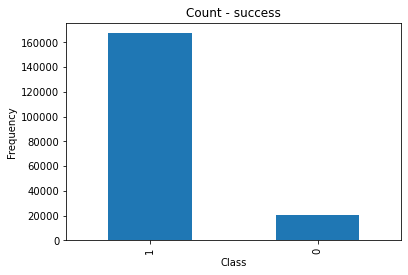

In [26]:
from collections import Counter
from matplotlib import pyplot

# summarize class distribution
counter = Counter(df_Q1['success'])
print(counter)
pd.value_counts(df_Q1['success']).plot.bar()
plt.title('Count - success')
plt.xlabel('Class')
plt.ylabel('Frequency')

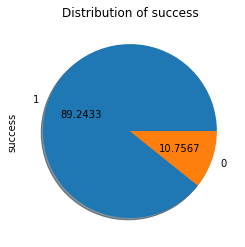

In [27]:
ax = df_Q1['success'].value_counts().plot(kind='pie',autopct='%.4f', shadow=True)
ax.set_title("Distribution of success")
plt.show()

The bar graph and pie-chart shows the target variable distribution - Success is imbalanced.

### 4.1.2 Univariate analysis

In [28]:
#drop all the target variables - for the multiple questions
cols_Q1 = df_Q1.columns.difference(['success','multiple','suicide','gname'])
cols_Q1

Index(['CO2_emissions', 'GDP_per_capita', 'INT_ANY', 'INT_IDEO', 'INT_LOG',
       'INT_MISC', 'Year', 'agriculture', 'attacktype1', 'city', 'claimed',
       'country', 'crit1', 'crit2', 'crit3', 'dbsource', 'doubtterr',
       'electric_power_consumption', 'energy_use',
       'exports_of_goods_and_services', 'extended', 'external_debt_stocks',
       'fertility_rate', 'foreign_direct_investment', 'forest_area',
       'gni_per_capita_atlas_method', 'guncertain1', 'high_technology_exports',
       'iday', 'immunization', 'imonth', 'individual', 'industry', 'inflation',
       'ishostkid', 'latitude', 'life_expectancy_at_birth', 'longitude',
       'market_capitalization', 'merchandise_trade', 'military_expenditure',
       'mobile_cellular_subscriptions', 'mortality_rate', 'natlty1',
       'ncome_share', 'net_migration', 'nkill', 'nkillter', 'nkillus',
       'nperpcap', 'nperps', 'nwound', 'nwoundte', 'nwoundus',
       'personal_remittances', 'poverty_headcount_ratio', 'prevalence

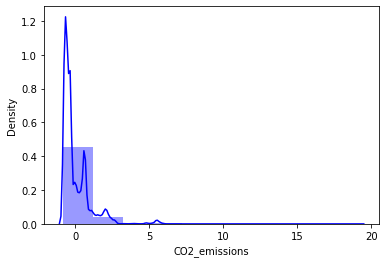

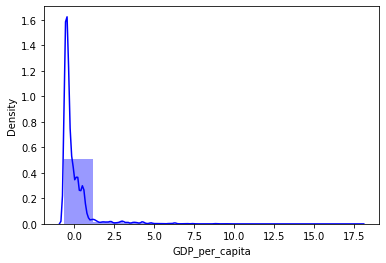

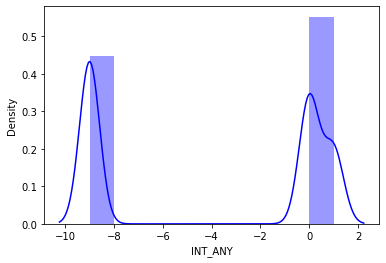

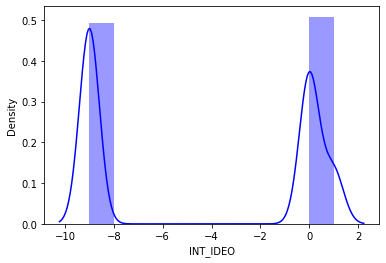

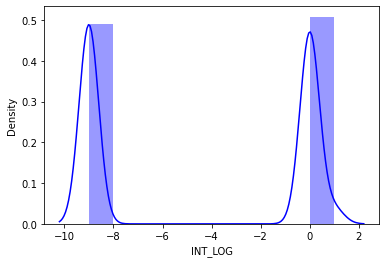

...

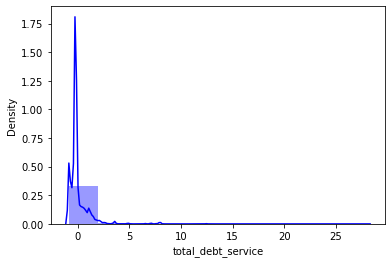

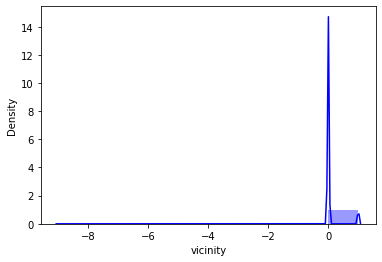

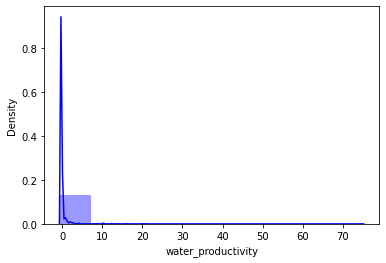

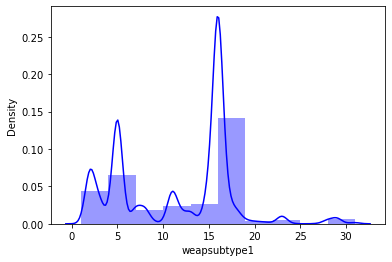

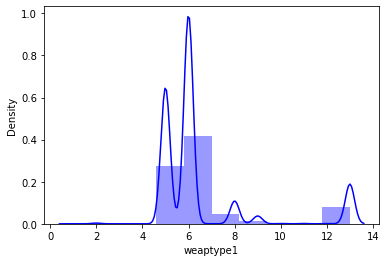

In [29]:
#distribution plot for each predictor 
for c in cols_Q1:
    sns.distplot(df_Q1[c], kde=True, color='blue',bins=10)
    plt.show()

### 4.1.3 Bivariate analysis

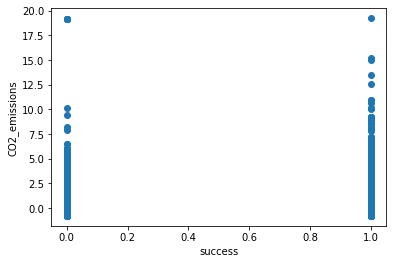

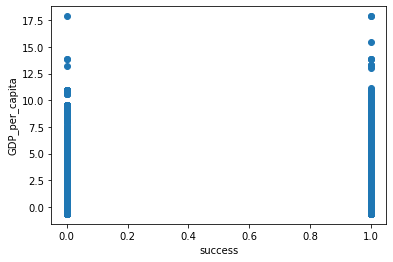

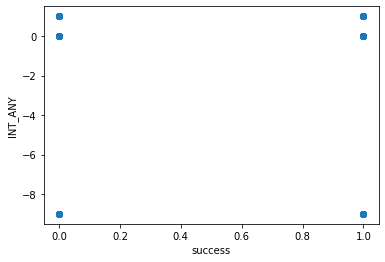

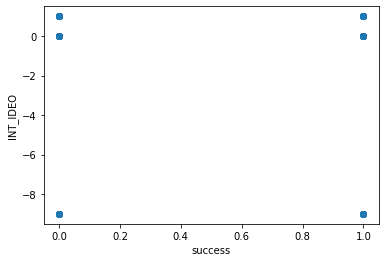

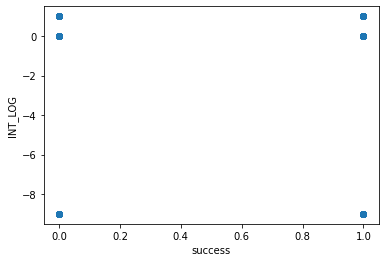

...

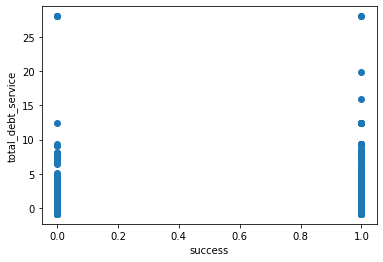

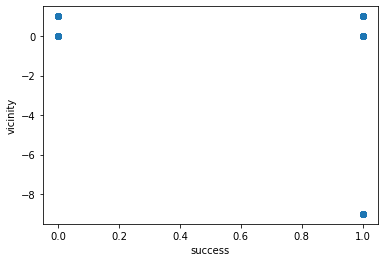

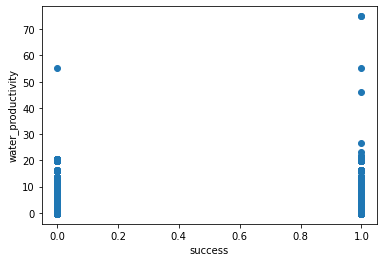

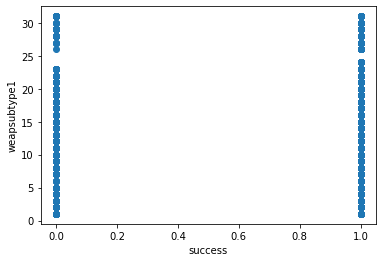

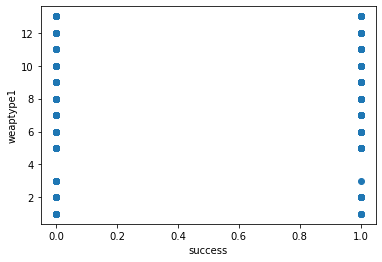

In [30]:
import seaborn as sns
for c in cols_Q1:
    #print(c)
    plt.scatter(df['success'], df_Q1[c])
    plt.xlabel('success')
    plt.ylabel(c)
    plt.show() 

### 4.1.4 Correlation analysis

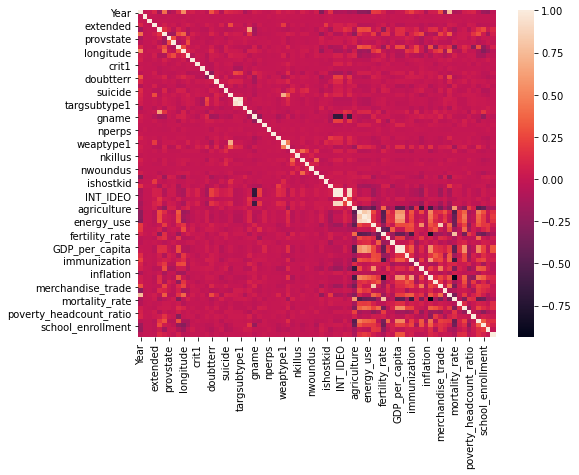

In [31]:
cor = df_Q1.corr()
fig = plt.figure(figsize=(8,6))
sns.heatmap(cor)
plt.show()

The economic indicators-like Population, personal_remittances etc show negative correlation with success of a terrorist attack.

### 4.1.5 Separate predictor and target variables

In [32]:
results_success = df_Q1

In [33]:
X_Q1=df_Q1.drop(['success','multiple','suicide','gname'],axis = 1)
X_Q1.shape

(187483, 71)

In [34]:
y_Q1=df_Q1['success']
y_Q1.shape

(187483,)

### 4.1.6 Train and Test split 

In [35]:
from sklearn.model_selection import train_test_split
X_Q1_train,X_Q1_test,y_Q1_train,y_Q1_test = train_test_split(X_Q1,y_Q1,test_size=0.20,random_state=42)

In [36]:
#print shape of train 
print(X_Q1_train.shape,y_Q1_train.shape)

(149986, 71) (149986,)


In [37]:
#print shape of test
print(X_Q1_test.shape,y_Q1_test.shape)

(37497, 71) (37497,)


### 4.1.7 Benchmark model

#### 4.1.6a Algorithm 1 - Random Forest Classifier

In [38]:
from sklearn.ensemble import RandomForestClassifier

#create instance of classifier with default parameters
rf = RandomForestClassifier()

#fit the model
rf.fit(X_Q1_train,y_Q1_train)

RandomForestClassifier()

In [39]:
#make predictions on training data
y_pred_train_rf = rf.predict(X_Q1_train)
y_pred_train_rf

array([1, 0, 1, ..., 1, 1, 1], dtype=int64)

In [40]:
#training accuracy 
from sklearn.metrics import accuracy_score
rf_train_accuracy = accuracy_score(y_Q1_train,y_pred_train_rf)
rf_train_accuracy

0.9997466430200151

In [41]:
#make predictions on test data
y_pred_test_rf = rf.predict(X_Q1_test)
y_pred_test_rf

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [42]:
#test accuracy
rf_test_accuracy = accuracy_score(y_Q1_test,y_pred_test_rf)
rf_test_accuracy

0.9586366909352748

#### 4.1.6b Algorithm 2 - Logistic Regression Classifier

In [43]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()

#fit the model
lr.fit(X_Q1_train,y_Q1_train)

LogisticRegression()

In [44]:
#make predictions on training data
y_pred_train_lr = lr.predict(X_Q1_train)
y_pred_train_lr

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [45]:
#make predictions on test data
y_pred_test_lr = lr.predict(X_Q1_test)
y_pred_test_lr

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [46]:
#test accuracy
lr_test_accuracy = accuracy_score(y_Q1_test,y_pred_test_lr)
lr_test_accuracy

0.8935114809184734

#### 4.1.6c Algorithm 3 - XgBoost Classifier

In [47]:
#create the basic XGBoost model
import xgboost 
from xgboost.sklearn import XGBClassifier

xg=XGBClassifier(max_depth=7,
                        learning_rate=0.05,
                       eta=1,
                        objective='binary:logistic',
                        use_label_encoder=False,
                        eval_metric='error') 

xg.fit(X_Q1_train, y_Q1_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eta=1, eval_metric='error', gamma=0, gpu_id=-1,
              importance_type=None, interaction_constraints='',
              learning_rate=0.05, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1, predictor='auto',
              random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
              subsample=1, tree_method='exact', use_label_encoder=False,
              validate_parameters=1, ...)

In [48]:
#make predictions on training data
y_pred_train_xg = xg.predict(X_Q1_train)
y_pred_train_xg 

array([1, 0, 1, ..., 1, 1, 1])

In [49]:
#training accuracy
xg_train_accuracy = accuracy_score(y_Q1_train,y_pred_train_xg)
xg_train_accuracy

0.9581094235461977

In [50]:
#make predictions on test data
y_pred_test_xg = xg.predict(X_Q1_test)
y_pred_test_xg 

array([1, 1, 1, ..., 1, 1, 1])

In [51]:
#test accuracy
xg_test_accuracy = accuracy_score(y_Q1_test,y_pred_test_xg)
xg_test_accuracy

0.957116569325546

As random forest is giving us the best accuracy results, we will perform parameter tuning for random forest.

### 4.1.7 Hyper-parameter tuning of random forest algorithm

In [52]:
from sklearn.model_selection import GridSearchCV

n_estimators = [25, 50]
max_depth = [5, 10]
min_samples_split = [2, 5]
min_samples_leaf = [3, 6] 

grid_params_rf_Q1 = dict(n_estimators = n_estimators, 
                  max_depth = max_depth,  
                  min_samples_split = min_samples_split, 
                 min_samples_leaf = min_samples_leaf)

rf_cv_Q1 = GridSearchCV(rf,
                     grid_params_rf_Q1, 
                     cv = 5,
                     verbose = 1, 
                     n_jobs = -1)

rf_cv_Q1.fit(X_Q1_train, y_Q1_train)         

Fitting 5 folds for each of 16 candidates, totalling 80 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [5, 10], 'min_samples_leaf': [3, 6],
                         'min_samples_split': [2, 5],
                         'n_estimators': [25, 50]},
             verbose=1)

In [53]:
#find the best parameters
rf_cv_Q1.best_params_

{'max_depth': 10,
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'n_estimators': 50}

In [54]:
#find the best score
rf_cv_Q1.best_score_

0.9288733604787017

In [55]:
#find the best estimator
rf_cv_Q1.best_estimator_

RandomForestClassifier(max_depth=10, min_samples_leaf=3, n_estimators=50)

### 4.1.8 Rebuild the optimized model

In [56]:
rf_best_Q1 = RandomForestClassifier(n_estimators=25, 
                                    max_depth=10,
                                    max_features='auto', 
                                    min_samples_leaf=3,
                                    min_samples_split=2,
                                    bootstrap=True, 
                                    n_jobs=-1, 
                                    random_state=0)

In [57]:
rf_best_Q1.fit(X_Q1_train, y_Q1_train)

RandomForestClassifier(max_depth=10, min_samples_leaf=3, n_estimators=25,
                       n_jobs=-1, random_state=0)

In [58]:
y_pred_best_Q1 = rf_best_Q1.predict(X_Q1_test)

In [59]:
accuracy_score(y_Q1_test,y_pred_best_Q1)

0.9280209083393338

### 4.1.9 Feature Importance

Text(101.625, 0.5, 'FEATURE NAMES')

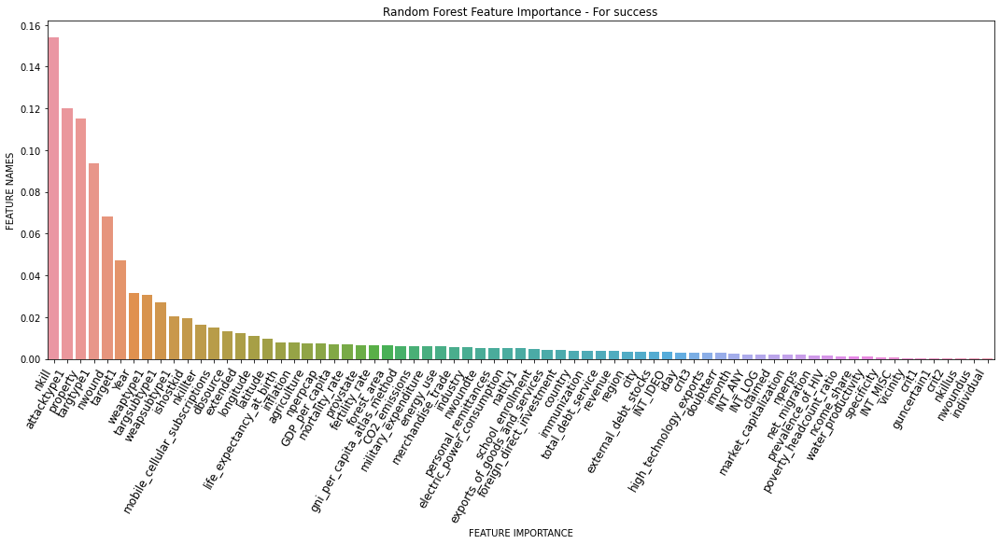

In [60]:
feature_importance_Q1 = np.array(rf_best_Q1.feature_importances_)
feature_names_Q1 = np.array(X_Q1_train.columns)

#create a DataFrame using a Dictionary
data_Q1={'feature_names':feature_names_Q1,'feature_importance':feature_importance_Q1}
fi_df_Q1 = pd.DataFrame(data_Q1)

#sort the DataFrame in order decreasing feature importance
fi_df_Q1.sort_values(by=['feature_importance'], ascending=False,inplace=True)

#define size of bar plot
plt.figure(figsize=(15,8))

#Plot Searborn bar chart
#sns.barplot(x=fi_df_Q1['feature_importance'], y=fi_df_Q1['feature_names'])
ax = sns.barplot(x=fi_df_Q1['feature_names'], y=fi_df_Q1['feature_importance'])

#add chart labels
ax.set_xticklabels(ax.get_xticklabels(), fontsize=12,rotation=60, ha="right")  #it will rotate text on x axis

plt.tight_layout()
plt.title('Random Forest Feature Importance - For success')
plt.xlabel('FEATURE IMPORTANCE')
plt.ylabel('FEATURE NAMES')

### 4.1.10 Confusion Matrix

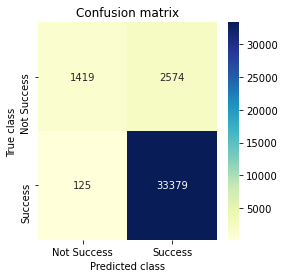

In [61]:
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve
LABELS = ['Not Success', 'Success']
cm = confusion_matrix(y_Q1_test, y_pred_best_Q1)
plt.figure(figsize=(4, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu',xticklabels=LABELS, yticklabels=LABELS)
plt.title("Confusion matrix")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

### 4.1.11 ROC-AUC curve

In [62]:
auc_score = metrics.roc_auc_score( y_Q1_test, y_pred_best_Q1 )
print(round( float( auc_score ), 2 ))

0.68


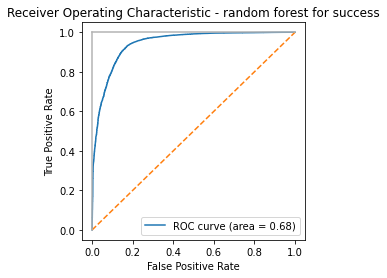

In [63]:

score = rf_best_Q1.predict_proba(X_Q1_test)[:,1]
false_positive_rate, true_positive_rate, thresholds = roc_curve(y_Q1_test, score)
plt.subplots(1, figsize=(4,4))
plt.title('Receiver Operating Characteristic - random forest for success')
plt.plot(false_positive_rate, true_positive_rate, label='ROC curve (area = %0.2f)' % auc_score)
plt.plot([0, 1], ls="--")
plt.plot([0, 0], [1, 0] , c=".7"), plt.plot([1, 1] , c=".7")
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc="lower right")
plt.show()

### 4.1.12 F1-score


In [64]:
f1_positive_Q1 = metrics.f1_score(y_Q1_test, y_pred_best_Q1, pos_label=1)
f1_negative_Q1 = metrics.f1_score(y_Q1_test, y_pred_best_Q1, pos_label=0)
f1_positive_Q1, f1_negative_Q1

(0.9611414256302461, 0.5125519234242369)

### 4.1.13 Precision

In [65]:
precision_positive_Q1 = metrics.precision_score(y_Q1_test, y_pred_best_Q1, pos_label=1)
precision_negative_Q1 = metrics.precision_score(y_Q1_test,y_pred_best_Q1, pos_label=0)
precision_positive_Q1, precision_negative_Q1

(0.9284065307484772, 0.9190414507772021)

### 4.1.14 Recall

In [66]:
recall_sensitivity_Q1 = metrics.recall_score(y_Q1_test, y_pred_best_Q1, pos_label=1)
recall_specificity_Q1 = metrics.recall_score(y_Q1_test, y_pred_best_Q1, pos_label=0)
recall_sensitivity_Q1, recall_specificity_Q1

(0.9962691021967526, 0.35537190082644626)

### 4.1.15 Run predictions for the entire file

In [67]:
y_pred_Q1 = rf_best_Q1.predict(X_Q1)
y_pred_Q1

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

### 4.1.16 Save predicton results into CSV

In [68]:
results_success.head(5)

,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,1535,30750,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,40210,58.0,1844,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,13,0,0,0,0,0.814048,-0.607415,-0.291830,-0.301651,-0.496695,-0.740213,1.775850,0.054430,-0.177076,-0.588545,-0.594663,-0.168274,0.166033,0.001653,-0.418445,-0.099285,-1.349957,-0.090272,-0.339961,-0.240698,-1.098485,1.651777,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.005344,-0.118053
1,1970,0,0,0,130,1,694,22943,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,48380,21.0,13,0.0,0,0.00028,0.0,0.0,13,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,0,1.0,13,0,1,1,1,-0.419222,-0.151783,-0.291830,-0.301651,-1.250465,-0.596586,2.091516,0.027346,-0.177076,-0.522339,-0.530390,-0.168274,0.166033,0.001653,0.033752,-0.096621,-0.850544,-0.090272,-1.557121,-1.126850,-1.098485,1.233917,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.171547,-0.118053
2,1970,1,0,0,160,5,2209,35664,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,27229,217.0,3304,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,13,-9,-9,1,1,1.160255,-0.607090,-0.291830,-0.301651,-0.210738,-0.701532,1.836187,0.027346,-0.177076,-0.610450,-0.611676,-0.168274,0.166033,0.001653,0.434337,-0.075570,-0.576623,-0.090272,-0.668106,-0.360714,-1.098485,0.666118,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.279134,-0.118053
3,1970,1,0,0,78,8,157,2796,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,74930,217.0,3304,0.0,0,0.00004,0.0,0.0,6,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,0.007819,0.007559,-0.163412,-0.204608,-1.240981,-0.267207,-1.007016,0.027346,-0.177076,-0.374232,-0.320557,-0.168274,0.166033,0.001653,-0.257331,-0.101474,0.607154,-0.090272,-1.145142,0.581426,-1.098485,-0.629250,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053
4,1970,1,0,0,101,4,717,11663,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,74910,217.0,3304,0.0,0,0.00004,0.0,0.0,8,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,0.007819,1.408600,1.169523,1.224971,-1.057883,-0.267207,-1.202008,0.027346,-0.177076,-0.270830,-0.303544,-0.168274,0.166033,0.001653,-0.257331,-0.092669,0.767047,-0.090272,-1.229576,-0.999502,-1.098485,-0.958623,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053


In [69]:

results_success['success_predicted_value'] = y_pred_Q1

In [70]:
results_success['success_predicted_value'].value_counts()

1    179420
0      8063
Name: success_predicted_value, dtype: int64

In [71]:
#save predictions on whole cleaned data to csv
results_success.to_csv("results_success.csv", index=False)

## 4.2 Classification Problem Q2 - Will there be any death/casualty?

In [72]:
df_q2 = data_clean.copy()

In [73]:
X=df_Q1.drop(['success','multiple','suicide','gname'],axis = 1)
X.shape

(187483, 72)

In [74]:
y=df_Q1['success']
y.shape

(187483,)

### Train and Test split 

### 4.2.1 Target Variable
In this problem, we want to predict if any death will happen('nkill'>0) in any terrorist attach.

Creating a boolean valiable 'casualty' and deleting the columns 'nkill', 'nkillus', 'nkillter' from dataset.


In [75]:
df_q2 = df_q2[df_q2['nkill'].notnull()]
df_q2['casualty'] = np.where(df_q2.nkill > 0, 1, 0)
df_q2 = df_q2.drop(['nkill'], axis = 1)
#df.shape

df_q2 = df_q2.drop(columns = ['nkillter', 'nkillus'])
print("size of df_q2:", df_q2.shape)

size of df_q2: (187483, 73)


(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Assassination'),
  Text(1, 0, 'Hostage Taking (Kidnapping)'),
  Text(2, 0, 'Bombing/Explosion'),
  Text(3, 0, 'Facility/Infrastructure Attack'),
  Text(4, 0, 'Armed Assault'),
  Text(5, 0, 'Hijacking'),
  Text(6, 0, 'Unknown'),
  Text(7, 0, 'Unarmed Assault'),
  Text(8, 0, 'Hostage Taking (Barricade Incident)')])

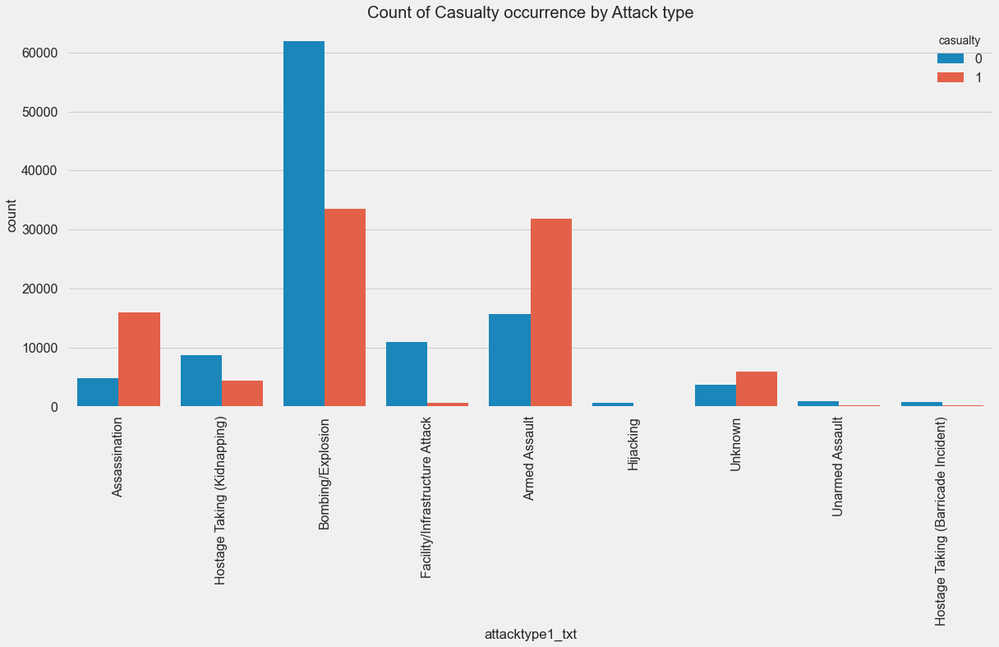

In [425]:
d = integrated_data.copy()
d['casualty'] = np.where(d.nkill > 0, 1, 0)

d.head()
plt.subplots(figsize=(18,8))
ax = sns.countplot(x='attacktype1_txt', hue='casualty', data=d)
ax.set_title('Count of Casualty occurrence by Attack type')
plt.xticks(rotation=90)

In [76]:
#import seaborn as sn
#plt.figure(figsize=(15,15))
#plt.title("Correlation Matrix")
#sn.heatmap(df_q2.corr(), color="k", annot=False, cmap="YlGnBu")

### 4.2.2 Splitting of data in Train and test

In [77]:
from sklearn.model_selection import train_test_split

target_q2 = df_q2['casualty']

# Split the 'features' and 'income' data into training and testing sets
X_train_q2, X_test_q2, y_train_q2, y_test_q2 = train_test_split(df_q2.drop(['casualty'], axis=1),
                                                    target_q2,
                                                    shuffle=True,
                                                    test_size = 0.2,
                                                    random_state = 43)

# Show the results of the split
print("Training set has {} samples.".format(X_train_q2.shape[0]))
print("Testing set has {} samples.".format(X_test_q2.shape[0]))
X_train_q2.head()

Training set has 149986 samples.
Testing set has 37497 samples.


,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
161649,2016,4,18,0,160,5,1305,8514,7.209594,124.241967,1.0,0,1,1,1,0,0,0,0,3,2,21.0,78376,160.0,3304,0.0,0,0.00004,0.0,0.0,6,12.0,0.000000,0.0,0.0,0,0.0,14,-9,-9,0,-9,-0.631704,-0.453771,-0.291830,-0.301651,0.147804,0.851842,-0.773025,-1.164700,-0.125985,-0.083526,-0.006754,-0.168274,0.562252,0.001653,0.007267,-0.105038,0.591627,1.656941,0.069243,-0.873753,1.537312,-0.673494,-0.020641,-0.298081,-0.112349,-0.217214,-0.734748,0.596682,-0.015316,-0.118053
127542,2014,2,18,0,95,10,1564,23621,36.354146,43.143571,1.0,0,1,1,1,0,0,1,0,3,3,23.0,52615,95.0,3304,0.0,0,0.00004,0.0,0.0,6,16.0,0.000545,0.0,0.0,0,0.0,14,-9,-9,0,-9,-1.216947,0.652678,0.018759,0.297814,1.054593,-0.267207,0.226216,2.255013,-0.229088,0.572528,0.617073,-0.168274,-0.116981,0.001653,2.086033,-0.102833,0.423272,-0.090272,0.935461,0.005818,1.083300,-0.634166,-0.020641,0.074896,-0.112349,-0.217214,2.605984,0.378175,-0.218345,-0.118053
45567,1991,2,15,0,153,6,193,8850,28.893738,64.405846,1.0,1,1,1,1,0,0,1,0,3,14,74.0,44086,153.0,3304,0.0,0,0.00004,0.0,0.0,6,16.0,0.002182,0.0,0.0,1,0.0,13,-9,-9,0,-9,0.770172,-0.651252,-0.598199,-0.627523,-0.572130,-0.248295,1.708890,0.014454,-0.160935,-0.573500,-0.583320,-0.168274,-1.079229,0.001653,-0.603776,-0.081384,-0.998581,-0.090272,-0.544229,1.677364,-1.098311,1.976234,-0.020641,-0.478969,-0.112349,-0.217214,-0.161000,0.378175,0.356751,-0.118053
133103,2014,6,8,0,95,10,593,15268,34.271035,45.163568,1.0,0,1,1,1,0,1,1,0,3,22,110.0,49706,95.0,1486,0.0,0,0.00004,0.0,1.0,6,15.0,0.004545,0.0,0.0,1,0.0,14,0,1,0,1,-1.216947,0.652678,0.018759,0.297814,1.054593,-0.267207,0.226216,2.255013,-0.229088,0.572528,0.617073,-0.168274,-0.116981,0.001653,2.086033,-0.102833,0.423272,-0.090272,0.935461,0.005818,1.083300,-0.634166,-0.020641,0.074896,-0.112349,-0.217214,2.605984,0.378175,-0.218345,-0.118053
200594,2019,12,4,0,4,6,855,19927,31.600826,64.370529,1.0,0,1,1,1,0,0,1,0,1,3,25.0,24603,4.0,3304,0.0,0,0.00004,0.0,0.0,5,5.0,0.000000,0.0,0.0,0,0.0,14,-9,-9,0,-9,1.095370,-0.347856,-0.291830,-0.301651,-0.210738,-0.691561,0.406492,0.070063,-0.222736,-0.558347,-0.560636,-0.623991,-0.343392,0.001653,-1.340917,-0.102684,-0.320271,-0.090272,-0.182069,-0.840212,0.251945,0.088487,-0.020641,-0.278453,-0.112349,-0.217214,-0.161000,0.378175,-0.812486,-0.118053


### 4.2.3 Benchmark Model
#### 4.2.3.1 Decision Tree Classifier

In [78]:
from sklearn.metrics import fbeta_score, accuracy_score
from sklearn.tree import DecisionTreeClassifier

DTC_q2 = DecisionTreeClassifier(random_state = 43)

DTC_q2 = DTC_q2.fit(X_train_q2, y_train_q2)
bench_acc_q2 = accuracy_score(y_test_q2, DTC_q2.predict(X_test_q2))
bench_fsc_q2 = fbeta_score(y_test_q2, DTC_q2.predict(X_test_q2), 0.5)

print('-'*40)
print("Benchmark Model:")
print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
print("F_score: %.2f" %round(bench_fsc_q2*100,2))
print('-'*40)

----------------------------------------
Benchmark Model:
Accuracy: 79.66
F_score: 78.72
----------------------------------------


In [79]:
#accuracy on training data
#bench_acc_q2 = accuracy_score(y_train_q2, DTC_q2.predict(X_train_q2))
#bench_fsc_q2 = fbeta_score(y_train_q2, DTC_q2.predict(X_train_q2), 0.5)

#print('-'*40)
#print("Benchmark Model:")
#print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
#print("F_score: %.2f" %round(bench_fsc_q2*100,2))
#print('-'*40)

Benchmark model performance without using WDI data shows less accurancy compared to the above model. (presented here just for reference.)

In [80]:
df_q2.columns
a= ['Year', 'imonth', 'iday', 'extended', 'country', 'region', 'provstate',
       'city', 'latitude', 'longitude', 'specificity', 'vicinity', 'crit1',
       'crit2', 'crit3', 'doubtterr', 'multiple', 'success', 'suicide',
       'attacktype1', 'targtype1', 'targsubtype1', 'target1', 'natlty1',
       'gname', 'guncertain1', 'individual', 'nperps', 'nperpcap', 'claimed',
       'weaptype1', 'weapsubtype1', 'nwound', 'nwoundus', 'nwoundte',
       'property', 'ishostkid', 'dbsource', 'INT_LOG', 'INT_IDEO', 'INT_MISC',
       'INT_ANY','casualty']
df_2=df_q2[a]
df_2.head()

target_2 = df_2['casualty']

# Split the 'features' and 'income' data into training and testing sets
X_train_2, X_test_2, y_train_2, y_test_2 = train_test_split(df_2.drop(['casualty'], axis=1),
                                                    target_2,
                                                    shuffle=True,
                                                    test_size = 0.2,
                                                    random_state = 43)

DTC_2 = DecisionTreeClassifier(random_state = 43)

DTC_2 = DTC_2.fit(X_train_2, y_train_2)
bench_acc_2 = accuracy_score(y_test_2, DTC_2.predict(X_test_2))
bench_fsc_2 = fbeta_score(y_test_2, DTC_2.predict(X_test_2), 0.5)

print('-'*40)
print("Benchmark Model:")
print("Accuracy: %.2f" %round(bench_acc_2*100,2))
print("F_score: %.2f" %round(bench_fsc_2*100,2))
print('-'*40)

----------------------------------------
Benchmark Model:
Accuracy: 79.48
F_score: 78.44
----------------------------------------


#### 4.2.3.1 Other Classification Model (KNN, Random Forest & AdaBoost)
Result shows that Random Forest classification model provides the best accuracy among all model run here.

In [81]:
# Importing other supervised learning models from sklearn
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import fbeta_score
#from sklearn.svm import SVC

# Initializing the models
Modelq2_A = KNeighborsClassifier()
Modelq2_B = RandomForestClassifier(random_state = 41)
Modelq2_C = AdaBoostClassifier(random_state = 41)
Modelq2_D = GaussianNB()
#Modelq2_E = SVC()

#KNeighborsClassifier
Modelq2_A = Modelq2_A.fit(X_train_q2, y_train_q2)
bench_acc_q2 = accuracy_score(y_test_q2, Modelq2_A.predict(X_test_q2))
bench_fsc_q2 = fbeta_score(y_test_q2, Modelq2_A.predict(X_test_q2), 0.5)

print('-'*40)
print("Benchmark Model:KNeighborsClassifier")
print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
print("F_score: %.2f" %round(bench_fsc_q2*100,2))
print('-'*40)

#RandomForestClassifier
Modelq2_B = Modelq2_B.fit(X_train_q2, y_train_q2)
bench_acc_q2 = accuracy_score(y_test_q2, Modelq2_B.predict(X_test_q2))
bench_fsc_q2 = fbeta_score(y_test_q2, Modelq2_B.predict(X_test_q2), 0.5)

print('-'*40)
print("Benchmark Model:RandomForestClassifier")
print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
print("F_score: %.2f" %round(bench_fsc_q2*100,2))
print('-'*40)

#AdaBoostClassifier
Modelq2_C = Modelq2_C.fit(X_train_q2, y_train_q2)
bench_acc_q2 = accuracy_score(y_test_q2, Modelq2_C.predict(X_test_q2))
bench_fsc_q2 = fbeta_score(y_test_q2, Modelq2_C.predict(X_test_q2), 0.5)

print('-'*40)
print("Benchmark Model:AdaBoostClassifier")
print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
print("F_score: %.2f" %round(bench_fsc_q2*100,2))
print('-'*40)

#GaussianNB
Modelq2_D = Modelq2_D.fit(X_train_q2, y_train_q2)
bench_acc_q2 = accuracy_score(y_test_q2, Modelq2_D.predict(X_test_q2))
bench_fsc_q2 = fbeta_score(y_test_q2, Modelq2_D.predict(X_test_q2), 0.5)

print('-'*40)
print("Benchmark Model:GaussianNB")
print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
print("F_score: %.2f" %round(bench_fsc_q2*100,2))
print('-'*40)


#SVC
#Modelq2_E = Modelq2_E.fit(X_train_q2, y_train_q2)
#bench_acc_q2 = accuracy_score(y_test_q2, Modelq2_E.predict(X_test_q2))
#bench_fsc_q2 = fbeta_score(y_test_q2, Modelq2_E.predict(X_test_q2), 0.5)

#print('-'*40)
#print("Benchmark Model:SVC")
#print("Accuracy: %.2f" %round(bench_acc_q2*100,2))
#print("F_score: %.2f" %round(bench_fsc_q2*100,2))
#print('-'*40)

----------------------------------------
Benchmark Model:KNeighborsClassifier
Accuracy: 63.10
F_score: 61.29
----------------------------------------
----------------------------------------
Benchmark Model:RandomForestClassifier
Accuracy: 84.94
F_score: 84.41
----------------------------------------
----------------------------------------
Benchmark Model:AdaBoostClassifier
Accuracy: 79.59
F_score: 78.45
----------------------------------------
----------------------------------------
Benchmark Model:GaussianNB
Accuracy: 61.76
F_score: 60.63
----------------------------------------


It is evident from above that RandomForest classifier has the highest accuracy among all classifer run on the dataset. So, in the next few section, we will fine tune the RandomTree classifer.

### 4.2.4 Tuning the Random Forest Classifier

#### 4.2.4.1 
checking with features with more than 1% importance

In [82]:
from sklearn.feature_selection import SelectFromModel

feat_labels = df_q2.columns
sfm = SelectFromModel(Modelq2_B, threshold=0.01)
sfm.fit(X_train_q2, y_train_q2)
important_feat = [feat_labels[col] for col in sfm.get_support(indices=True)]
#for feature_list_index in sfm.get_support(indices=True):
#    print(feat_labels[feature_list_index])
#important_feat.append('casualty')

X_important_test = sfm.transform(X_test_q2)
X_important_train = sfm.transform(X_train_q2)

print('-'*40)
print('Feature Selection:')
print('before')
print(X_train_q2.shape)
print('after')
print(X_important_train.shape)
print('-'*40)

#important_feat

----------------------------------------
Feature Selection:
before
(149986, 72)
after
(149986, 25)
----------------------------------------


In [83]:
rf = RandomForestClassifier(random_state = 41)
rf.fit(X_important_train, y_train_q2)
important_pred = rf.predict(X_important_test)

print("Accuracy after Feature Selection: %.2f" %round((accuracy_score(y_test_q2, important_pred)*100),2))
print("F_score after Feature Selection: %.2f" %round((fbeta_score(y_test_q2, important_pred, 0.5)*100),2))

Accuracy after Feature Selection: 84.85
F_score after Feature Selection: 84.39


#### 4.2.4.2 Validation set

In [84]:
X_intermediate, X_test_q2, y_intermediate, y_test_q2 = train_test_split(df_q2.drop(['casualty'], axis=1),
                                                                  target_q2,
                                                                  shuffle=True,
                                                                  test_size = 0.2,
                                                                  random_state = 43)

X_train_q2, X_validation, y_train_q2, y_validation = train_test_split(X_intermediate,
                                                                y_intermediate,
                                                                shuffle=False,
                                                                test_size=0.2,
                                                                random_state=43)
# delete intermediate variables
del X_intermediate, y_intermediate

# print proportions
print('train: {}% | validation: {}% | test {}%'.format(round(float(len(y_train_q2))/len(target_q2),2),
                                                       round(float(len(y_validation))/len(target_q2),2),
                                                       round(float(len(y_test_q2))/len(target_q2),2)))

train: 0.64% | validation: 0.16% | test 0.2%


In [85]:
rf.fit(X_train_q2, y_train_q2)

print('-'*40)
print("Train:")
print("Accuracy: %.2f" %round((accuracy_score(y_train_q2, rf.predict(X_train_q2))*100),2))
print("F_score: %.2f" %round((fbeta_score(y_train_q2, rf.predict(X_train_q2), 0.5)*100),2))
print('-'*40)
print("Validation:")
print("Accuracy: %.2f" %round((accuracy_score(y_validation, rf.predict(X_validation))*100),2))
print("F_score: %.2f" %round((fbeta_score(y_validation, rf.predict(X_validation), 0.5)*100),2))
print('-'*40)
print("Test:")
print("Accuracy: %.2f" %round((accuracy_score(y_test_q2, rf.predict(X_test_q2))*100),2))
print("F_score: %.2f" %round((fbeta_score(y_test_q2, rf.predict(X_test_q2), 0.5)*100),2))
print('-'*40)

----------------------------------------
Train:
Accuracy: 99.93
F_score: 99.94
----------------------------------------
Validation:
Accuracy: 85.23
F_score: 84.84
----------------------------------------
Test:
Accuracy: 84.62
F_score: 84.15
----------------------------------------


#### 4.2.4.2 Tunning hyper-parameter of the model

In [86]:
from sklearn.model_selection import RandomizedSearchCV

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 2, stop = 20, num = 5)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(1, 11, num = 5)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

{'n_estimators': [2, 6, 11, 15, 20], 'max_features': ['auto', 'sqrt'], 'max_depth': [1, 3, 6, 8, 11, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


In [87]:
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, cv = 3, verbose=2, random_state=42, n_jobs = -1)

# Fit the random search model
rf_random.fit(X_train_q2, y_train_q2)
best_random = rf_random.best_estimator_
best_random

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomForestClassifier(bootstrap=False, min_samples_leaf=2, min_samples_split=5,
                       n_estimators=20, random_state=41)

In [88]:
best_random_q2 = RandomForestClassifier(bootstrap=False, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=2, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=20, n_jobs=1,
            oob_score=False, random_state=41, verbose=0, warm_start=False)

In [89]:
new_rf = best_random_q2
new_rf.fit(X_train_q2, y_train_q2)

print('-'*40)
print("Test:")
print("Accuracy: %.2f" %round((accuracy_score(y_test_q2, new_rf.predict(X_test_q2))*100),2))
print("F_score: %.2f" %round((fbeta_score(y_test_q2, new_rf.predict(X_test_q2), 0.5)*100),2))
print('-'*40)

----------------------------------------
Test:
Accuracy: 84.21
F_score: 83.53
----------------------------------------


### 4.2.5 Confusion Matrix

In [90]:
from sklearn import metrics

conf_matrix = metrics.confusion_matrix(y_test_q2, new_rf.predict(X_test_q2))
TP = conf_matrix[1, 1]
TN = conf_matrix[0, 0]
FP = conf_matrix[0, 1]
FN = conf_matrix[1, 0]
conf_mat_df = pd.DataFrame(conf_matrix).astype(int)
conf_mat_df = conf_mat_df.rename(index={0:"no_death_true"})
conf_mat_df = conf_mat_df.rename(index={1:"death_true"})
conf_mat_df = conf_mat_df.rename(columns={0:"no_death_pred"})
conf_mat_df = conf_mat_df.rename(columns={1:"death_pred"})
print("Given death occurrance in attacks, the model mistakenly predicted no deathes in {}% cases.".format(round(float(FN)/(FN+TP)*100,2)))

Given death occurrance in attacks, the model mistakenly predicted no deathes in 16.81% cases.


Text(0.5, 1.0, 'Confusion Matrix')

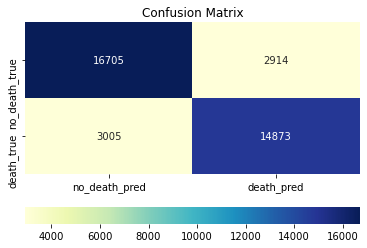

In [91]:
grid_kws = {"height_ratios": (.8, .05), "hspace": .3}
ax = sns.heatmap(conf_mat_df, annot = True, fmt='d', cmap="YlGnBu",  cbar_kws={"orientation": "horizontal"})
ax.set_title("Confusion Matrix")

### 4.2.6 ROC Curve

In [92]:
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit


def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

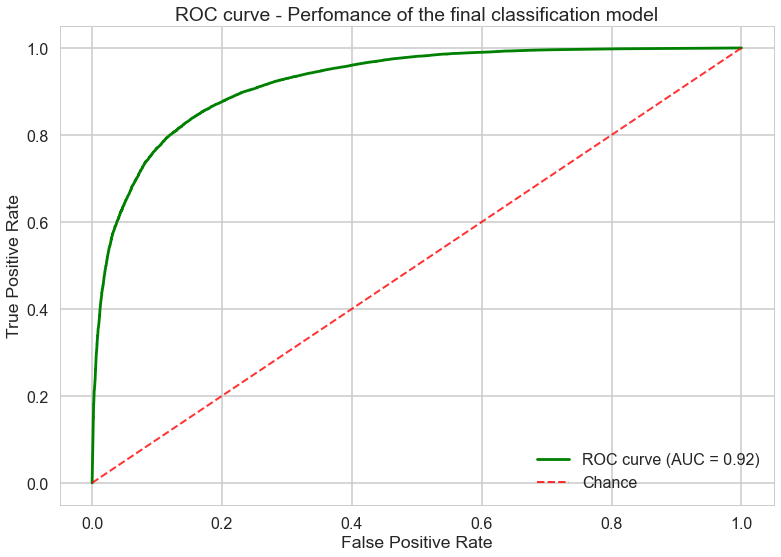

In [93]:
plt.style.use(['seaborn-whitegrid','seaborn-poster'])
y_pred_proba = new_rf.predict_proba(X_test_q2)[::,1]
fpr, tpr, thresholds = metrics.roc_curve(y_test_q2, y_pred_proba)
auc = metrics.roc_auc_score(y_test_q2, y_pred_proba)
plt.plot(fpr, tpr,color='g', label = "ROC curve (AUC = "+str(round(auc,2))+')')
plt.plot([0,1],[0,1], linestyle = '--', lw=2, color ='r', label='Chance', alpha=.8)
plt.legend(loc=4)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC curve - Perfomance of the final classification model")
plt.show()

### 4.2.6 Feature Importance

Feature ranking:


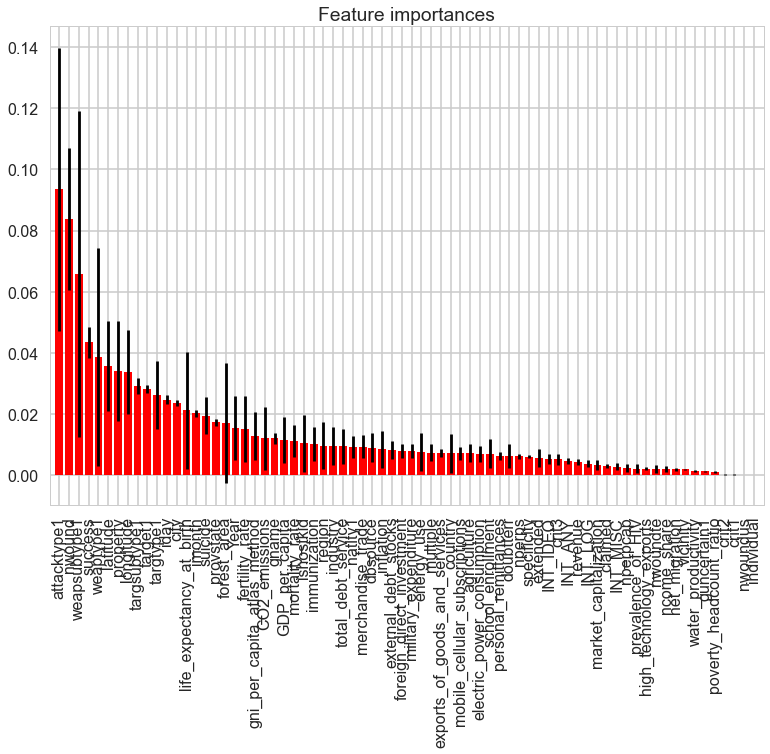

In [94]:
# Feature Importance

X = df_q2.drop(['casualty'], axis=1)
y = df_q2['casualty']

importances = new_rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in new_rf.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

feat_importances = [(feature, round(importance, 3)) for feature, importance in zip(df.columns, importances)]
feat_importances = sorted(feat_importances, key = lambda x: x[1], reverse = True)
feat_importances

#for f in range(X.shape[1]):
#    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]), X.columns[indices], rotation = 90)
plt.xlim([-1, X.shape[1]])
plt.show()
# display the relative importance of each attribute
#print(model.feature_importances_)

### 4.2.6 Run prediction for entire clean data

In [95]:
y_predict_Q2 = new_rf.predict(X)
y_predict_Q2.shape


final_table = data_clean_unscaled.copy()

final_table['casualty'] = np.where(final_table.nkill > 0, 1, 0)
final_table['casualty_predict'] = y_predict_Q2
final_table.head()
final_table.to_csv('Casualty_Predict.csv')


    
## 4.3 Classification Problem Q3 - Whether it will be Suicide attack - classification

   
    

In [96]:
df_Q3 = df.copy()
df_Q3.shape

(187483, 75)

### 4.3.1 Target variable - suicide

Counter({0: 180423, 1: 7060})


Text(0, 0.5, 'Frequency')

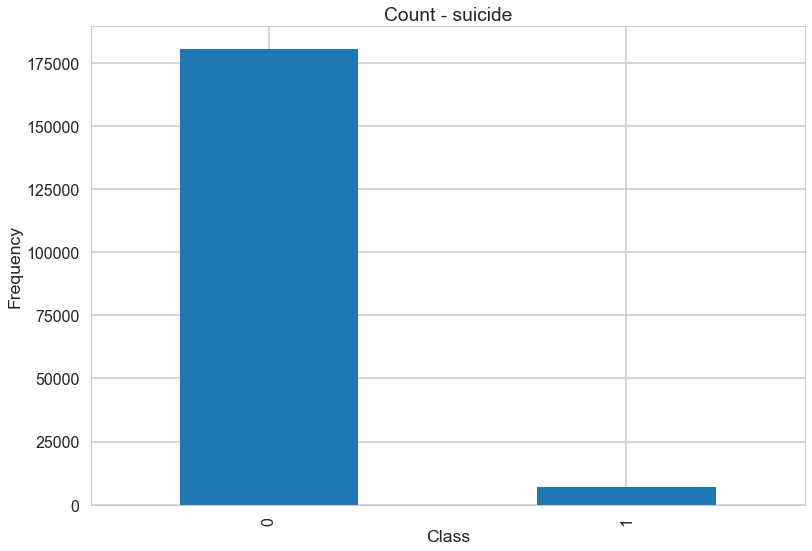

In [97]:
from collections import Counter
from matplotlib import pyplot

# summarize class distribution
counter = Counter(df_Q3['suicide'])
print(counter)
pd.value_counts(df_Q3['suicide']).plot.bar()
plt.title('Count - suicide')
plt.xlabel('Class')
plt.ylabel('Frequency')

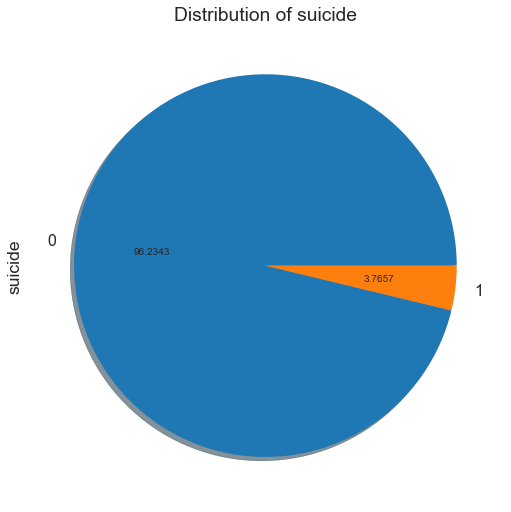

In [98]:
ax = df_Q3['suicide'].value_counts().plot(kind='pie',autopct='%.4f', shadow=True)
ax.set_title("Distribution of suicide")
plt.show()

### 4.3.2 Univariate Analysis

In [99]:
cols_Q3 = df_Q3.columns.difference(['suicide','success','multiple','gname'])
cols_Q3

Index(['CO2_emissions', 'GDP_per_capita', 'INT_ANY', 'INT_IDEO', 'INT_LOG',
       'INT_MISC', 'Year', 'agriculture', 'attacktype1', 'city', 'claimed',
       'country', 'crit1', 'crit2', 'crit3', 'dbsource', 'doubtterr',
       'electric_power_consumption', 'energy_use',
       'exports_of_goods_and_services', 'extended', 'external_debt_stocks',
       'fertility_rate', 'foreign_direct_investment', 'forest_area',
       'gni_per_capita_atlas_method', 'guncertain1', 'high_technology_exports',
       'iday', 'immunization', 'imonth', 'individual', 'industry', 'inflation',
       'ishostkid', 'latitude', 'life_expectancy_at_birth', 'longitude',
       'market_capitalization', 'merchandise_trade', 'military_expenditure',
       'mobile_cellular_subscriptions', 'mortality_rate', 'natlty1',
       'ncome_share', 'net_migration', 'nkill', 'nkillter', 'nkillus',
       'nperpcap', 'nperps', 'nwound', 'nwoundte', 'nwoundus',
       'personal_remittances', 'poverty_headcount_ratio', 'prevalence

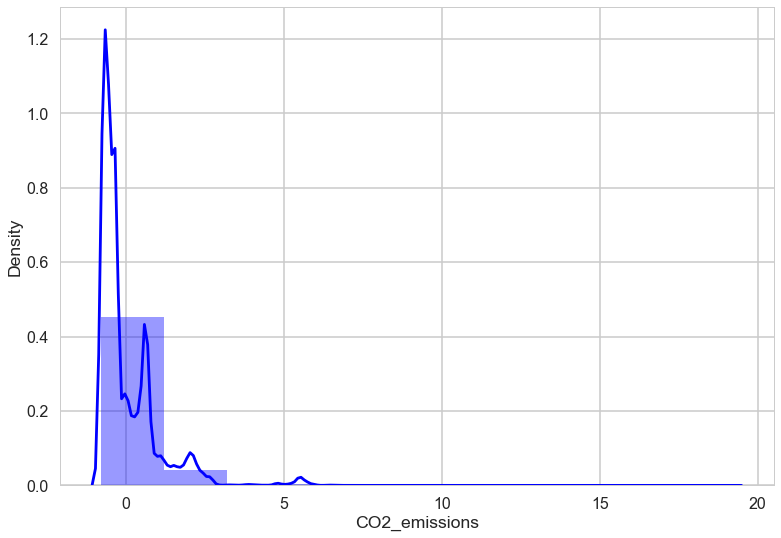

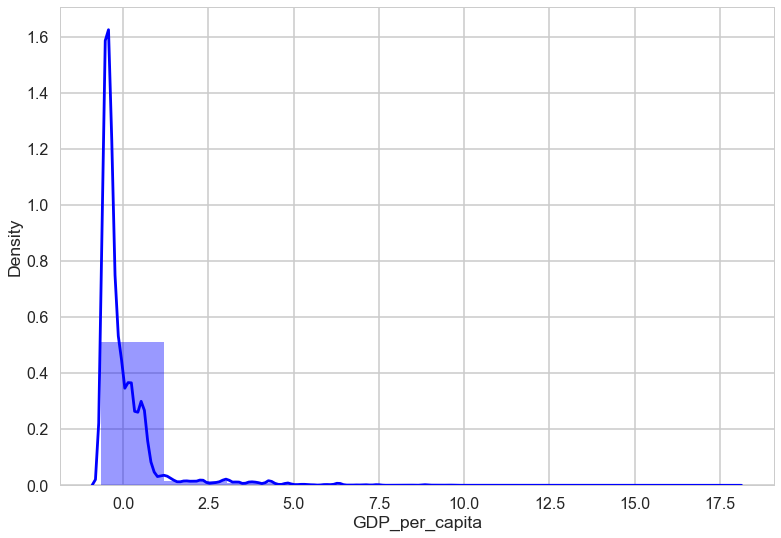

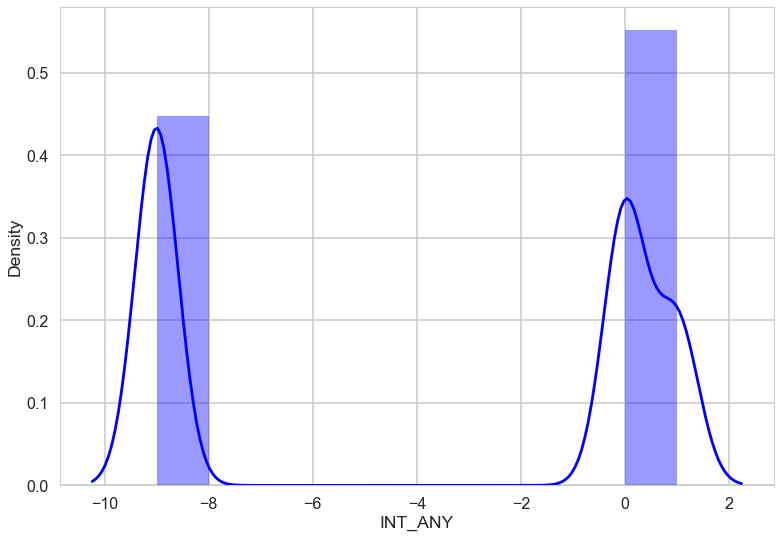

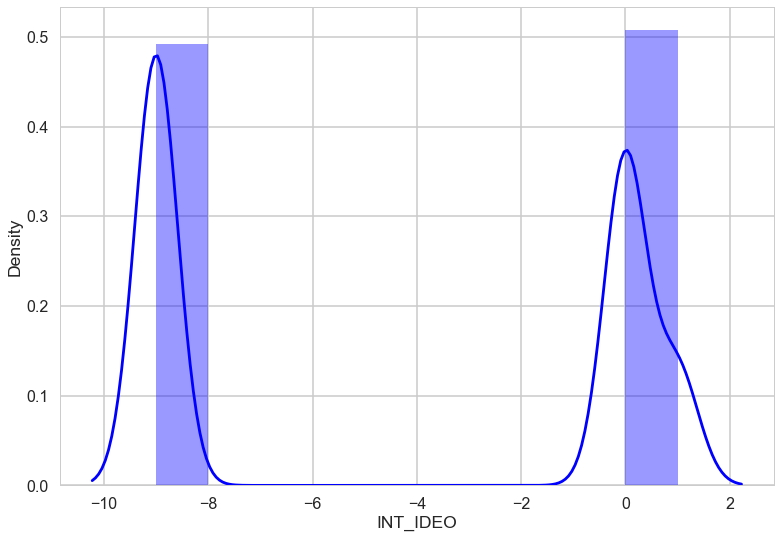

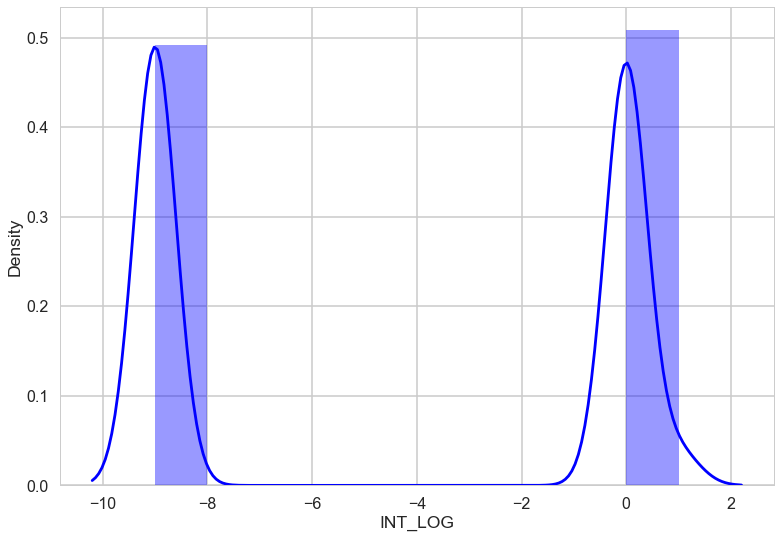

...

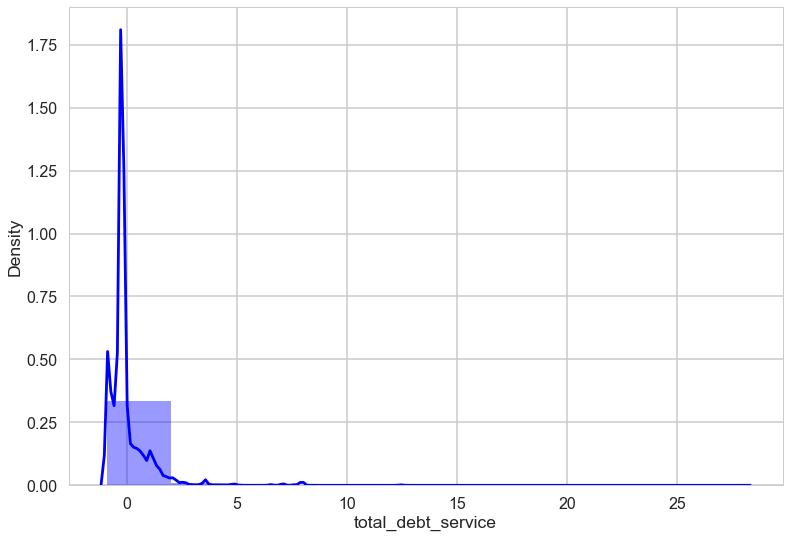

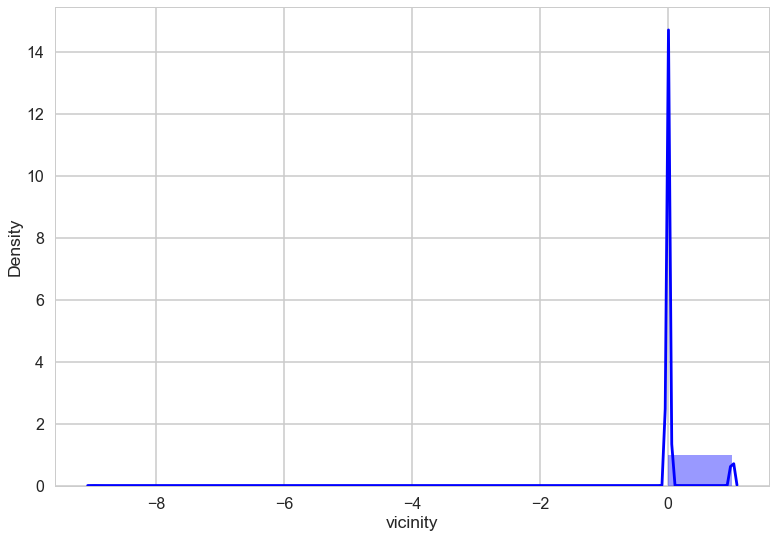

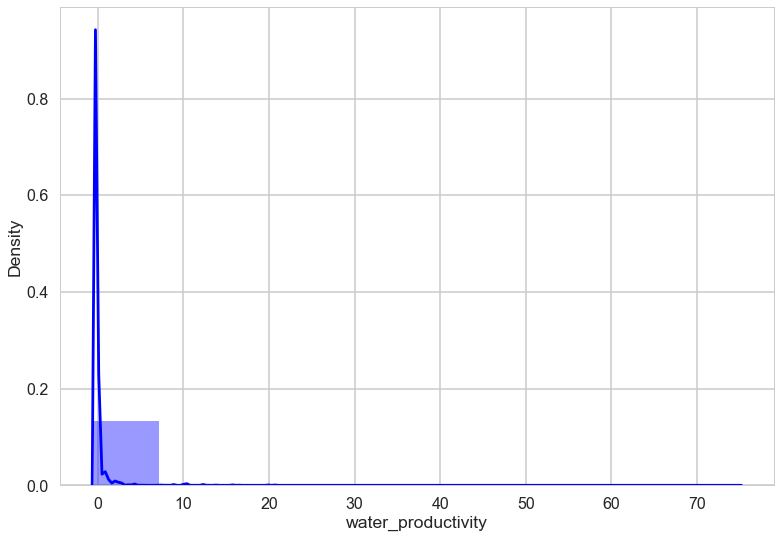

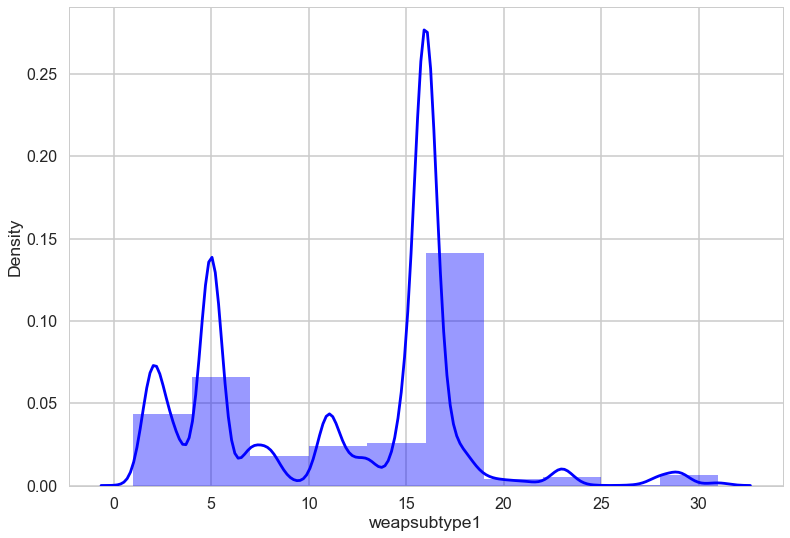

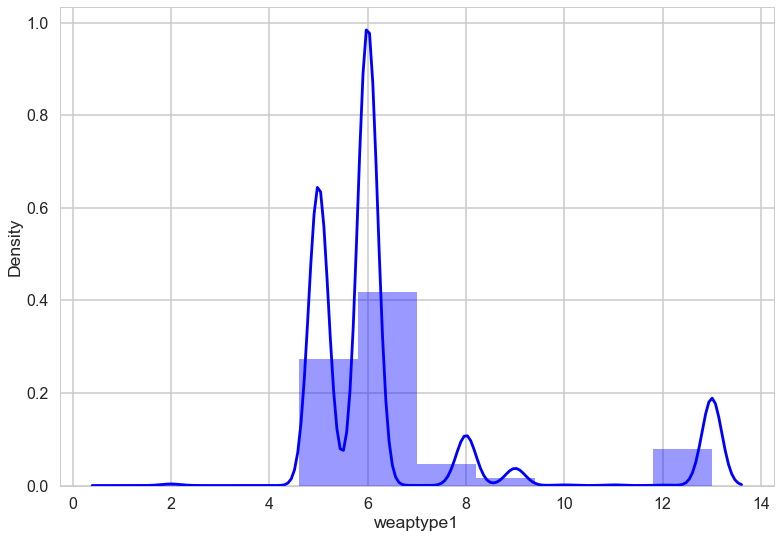

In [100]:
# distribution plot for each predictor 
for c in cols_Q3:
    sns.distplot(df_Q3[c], kde=True, color='blue',bins=10)
    plt.show() 

### 4.3.3 Bivariate Analysis

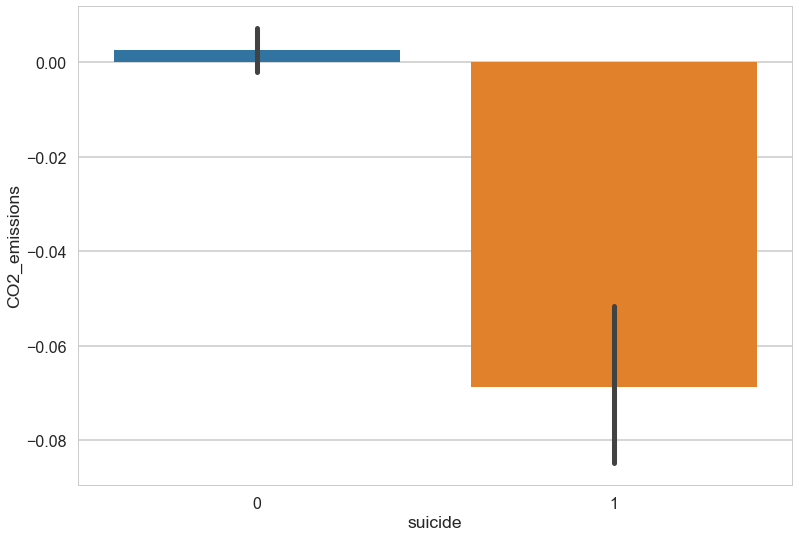

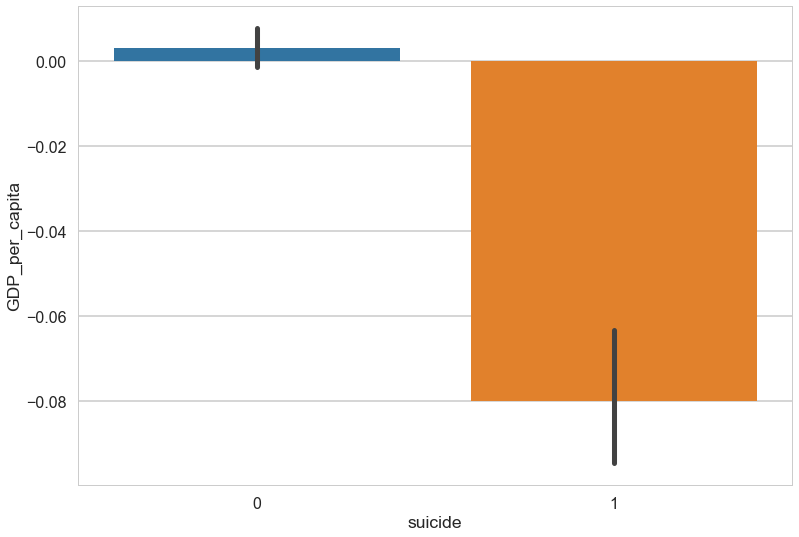

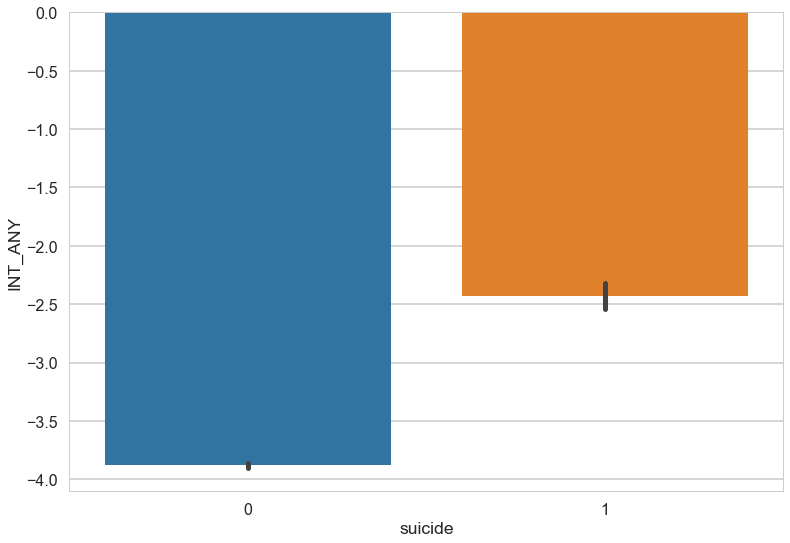

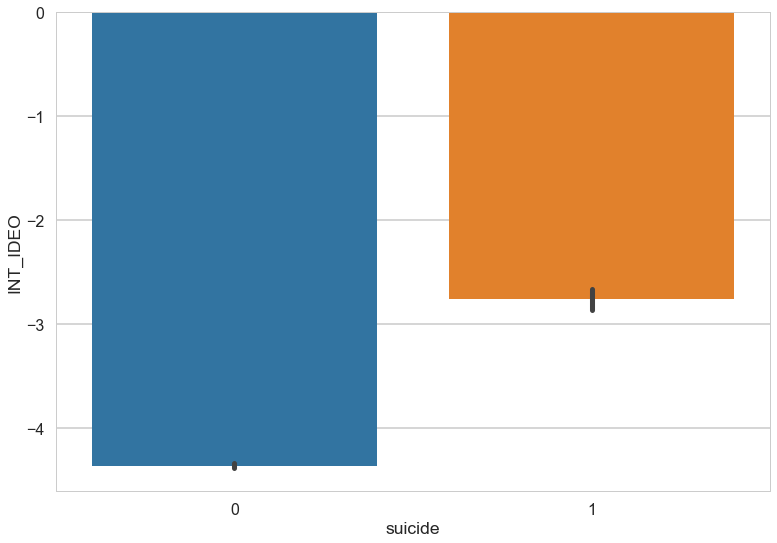

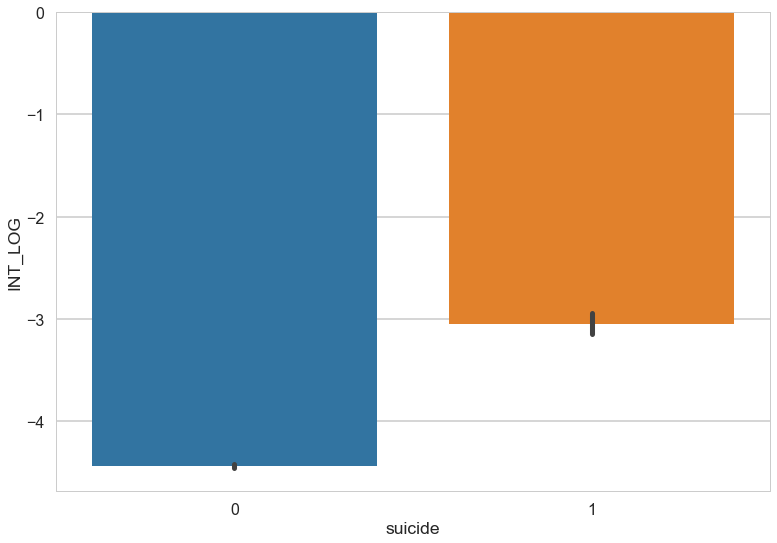

...

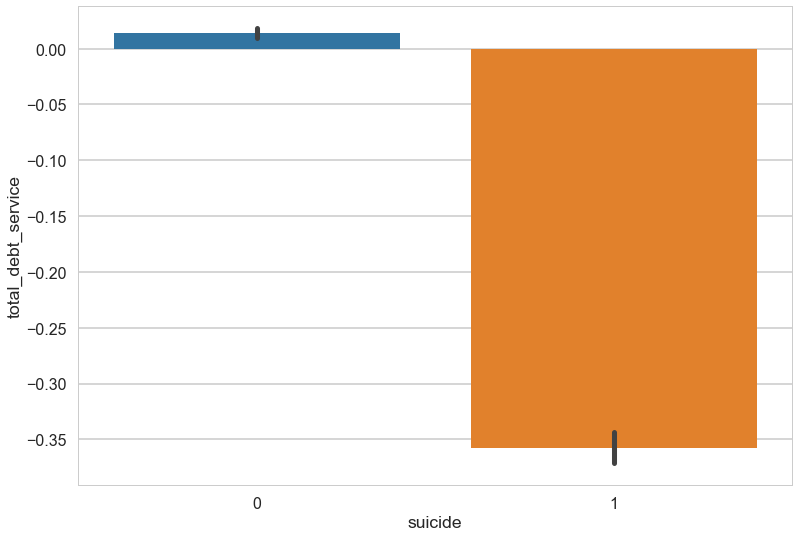

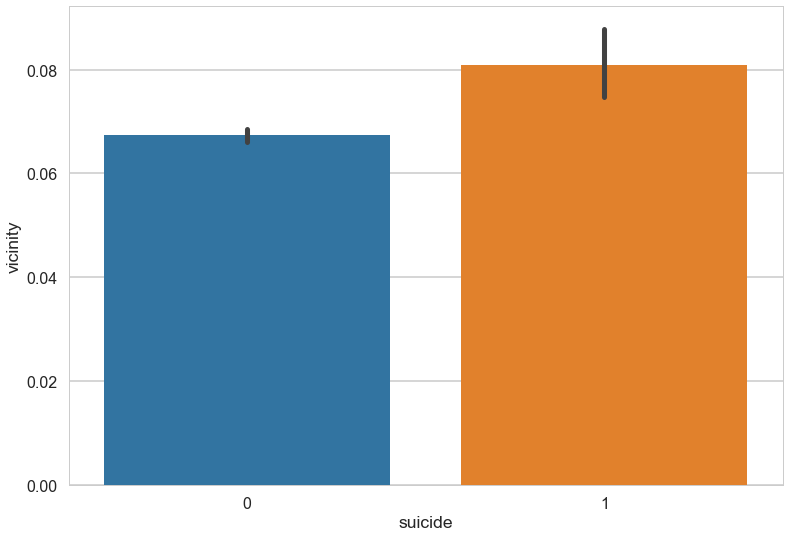

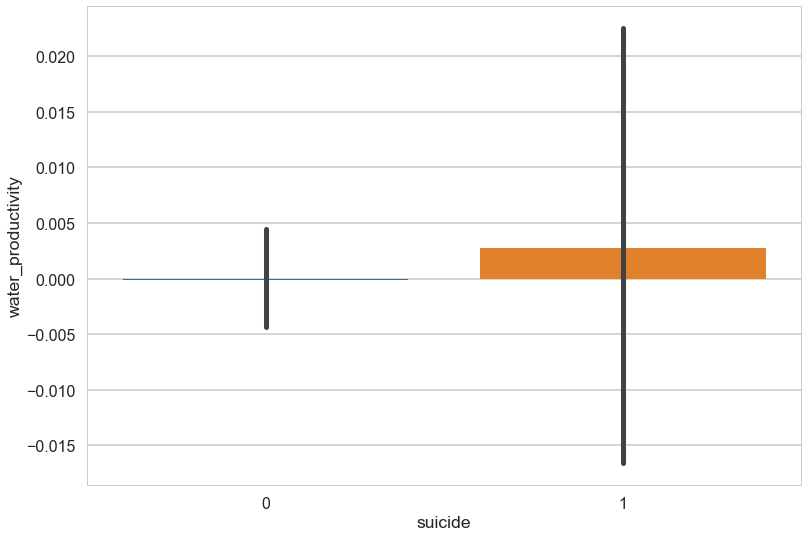

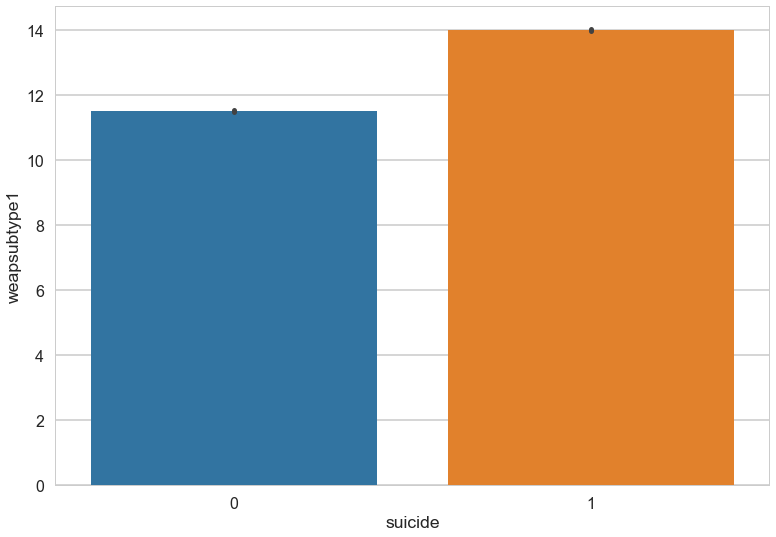

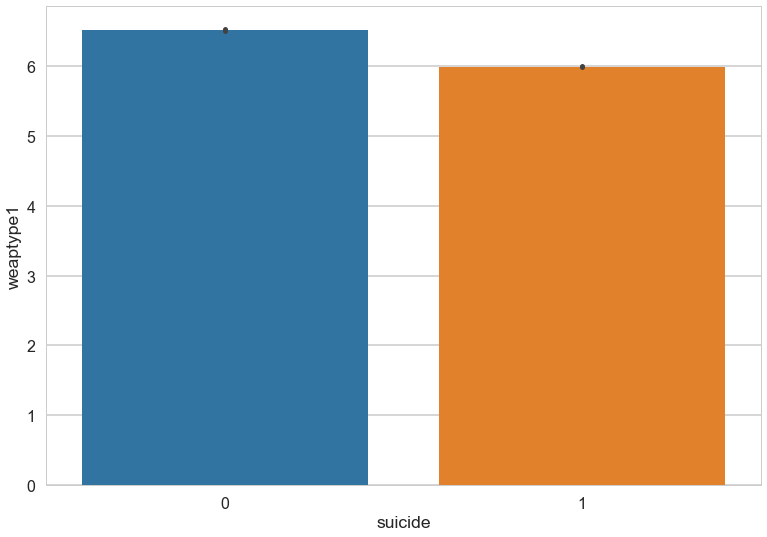

In [101]:
import seaborn as sns
for c in cols_Q3:
    sns.barplot(x='suicide',y=c,data=df_Q3)
    plt.show() 

### 4.3.4 Separate predictor and target variables

In [102]:
results_suicide = df_Q3

In [103]:
X_Q3=df_Q3.drop(['suicide','success','multiple','gname'],axis = 1)
X_Q3.shape

(187483, 71)

In [104]:
y_Q3=df_Q3['suicide']
y_Q3.shape

(187483,)

### 4.3.5 Train and Test split

In [105]:
from sklearn.model_selection import train_test_split
X_Q3_train,X_Q3_test,y_Q3_train,y_Q3_test =train_test_split(X_Q3,y_Q3,test_size=0.20, random_state=42)

In [106]:
#print shape of train 
print(X_Q3_train.shape,y_Q3_train.shape)

(149986, 71) (149986,)


In [107]:
#print shape of test
print(X_Q3_test.shape,y_Q3_test.shape)

(37497, 71) (37497,)


### 4.3.6 Benchmark model

#### 4.3.6a Algorithm 1 - Random Forest Classifier

In [108]:
from sklearn.ensemble import RandomForestClassifier

#create instance of classifier with default parameters
rf_Q3 = RandomForestClassifier()

#fit the model
rf_Q3.fit(X_Q3_train,y_Q3_train)

RandomForestClassifier()

In [109]:
#make predictions on training data
y_pred_train_rf_Q3 = rf_Q3.predict(X_Q3_train)
y_pred_train_rf_Q3

array([0, 0, 0, ..., 0, 1, 0], dtype=int64)

In [110]:
#training accuracy 
from sklearn.metrics import accuracy_score
rf_train_accuracy_Q3 = accuracy_score(y_Q3_train,y_pred_train_rf_Q3)
rf_train_accuracy_Q3

0.9999933327110531

In [111]:
#make predictions on test data
y_pred_test_rf_Q3 = rf_Q3.predict(X_Q3_test)
y_pred_test_rf_Q3

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [112]:
#test accuracy
rf_test_accuracy_Q3 = accuracy_score(y_Q3_test,y_pred_test_rf_Q3)
rf_test_accuracy_Q3

0.99607968637491

#### 4.3.6b Algorithm 2 - Logistic Regression Classifier

In [113]:
lr_Q3 = LogisticRegression()

#fit the model
lr_Q3.fit(X_Q3_train,y_Q3_train)

LogisticRegression()

In [114]:
#make predictions on training data
y_pred_train_lr_Q3 = lr_Q3.predict(X_Q3_train)
y_pred_train_lr_Q3

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [115]:
#training accuracy
lr_train_accuracy_Q3 = accuracy_score(y_Q3_train,y_pred_train_lr_Q3)
lr_train_accuracy_Q3

0.9624764978064619

In [116]:
#make predictions on test data
y_pred_test_lr_Q3 = lr_Q3.predict(X_Q3_test)
y_pred_test_lr_Q3

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [117]:
#test accuracy
lr_test_accuracy_Q3 = accuracy_score(y_Q3_test,y_pred_test_lr_Q3)
lr_test_accuracy_Q3

0.9618102781555857

#### 4.3.6c Algorithm 3 - XgBoost Classifier 

In [118]:
import xgboost 
from xgboost.sklearn import XGBClassifier

xg_Q3=XGBClassifier(max_depth=7,
                        learning_rate=0.05,
                       eta=1,
                        objective='binary:logistic',
                        use_label_encoder=False,
                        eval_metric='error') 

xg_Q3.fit(X_Q3_train, y_Q3_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eta=1, eval_metric='error', gamma=0, gpu_id=-1,
              importance_type=None, interaction_constraints='',
              learning_rate=0.05, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1, predictor='auto',
              random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
              subsample=1, tree_method='exact', use_label_encoder=False,
              validate_parameters=1, ...)

In [119]:
#make predictions on training data
y_pred_train_xg_Q3 = xg_Q3.predict(X_Q3_train)

In [120]:
#training accuracy
xg_train_accuracy_Q3 = accuracy_score(y_Q3_train,y_pred_train_xg_Q3)
xg_train_accuracy_Q3

0.998099822650114

In [121]:
#make predictions on test data
y_pred_test_xg_Q3 = xg_Q3.predict(X_Q3_test)

In [122]:
#test accuracy
xg_test_accuracy_Q3 = accuracy_score(y_Q3_test,y_pred_test_xg_Q3)
xg_test_accuracy_Q3

0.9971464383817372

As random forest is giving us the best accuracy results for this question, we will perform parameter tuning for random forest.

### 4.3.7 Hyper-parameter tuning of random forest algorithm

In [123]:
from sklearn.model_selection import GridSearchCV

n_estimators = [25, 50]
max_depth = [5, 10]
min_samples_split = [2, 5]
min_samples_leaf = [3, 6] 

grid_params_rf_Q3 = dict(n_estimators = n_estimators, 
                  max_depth = max_depth,  
                  min_samples_split = min_samples_split, 
                 min_samples_leaf = min_samples_leaf)

rf_cv_Q3 = GridSearchCV(rf_Q3,
                         grid_params_rf_Q3, 
                         cv = 5,
                         verbose = 1, 
                         n_jobs = -1)

rf_cv_Q3.fit(X_Q3_train, y_Q3_train)         

Fitting 5 folds for each of 16 candidates, totalling 80 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [5, 10], 'min_samples_leaf': [3, 6],
                         'min_samples_split': [2, 5],
                         'n_estimators': [25, 50]},
             verbose=1)

In [124]:
rf_cv_Q3.best_params_

{'max_depth': 10,
 'min_samples_leaf': 3,
 'min_samples_split': 5,
 'n_estimators': 50}

In [125]:
rf_cv_Q3.best_score_

0.9952462252914627

In [126]:
rf_cv_Q3.best_estimator_

RandomForestClassifier(max_depth=10, min_samples_leaf=3, min_samples_split=5,
                       n_estimators=50)

### 4.3.8 Rebuild the optimized model

In [127]:
rf_best_Q3 = RandomForestClassifier(n_estimators=50, 
                                    max_depth=10,
                                    max_features='auto', 
                                    min_samples_leaf=3,
                                    min_samples_split=5,
                                    bootstrap=True, 
                                    n_jobs=-1, 
                                    random_state=0)

In [128]:
rf_best_Q3.fit(X_Q3_train, y_Q3_train)

RandomForestClassifier(max_depth=10, min_samples_leaf=3, min_samples_split=5,
                       n_estimators=50, n_jobs=-1, random_state=0)

In [129]:
y_pred_best_Q3 = rf_best_Q3.predict(X_Q3_test)
y_pred_best_Q3

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [130]:
accuracy_score(y_Q3_test,y_pred_best_Q3)

0.9945595647651813

### 4.3.9 Feature Importance 

Text(88.675, 0.5, 'FEATURE NAMES')

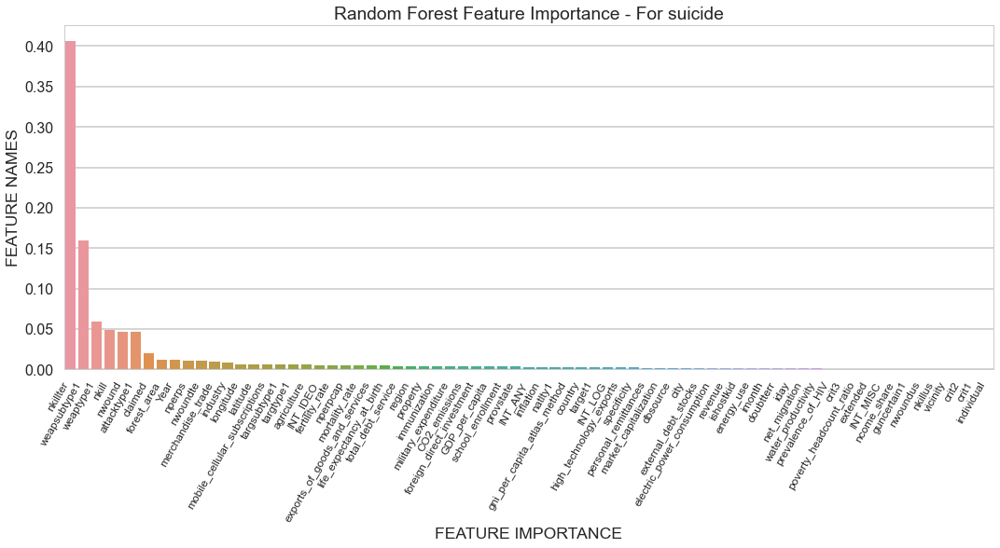

In [131]:
feature_importance_Q3 = np.array(rf_best_Q3.feature_importances_)
feature_names_Q3 = np.array(X_Q3_train.columns)

#create a DataFrame using a Dictionary
data_Q3={'feature_names':feature_names_Q3,'feature_importance':feature_importance_Q3}
fi_df_Q3 = pd.DataFrame(data_Q3)

#sort the DataFrame in order decreasing feature importance
fi_df_Q3.sort_values(by=['feature_importance'], ascending=False,inplace=True)

#define size of bar plot
plt.figure(figsize=(15,8))

#Plot Searborn bar chart
#sns.barplot(x=fi_df_Q3['feature_importance'], y=fi_df_Q3['feature_names'])
ax = sns.barplot(x=fi_df_Q3['feature_names'], y=fi_df_Q3['feature_importance'])

#add chart labels
ax.set_xticklabels(ax.get_xticklabels(), fontsize=12,rotation=60, ha="right")  #it will rotate text on x axis

plt.tight_layout()

#add chart labels
plt.title('Random Forest Feature Importance - For suicide')
plt.xlabel('FEATURE IMPORTANCE')
plt.ylabel('FEATURE NAMES')

### 4.3.10 Confusion Matrix

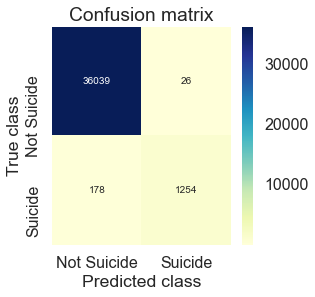

In [132]:
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve
LABELS = ['Not Suicide', 'Suicide']
cm_Q3 = confusion_matrix(y_Q3_test, y_pred_best_Q3)
plt.figure(figsize=(4, 4))
sns.heatmap(cm_Q3, annot=True, fmt='d', cmap='YlGnBu',xticklabels=LABELS, yticklabels=LABELS)
plt.title("Confusion matrix")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

### 4.3.11 ROC-AUC curve

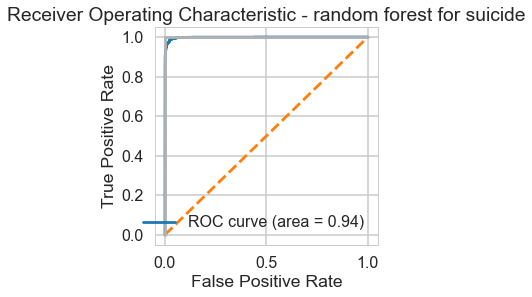

In [133]:
auc_score = metrics.roc_auc_score( y_Q3_test, y_pred_best_Q3)
round( float( auc_score ), 2 )
score = rf_best_Q3.predict_proba(X_Q3_test)[:,1]
false_positive_rate, true_positive_rate, thresholds = roc_curve(y_Q3_test, score)
plt.subplots(1, figsize=(4,4))
plt.title('Receiver Operating Characteristic - random forest for suicide')
plt.plot(false_positive_rate, true_positive_rate, label='ROC curve (area = %0.2f)' % auc_score)
plt.plot([0, 1], ls="--")
plt.plot([0, 0], [1, 0] , c=".7"), plt.plot([1, 1] , c=".7")
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc="lower right")
plt.show()

### 4.3.12 F1-score

In [134]:
f1_positive_Q3 = metrics.f1_score(y_Q3_test, y_pred_best_Q3, pos_label=1)
f1_negative_Q3 = metrics.f1_score(y_Q3_test, y_pred_best_Q3, pos_label=0)
f1_positive_Q3, f1_negative_Q3

(0.924778761061947, 0.9971777205943388)

### 4.3.13 Precision

In [135]:
precision_positive_Q3 = metrics.precision_score(y_Q3_test, y_pred_best_Q3, pos_label=1)
precision_negative_Q3 = metrics.precision_score(y_Q3_test,y_pred_best_Q3, pos_label=0)
precision_positive_Q3, precision_negative_Q3

(0.9796875, 0.9950851809923517)

### 4.2.14 Recall

In [136]:
recall_sensitivity_Q3 = metrics.recall_score(y_Q3_test, y_pred_best_Q3, pos_label=1)
recall_specificity_Q3 = metrics.recall_score(y_Q3_test, y_pred_best_Q3, pos_label=0)
recall_sensitivity_Q3, recall_specificity_Q3

(0.8756983240223464, 0.9992790794399001)

### 4.3.15 Run predictions for the entire file

In [137]:
y_pred_Q3 = rf_best_Q3.predict(X_Q3)
y_pred_Q3

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

### 4.3.16 Save predicton results into CSV

In [138]:
results_suicide.head(5)

,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,1535,30750,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,1,14,68.0,40210,58.0,1844,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,13,0,0,0,0,0.814048,-0.607415,-0.291830,-0.301651,-0.496695,-0.740213,1.775850,0.054430,-0.177076,-0.588545,-0.594663,-0.168274,0.166033,0.001653,-0.418445,-0.099285,-1.349957,-0.090272,-0.339961,-0.240698,-1.098485,1.651777,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.005344,-0.118053
1,1970,0,0,0,130,1,694,22943,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,6,7,45.0,48380,21.0,13,0.0,0,0.00028,0.0,0.0,13,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,0,1.0,13,0,1,1,1,-0.419222,-0.151783,-0.291830,-0.301651,-1.250465,-0.596586,2.091516,0.027346,-0.177076,-0.522339,-0.530390,-0.168274,0.166033,0.001653,0.033752,-0.096621,-0.850544,-0.090272,-1.557121,-1.126850,-1.098485,1.233917,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.171547,-0.118053
2,1970,1,0,0,160,5,2209,35664,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,1,10,54.0,27229,217.0,3304,0.0,0,0.00004,0.0,0.0,13,16.0,0.000637,0.0,0.0,0.0,0.0,0.0,0,0.0,13,-9,-9,1,1,1.160255,-0.607090,-0.291830,-0.301651,-0.210738,-0.701532,1.836187,0.027346,-0.177076,-0.610450,-0.611676,-0.168274,0.166033,0.001653,0.434337,-0.075570,-0.576623,-0.090272,-0.668106,-0.360714,-1.098485,0.666118,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,0.279134,-0.118053
3,1970,1,0,0,78,8,157,2796,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,3,7,46.0,74930,217.0,3304,0.0,0,0.00004,0.0,0.0,6,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,0.007819,0.007559,-0.163412,-0.204608,-1.240981,-0.267207,-1.007016,0.027346,-0.177076,-0.374232,-0.320557,-0.168274,0.166033,0.001653,-0.257331,-0.101474,0.607154,-0.090272,-1.145142,0.581426,-1.098485,-0.629250,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053
4,1970,1,0,0,101,4,717,11663,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,7,46.0,74910,217.0,3304,0.0,0,0.00004,0.0,0.0,8,16.0,0.000000,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,0.007819,1.408600,1.169523,1.224971,-1.057883,-0.267207,-1.202008,0.027346,-0.177076,-0.270830,-0.303544,-0.168274,0.166033,0.001653,-0.257331,-0.092669,0.767047,-0.090272,-1.229576,-0.999502,-1.098485,-0.958623,-0.020641,-0.274099,-0.112349,-0.217214,-0.161,0.378175,-0.218345,-0.118053


In [139]:
results_suicide['suicide_predicted_value'] = y_pred_Q3
results_suicide['suicide_predicted_value'].value_counts()

0    180975
1      6508
Name: suicide_predicted_value, dtype: int64

In [140]:
results_suicide.to_csv("results_suicide.csv", index=False)

## 4.4 Regression Problem Q4 - No of lives lost
    


### 4.4.1 Preparation of Dataset

In [255]:
#import pandas as pd
data = pd.read_csv('data_clean_unscaled.csv', encoding='ISO-8859-1',)
#data = data_clean_unscaled.copy()

In [256]:
df_Q4 = data.copy()

In [257]:
df_Q4=data[['Year','imonth','iday','extended','country','region','provstate','city','latitude','longitude','specificity',
           'vicinity','crit1','crit2','crit3','doubtterr','multiple','success','suicide','attacktype1','targtype1',
           'target1','natlty1','gname','guncertain1','individual','nperps','nperpcap','claimed','weaptype1','weapsubtype1',
           'nkill','nkillus','nkillter','nwound','nwoundus','nwoundte','property','ishostkid','dbsource','INT_LOG','INT_IDEO',
           'INT_MISC','INT_ANY', 'agriculture', 'CO2_emissions', 'electric_power_consumption',
       'energy_use', 'exports_of_goods_and_services', 'external_debt_stocks',
       'fertility_rate', 'foreign_direct_investment', 'forest_area',
       'GDP_per_capita', 'gni_per_capita_atlas_method',
       'high_technology_exports', 'immunization', 'ncome_share', 'industry',
       'inflation', 'life_expectancy_at_birth', 'market_capitalization',
       'merchandise_trade', 'military_expenditure',
       'mobile_cellular_subscriptions', 'mortality_rate', 'net_migration',
       'personal_remittances', 'poverty_headcount_ratio', 'prevalence_of_HIV',
       'revenue', 'school_enrollment', 'total_debt_service',
       'water_productivity']]
df_dropna=df_Q4.dropna()

### 4.4.2 Visulaztion of Correlation by Heatmap

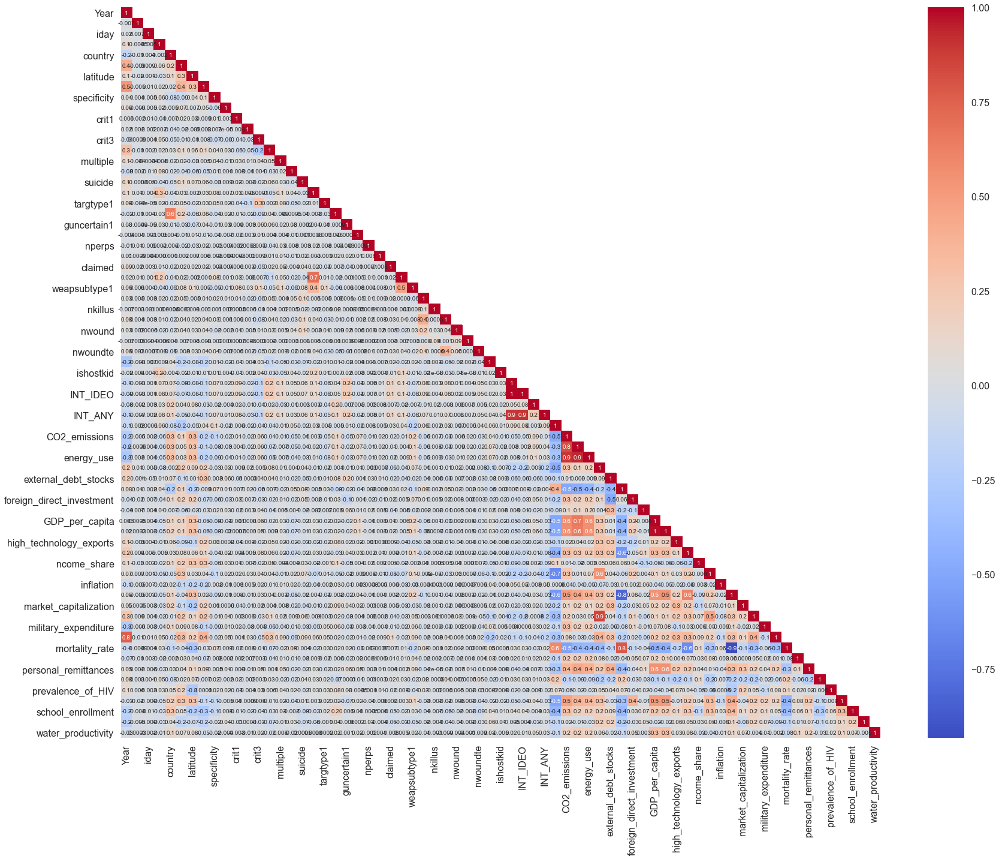

In [258]:
import matplotlib.pyplot as mp
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
corr_X_df= df_dropna.corr(method='pearson') 
corr_X_df.head()
plt.figure(figsize=(25,20))
X_df_lt = corr_X_df.where(np.tril(np.ones(corr_X_df.shape)).astype(np.bool))
sns.heatmap(X_df_lt,cmap="coolwarm",annot=True,fmt='.1g')
plt.tight_layout()
plt.savefig("Heatmap_Canonical_Correlates_from_X_and_data.jpg",
                    format='jpeg',
                    dpi=100)

### 4.4.3 Encoding Category Variables and Defining and Normalizing the X and Y data 

In [259]:
from sklearn.preprocessing import LabelEncoder
from xgboost import XGBRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor


labelencoder = LabelEncoder()
df_dropna['provstate']=labelencoder.fit_transform(df_dropna['provstate']) 
df_dropna['city']=labelencoder.fit_transform(df_dropna['city']) 
df_dropna['target1']=labelencoder.fit_transform(df_dropna['target1'])

df_dropna['dbsource']=labelencoder.fit_transform(df_dropna['dbsource']) 
df_dropna['gname']=labelencoder.fit_transform(df_dropna['gname'])

In [260]:
X=df_dropna.drop(['nkill'],axis = 1)
y = df_dropna['nkill']

In [261]:
import xgboost
from sklearn.preprocessing import LabelEncoder
from xgboost import XGBRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor

model = xgboost.XGBRegressor(colsample_bytree=0.4,
                 gamma=0,                 
                 learning_rate=0.07,
                 max_depth=3,
                 min_child_weight=1.5,
                 n_estimators=10000,                                                                    
                 reg_alpha=0.75,
                 reg_lambda=0.45,
                 subsample=0.6,
                 seed=42) 

In [262]:
X_norm = (X-X.min())/ (X.max() - X.min())

In [263]:
cols_Q4 = X_norm.columns

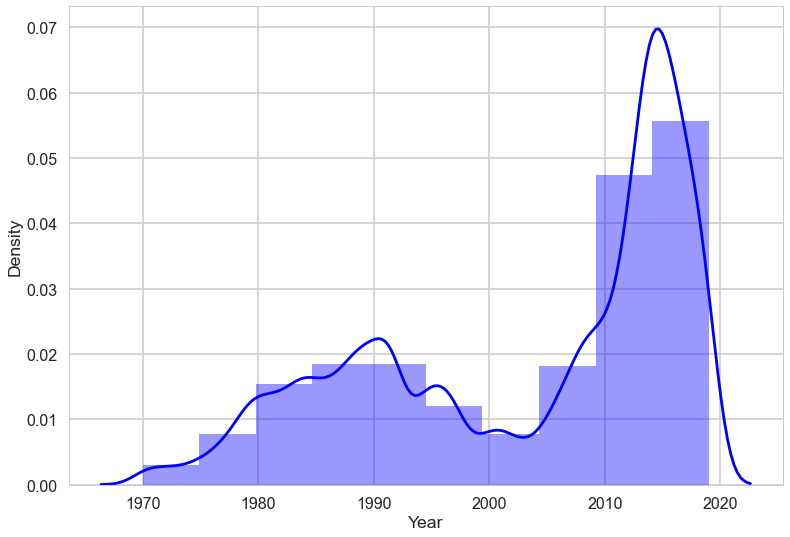

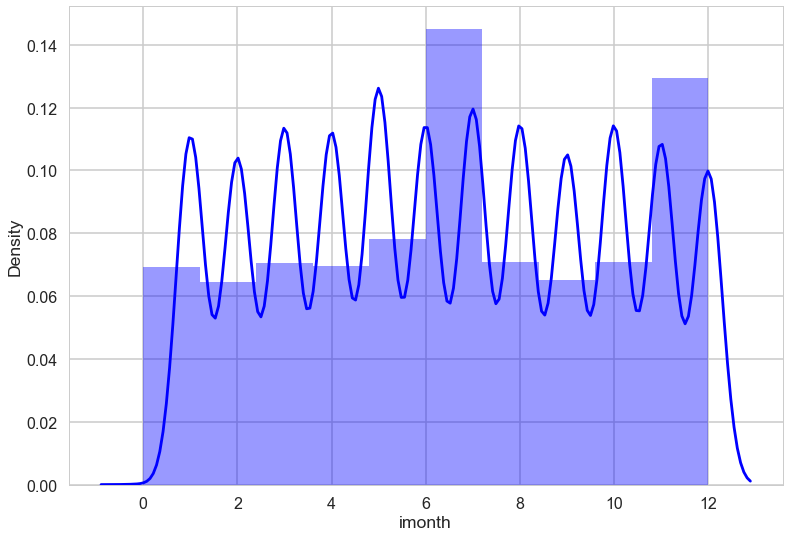

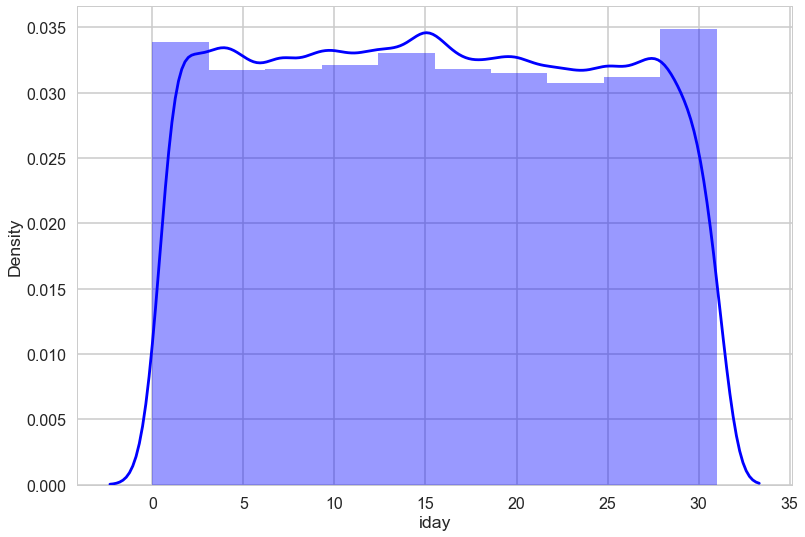

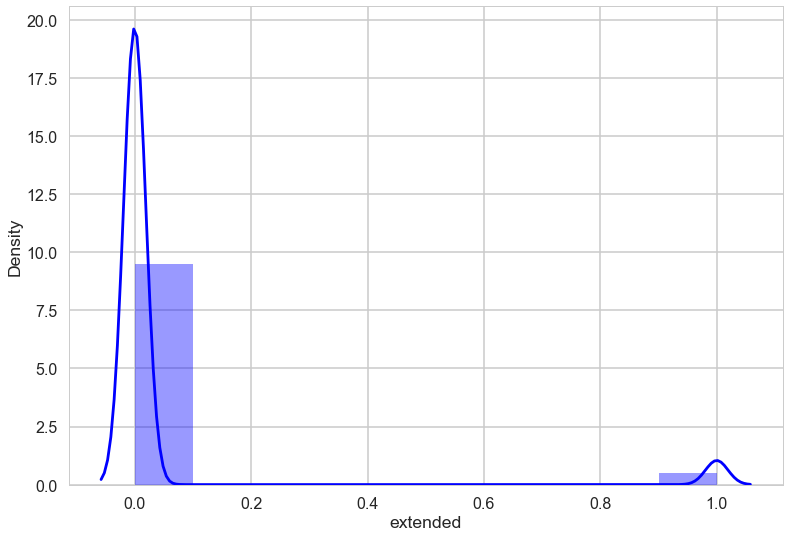

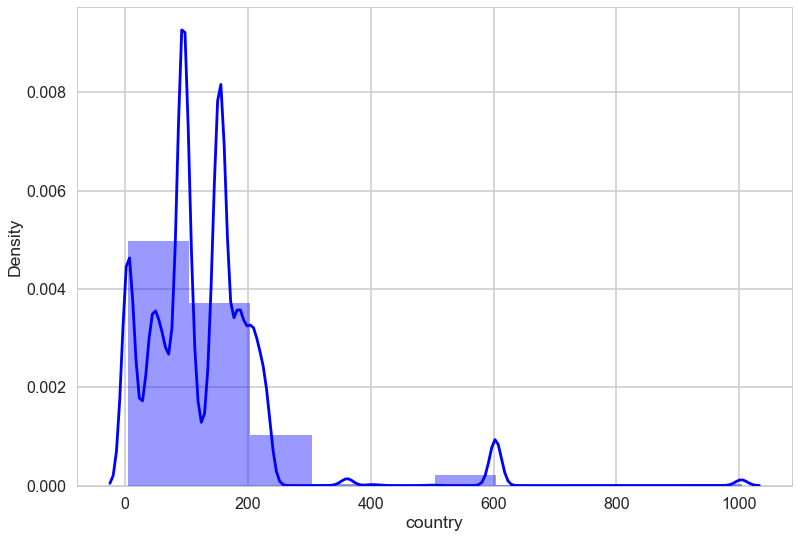

...

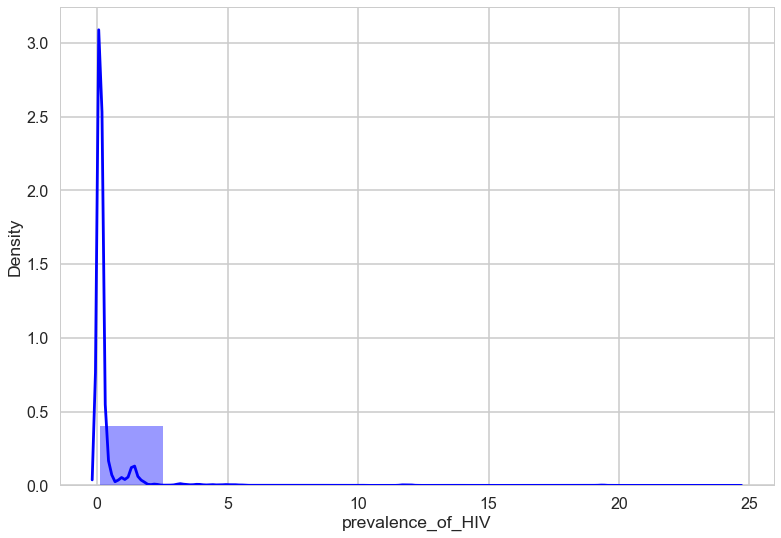

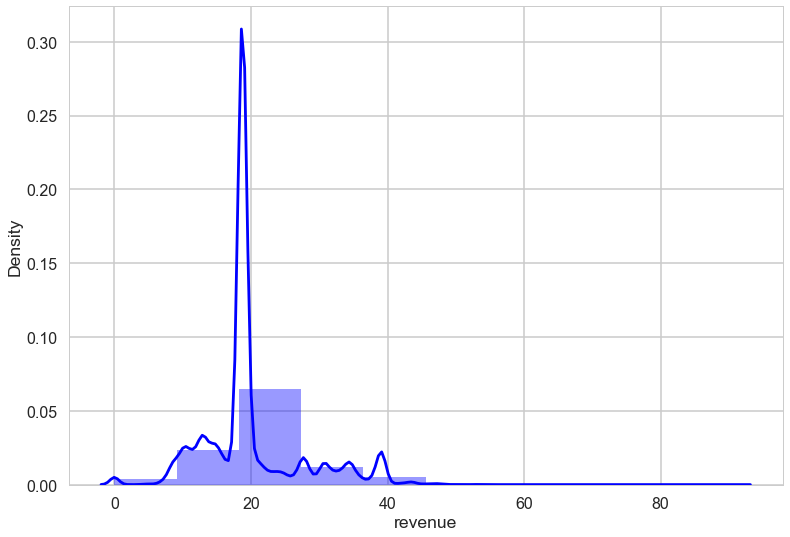

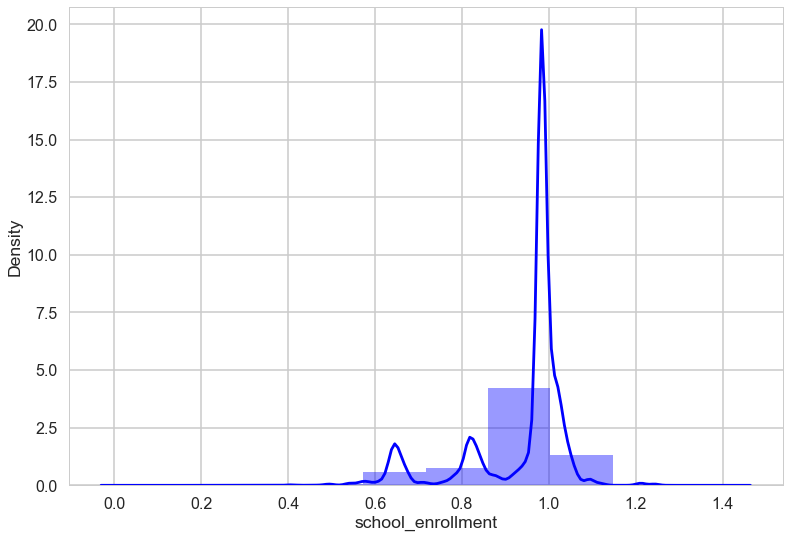

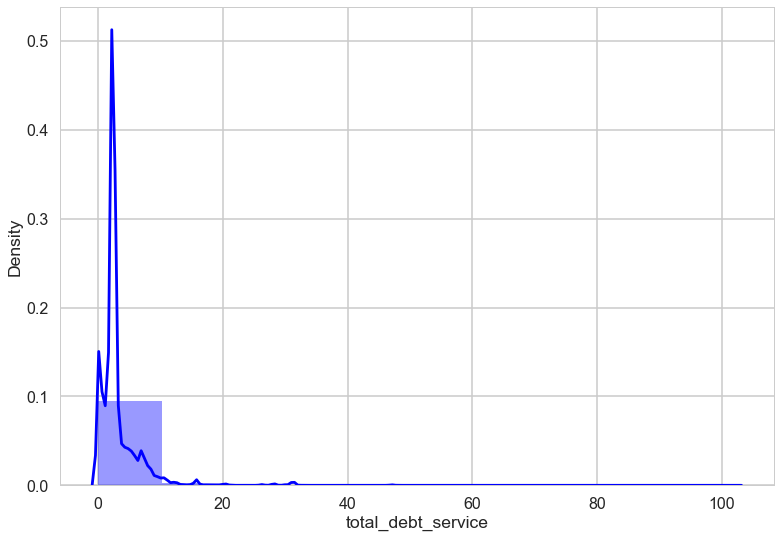

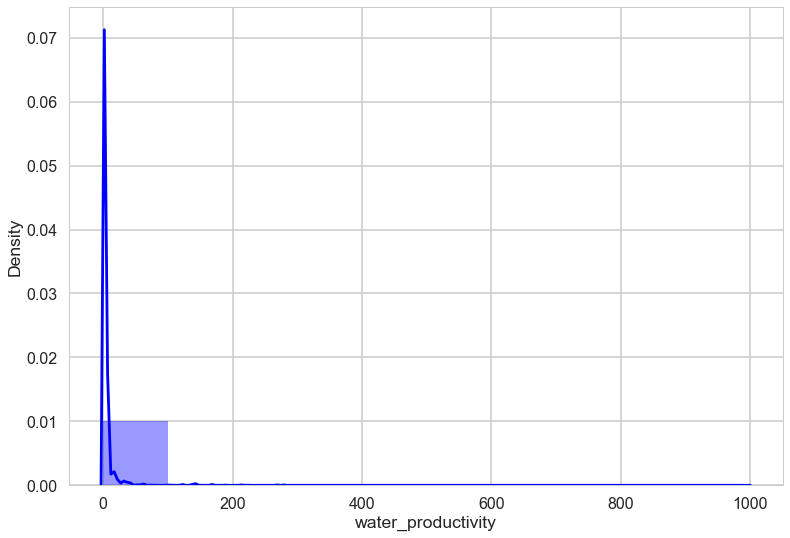

In [264]:
# distribution plot for each predictor 
for c in cols_Q4:
    sns.distplot(df_dropna[c], kde=True, color='blue',bins=10)
    plt.show()

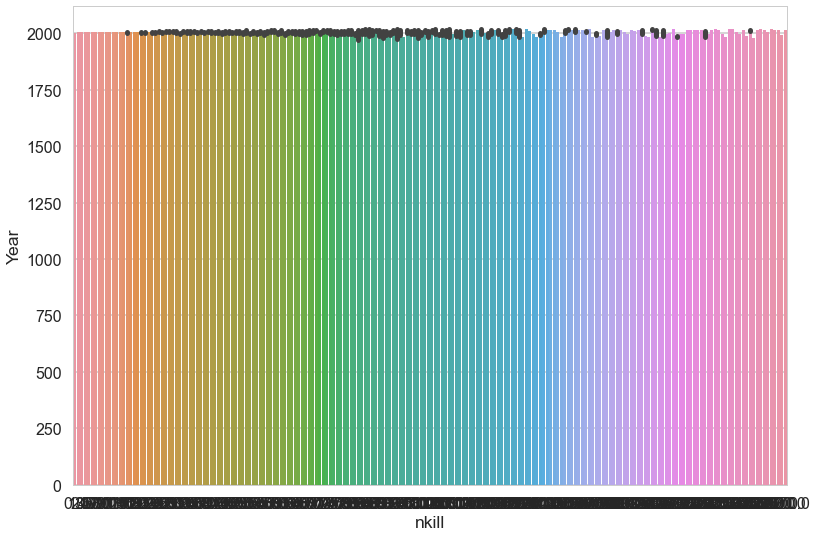

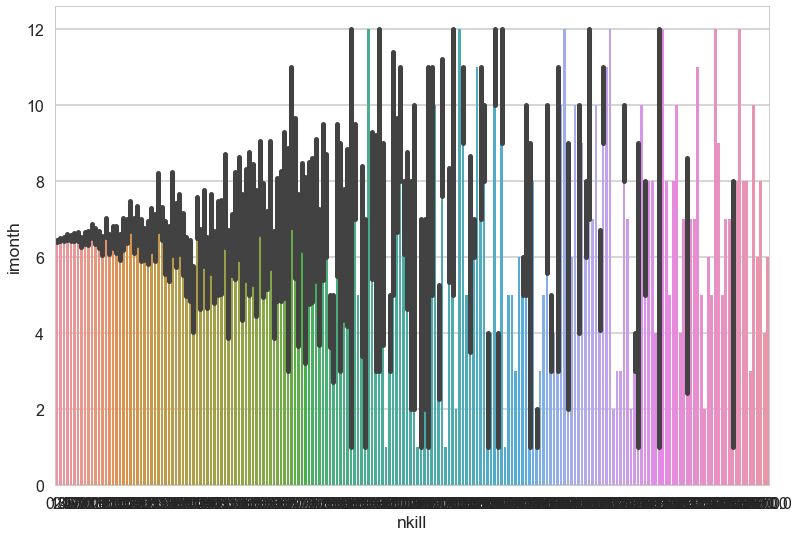

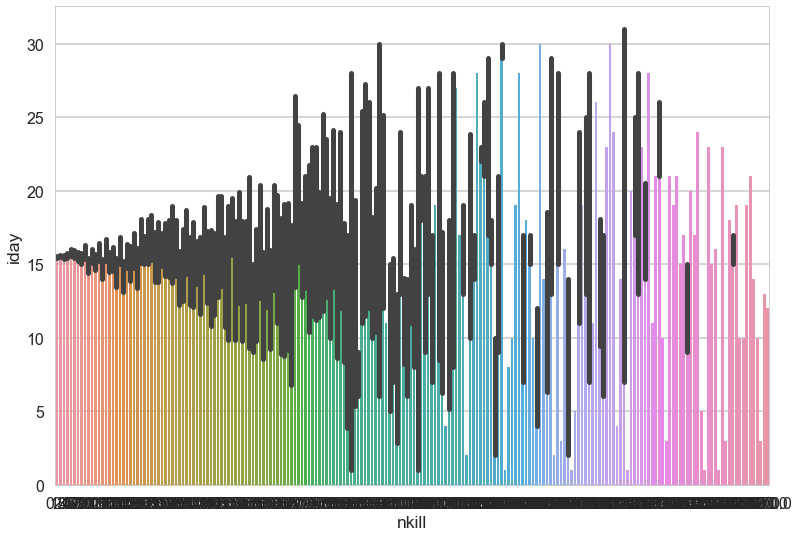

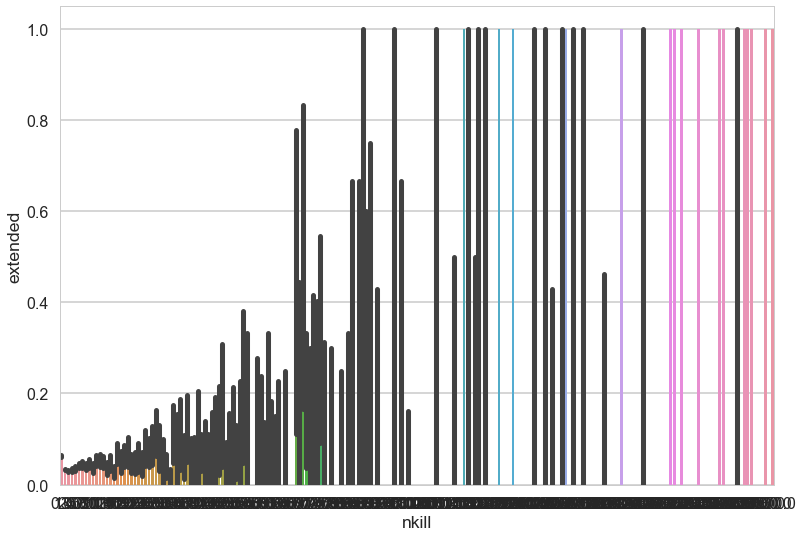

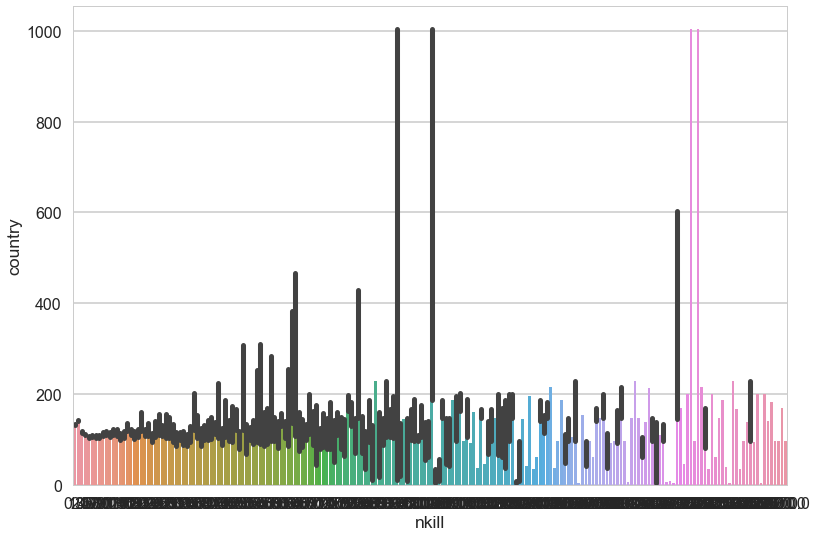

...

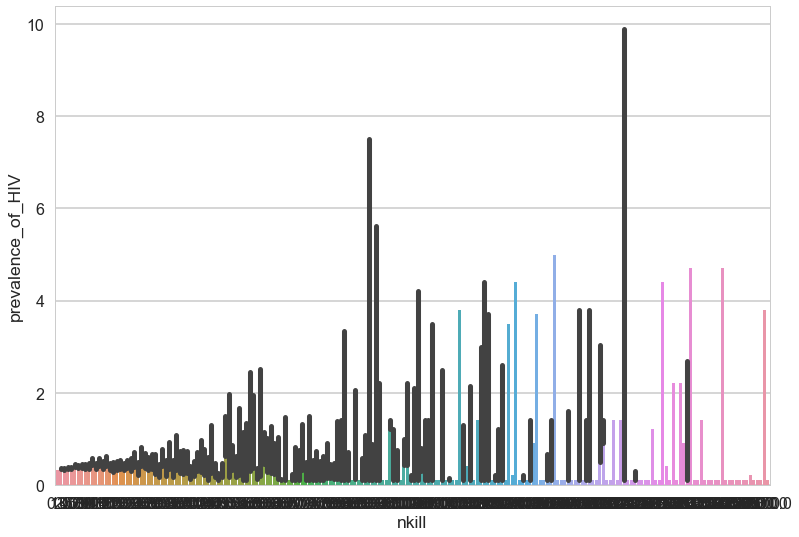

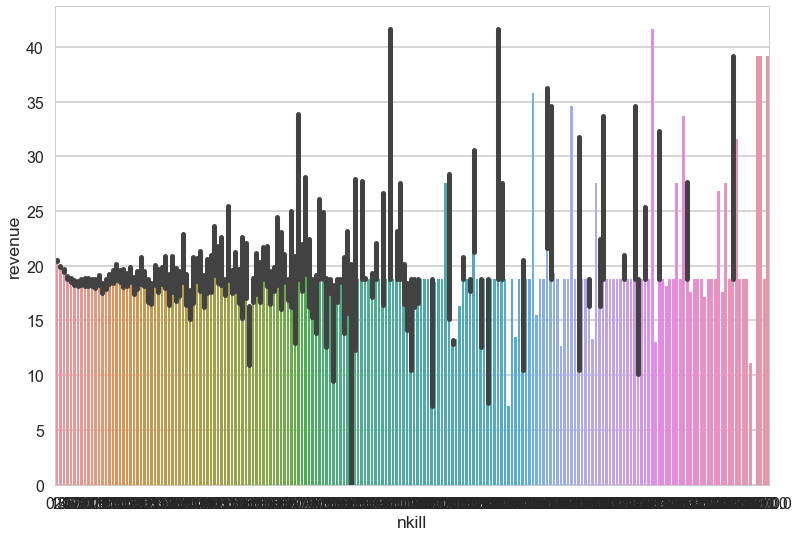

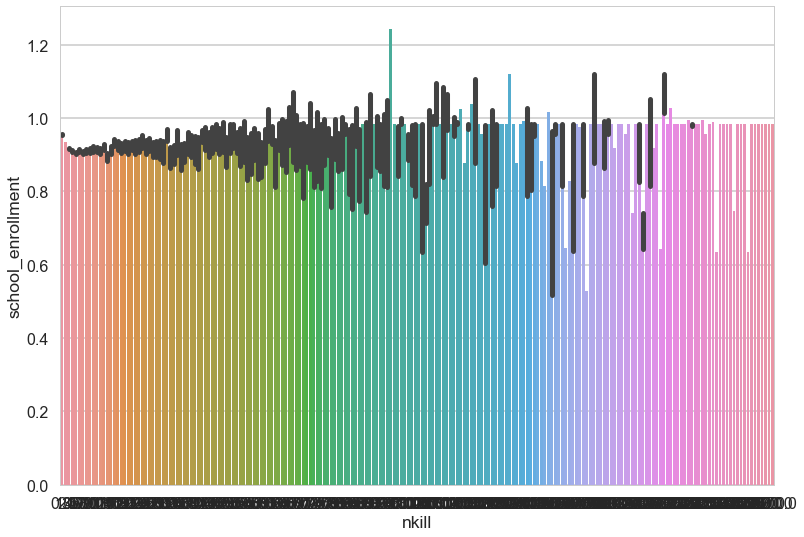

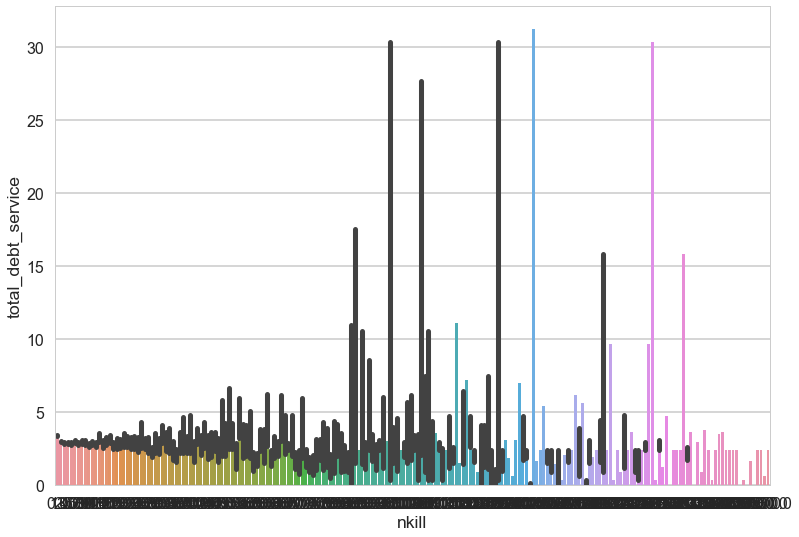

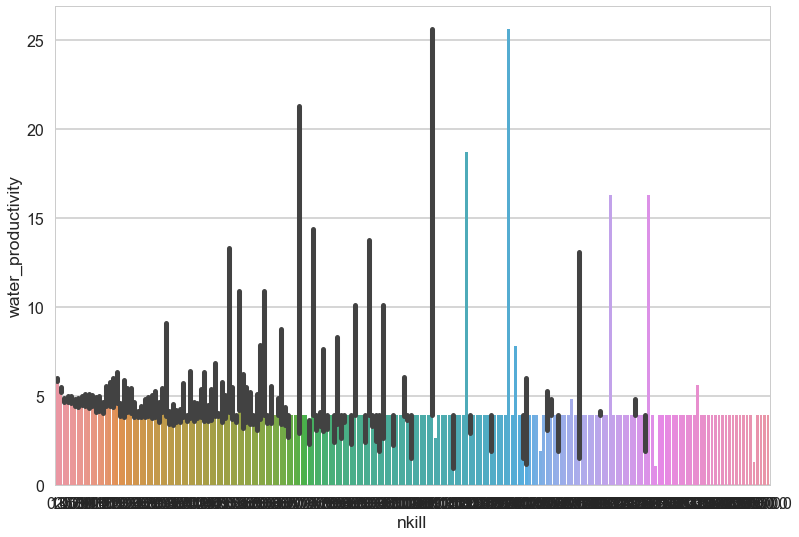

In [265]:
import seaborn as sns
for c in cols_Q4:
    sns.barplot(x='nkill',y=c,data=df_dropna)
    plt.show() 

### 4.4.4 Visualzation of Feature Importance and Selecting important features.

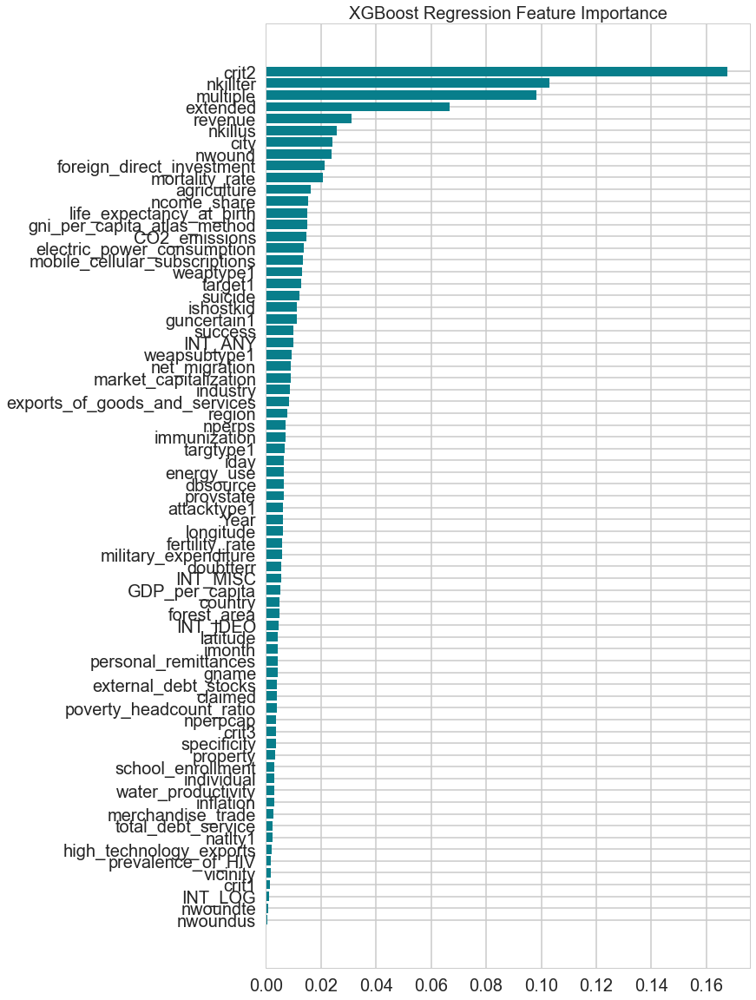

In [266]:
xgb = XGBRegressor()
xgb.fit(X_norm,y)

xgb_importances=pd.DataFrame(data={'Attribute':X_norm.columns,'Importance':xgb.feature_importances_})
xgb_importances=xgb_importances.sort_values(by='Importance')

plt.figure(figsize=(10,20))
plt.barh(width=xgb_importances['Importance'], y=xgb_importances['Attribute'], color='#087E8B')
plt.title('XGBoost Regression Feature Importance',size=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

In [267]:
xgb_importances['Attribute'].unique()


array(['nwoundus', 'nwoundte', 'INT_LOG', 'crit1', 'vicinity',
       'prevalence_of_HIV', 'high_technology_exports', 'natlty1',
       'total_debt_service', 'merchandise_trade', 'inflation',
       'water_productivity', 'individual', 'school_enrollment',
       'property', 'specificity', 'crit3', 'nperpcap',
       'poverty_headcount_ratio', 'claimed', 'external_debt_stocks',
       'gname', 'personal_remittances', 'imonth', 'latitude', 'INT_IDEO',
       'forest_area', 'country', 'GDP_per_capita', 'INT_MISC',
       'doubtterr', 'military_expenditure', 'fertility_rate', 'longitude',
       'Year', 'attacktype1', 'provstate', 'dbsource', 'energy_use',
       'iday', 'targtype1', 'immunization', 'nperps', 'region',
       'exports_of_goods_and_services', 'industry',
       'market_capitalization', 'net_migration', 'weapsubtype1',
       'INT_ANY', 'success', 'guncertain1', 'ishostkid', 'suicide',
       'target1', 'weaptype1', 'mobile_cellular_subscriptions',
       'electric_power_con

In [268]:
X_norm1 = X_norm[['success', 'guncertain1', 'ishostkid', 'suicide',
       'target1', 'weaptype1', 'mobile_cellular_subscriptions',
       'electric_power_consumption', 'CO2_emissions',
       'gni_per_capita_atlas_method', 'life_expectancy_at_birth',
       'ncome_share', 'agriculture', 'mortality_rate',
       'foreign_direct_investment', 'nwound', 'city', 'nkillus',
       'revenue', 'extended', 'multiple', 'nkillter', 'crit2']]

### 4.4.5 Spliting X and Y into traning and testing data

In [269]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(X_norm1, y, test_size=0.33, shuffle=False)

### 4.4.6 Model Creating and Evaluation

In [270]:
from sklearn.linear_model import LinearRegression
model1 = LinearRegression().fit(x_train, y_train)
model1.score(x_train, y_train)

0.18307432254259814

In [271]:
lambda_values = [1, 10, 50, 100]
for val in lambda_values:
    model = xgboost.XGBRegressor(max_depth=3, n_estimators=100, n_jobs=2,
                           objectvie='reg:squarederror', booster='gbtree',
                           random_state=42, learning_rate=0.05, reg_lambda=val)

In [272]:
model.fit(x_train,y_train)

[13:51:14] WARNING: ..\src\learner.cc:576: 
Parameters: { "objectvie" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=2,
             num_parallel_tree=1, objectvie='reg:squarederror',
             predictor='auto', random_state=42, reg_alpha=0, reg_lambda=100,
             scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [273]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error as mse

y_pred = model.predict(x_test)
y_true = y_test

MSE = mse(y_pred, y_true)
RMSE = np.sqrt(MSE)

R_squared = r2_score(y_true, y_pred)

In [274]:
print("lambda = ", val)
print("RMSE: ", np.round(RMSE, 2))
print("R-Squared: ", np.round(R_squared, 2))
print()

lambda =  100
RMSE:  11.38
R-Squared:  0.2



In [275]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_true, y_pred)

129.50318722462848

In [276]:
MSE

129.50318722462848

In [277]:
model.score(x_train, y_train)

0.22986285878063306

## 4.5 Regression Problem Q5 - No of people wounded
    


### 4.5.1 Defining X and Y dataset

In [169]:
X=df_dropna.drop(['nwound'],axis = 1)
y = df_dropna['nwound']

In [170]:
model = xgboost.XGBRegressor(colsample_bytree=0.4,
                 gamma=0,                 
                 learning_rate=0.07,
                 max_depth=3,
                 min_child_weight=1.5,
                 n_estimators=10000,                                                                    
                 reg_alpha=0.75,
                 reg_lambda=0.45,
                 subsample=0.6,
                 seed=42) 

### 4.5.2 Normalization dataset

In [171]:
X_norm = (X-X.min())/ (X.max() - X.min())

### 4.5.3 Feature Importance Selection

In [173]:
xgb_importances['Attribute'].unique()

array(['crit1', 'INT_MISC', 'INT_IDEO', 'INT_ANY', 'crit2', 'vicinity',
       'country', 'ishostkid', 'claimed', 'guncertain1', 'forest_area',
       'latitude', 'success', 'INT_LOG', 'property', 'nperps',
       'mobile_cellular_subscriptions', 'ncome_share',
       'market_capitalization', 'nperpcap', 'CO2_emissions', 'doubtterr',
       'mortality_rate', 'fertility_rate', 'attacktype1', 'target1',
       'total_debt_service', 'energy_use', 'poverty_headcount_ratio',
       'nwoundte', 'water_productivity', 'multiple', 'natlty1',
       'school_enrollment', 'high_technology_exports', 'crit3', 'imonth',
       'merchandise_trade', 'city', 'specificity', 'targtype1',
       'life_expectancy_at_birth', 'electric_power_consumption',
       'revenue', 'agriculture', 'military_expenditure', 'nkillus',
       'extended', 'personal_remittances', 'inflation',
       'external_debt_stocks', 'provstate', 'nkillter', 'weapsubtype1',
       'industry', 'gni_per_capita_atlas_method',
       'fore

In [174]:
X_norm1 = X_norm[['nkill', 'immunization', 'dbsource', 'individual', 'suicide',
       'exports_of_goods_and_services', 'region', 'Year', 'nwoundus',
       'gname', 'longitude', 'GDP_per_capita', 'prevalence_of_HIV']]

### 4.5.4 Spliting data and Creating models, Evaluation

In [175]:
x_train, x_test, y_train, y_test = train_test_split(X_norm1, y, test_size=0.33, shuffle=False)

In [176]:
from sklearn.linear_model import LinearRegression
model1 = LinearRegression().fit(x_train, y_train)
model1.score(x_train, y_train)

0.08083375822479744

In [177]:
lambda_values = [1, 10, 50, 100]
for val in lambda_values:
    model = xgboost.XGBRegressor(max_depth=3, n_estimators=100, n_jobs=2,
                           objectvie='reg:squarederror', booster='gbtree',
                           random_state=42, learning_rate=0.05, reg_lambda=val)

In [178]:
model.fit(x_train,y_train)

[17:54:24] WARNING: ..\src\learner.cc:576: 
Parameters: { "objectvie" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.




XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=2,
             num_parallel_tree=1, objectvie='reg:squarederror',
             predictor='auto', random_state=42, reg_alpha=0, reg_lambda=100,
             scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [179]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error as mse

y_pred = model.predict(x_test)
y_true = y_test

MSE = mse(y_pred, y_true)
RMSE = np.sqrt(MSE)

R_squared = r2_score(y_true, y_pred)

In [180]:
print("lambda = ", val)
print("RMSE: ", np.round(RMSE, 2))
print("R-Squared: ", np.round(R_squared, 2))
print()

lambda =  100
RMSE:  11.29
R-Squared:  -0.01



In [181]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_true, y_pred)

127.55806841268566

In [182]:
MSE

127.55806841268566

In [183]:
model.score(x_train, y_train)

0.17773327865831945

## --- No of causalities occured in an attack---

#### Import the dataset

In [296]:
data = data_terrorism.copy()
#data=pd.read_csv('globalterrorismdb_0221dist.xlsx',encoding = "ISO-8859-1")  #modified code
#data=pd.read_csv('globalterrorismdb_0718dist.csv',encoding = "ISO-8859-1")

#### Drop the columns that more than 50% of the data are null

In [297]:
def RemoveColumns(data):
    redundant_columns=[col for col in data.columns if '_txt' in col]
    data=data.drop(redundant_columns,axis=1)
    columns = data.columns
    percent_missing = data.isnull().sum() * 100 / len(data)
    unique = data.nunique()
    dtypes = data.dtypes
    missing_value_data = pd.DataFrame({'column_name': columns,
                                 'percent_missing': percent_missing,
                                 'unique': unique,
                                 'types': dtypes})

    missing_value_data = missing_value_data[missing_value_data['percent_missing']>0]
    missing_drop = list(missing_value_data[missing_value_data.percent_missing>50].column_name)
    data = data.drop(missing_drop, axis=1)
    return data

In [298]:
data = RemoveColumns(data=data)

#### Feature engineer

In [299]:
data = data[(data.crit1 == 1) & (data.crit2 == 1) & (data.crit3 == 1) & (data.doubtterr == 0)]
data.iloc[:,[12, 36,39,42]] = data.iloc[:,[12, 36,39,42]].replace(-9,0)
data.claimed.replace(2,1, inplace = True)
data['ncasualties'] = data['nkill'] + data['nwound']
data=data.drop(['scite1','corp1','target1','summary','weapdetail', 'nkill', 'nwound','eventid'],axis=1)

In [300]:
data0=data.dropna(how='any')

In [301]:
fq_provstate=data0.groupby('provstate').size()/len(data0)
data0.loc[:,"{}_freq_encode".format('provstate')]=data0['provstate'].map(fq_provstate)

fq_city=data0.groupby('city').size()/len(data0)
data0.loc[:,"{}_freq_encode".format('city')]=data0['city'].map(fq_city)

fq_gname=data0.groupby('gname').size()/len(data0)
data0.loc[:,"{}_freq_encode".format('gname')]=data0['gname'].map(fq_gname)

In [302]:
from sklearn.preprocessing import OneHotEncoder   #vishal addition
enc=OneHotEncoder(handle_unknown='ignore')
enc_df=pd.DataFrame(enc.fit_transform(data0[['dbsource']]).toarray())

In [303]:
enc_df1=enc_df.reset_index().drop(['index'],axis=1)
data1=data0.reset_index().drop(['index'],axis=1)

In [304]:
for i in enc_df1.columns:
    column=enc_df1.columns[i]
    data1[column]=enc_df1[column]

In [305]:
data2=data1.drop(['dbsource','gname','city','provstate'],axis=1)

In [318]:
X=data2.drop(['ncasualties'],axis=1)
X = X.drop(['Country Name'],axis=1) #added byvishal
y=data2['ncasualties']

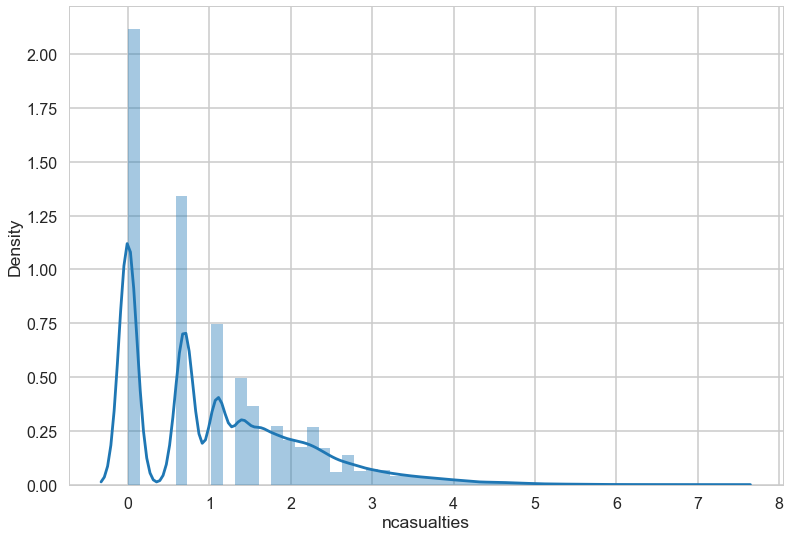

In [319]:
y1=np.log(y+1)
ax = sns.distplot(y1)

In [320]:
Q1 = y1.quantile(0.25)
Q3 = y1.quantile(0.75)
IQR = Q3 - Q1
print([Q1, Q3])
filter=(y1>=Q1-1.5*IQR)  & (y1<=Q3+1.5*IQR)
y2=y1[filter]
X2=X[filter]

[0.0, 1.791759469228055]


In [321]:
#X2.drop(['Country Name'], axis=1) #added byvishal
#y2.head()
X2.head()

,Year,imonth,iday,extended,country,region,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,targtype1,targsubtype1,natlty1,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkillus,nkillter,nwoundus,nwoundte,property,ishostkid,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,provstate_freq_encode,city_freq_encode,gname_freq_encode,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,1970,1,1,0,217,1,37.005105,-89.176269,1.0,0,1,1,1,0,0,1,0,2,3,22.0,217.0,0.0,0,-99.0,-99.0,0.0,5,5.0,0.0,0.0,0.0,0.0,1,0.0,-9,-9,0,-9,0.000715,0.001583,0.000779,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1970,1,2,0,217,1,43.076592,-89.412488,1.0,0,1,1,1,0,0,1,0,7,4,28.0,217.0,0.0,0,1.0,1.0,1.0,8,19.0,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,0.000204,0.000038,0.000038,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1970,1,3,0,217,1,43.072950,-89.386694,1.0,0,1,1,1,0,0,1,0,7,2,21.0,217.0,0.0,0,1.0,1.0,0.0,8,20.0,0.0,0.0,0.0,0.0,1,0.0,0,0,0,0,0.000204,0.000038,0.000038,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1970,1,9,0,217,1,42.331685,-83.047924,1.0,0,1,1,1,0,0,1,0,7,2,21.0,217.0,0.0,0,-99.0,-99.0,0.0,8,19.0,0.0,0.0,0.0,0.0,1,0.0,-9,-9,0,-9,0.000358,0.000089,0.001520,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1970,1,12,0,217,1,40.697132,-73.931351,1.0,0,1,1,1,0,0,1,0,3,8,49.0,217.0,0.0,0,-99.0,-99.0,0.0,6,31.0,0.0,0.0,0.0,0.0,1,0.0,-9,-9,0,-9,0.001992,0.001673,0.000779,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


#### Feature importance

In [323]:
xgb = XGBRegressor()
xgb.fit(X2,y2)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=4,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [324]:
xgb_importances=pd.DataFrame(data={'Attribute':X2.columns,'Importance':xgb.feature_importances_})
xgb_importances=xgb_importances.sort_values(by='Importance')

Text(0.5, 0, 'Relative Importance')

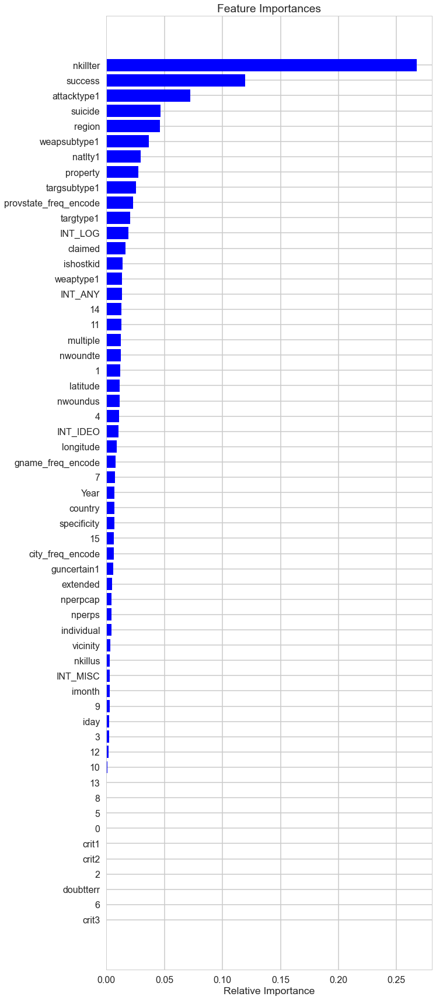

In [325]:
features=X2.columns
importances = xgb.feature_importances_
indices = np.argsort(importances)
fig=plt.figure(figsize=(10,30))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), features[indices])
plt.xlabel('Relative Importance')

In [329]:
from sklearn.preprocessing import RobustScaler #added by Vishal
x_train, x_test, y_train, y_test = train_test_split(X2, y2, test_size=0.2)
scaler=RobustScaler()
x_scaled=scaler.fit_transform(X2)
x_train_scaled=scaler.fit_transform(x_train)
x_test_scaled=scaler.transform(x_test)
X_scaled=pd.DataFrame(x_scaled)
X_train=pd.DataFrame(x_train_scaled)
X_test=pd.DataFrame(x_test_scaled)

#### Model evaluation

In [352]:
from sklearn.neighbors import KNeighborsRegressor #added by vishal
from sklearn.tree import DecisionTreeRegressor  #added by vishal
from sklearn.ensemble import RandomForestRegressor  #added by vishal
from xgboost import XGBRegressor  #added by vishal
from sklearn import linear_model  #added by vishal


def get_models():
    models = dict()
    models['knn'] = KNeighborsRegressor()
    models['DT'] = DecisionTreeRegressor()
    models['RR'] = RandomForestRegressor()
    models['XGB'] = XGBRegressor()
    models['BR'] = linear_model.BayesianRidge()   #modified by vishal
    return models

In [364]:
from sklearn.model_selection import RepeatedKFold #added by vishal
from sklearn.model_selection import cross_val_score #added by vishal
def evaluate_model(model, X, y):
    cv = RepeatedKFold(n_splits=5, n_repeats=3, random_state=1)
    scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
    return scores

In [365]:
models = get_models()

>knn -0.533 (0.003)
>DT -0.549 (0.006)
>RR -0.428 (0.004)
>XGB -0.462 (0.004)
>BR -0.638 (0.002)


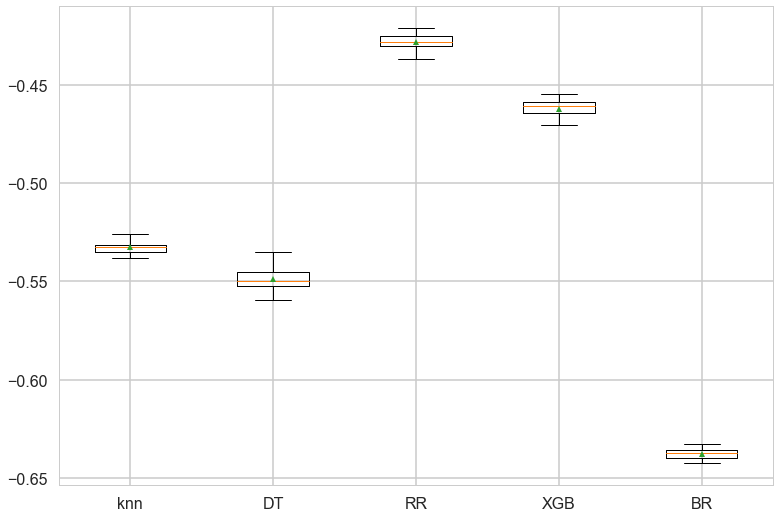

In [372]:
#import pandas as pd  #added by vishal
#import statistics #added by vishal
results, names = list(), list()
for name, model in models.items():
    scores = evaluate_model(model, X_scaled, y2)
    results.append(scores)
    names.append(name)
    
    print('>%s %.3f (%.3f)' % (name, np.mean(scores), np.std(scores))) # modified by vishal
# plot model performance for comparison
pyplot.boxplot(results, labels=names, showmeans=True)
pyplot.show()

#### Split the dataset and fit into the model

In [373]:
n_estimators = [50,100,200,300]
max_depth = [10,30,50,70,90,120]
max_features = ['auto', 'sqrt']
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False]

random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}

print(random_grid)

{'n_estimators': [50, 100, 200, 300], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 30, 50, 70, 90, 120, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


In [374]:
rf = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, cv = 5, verbose=2, random_state=42, n_jobs = -1)
rf_random.fit(X_train.values, y_train.values)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 30, 50, 70, 90, 120,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [50, 100, 200, 300]},
                   random_state=42, verbose=2)

In [375]:
rf_random.best_estimator_

RandomForestRegressor(n_estimators=300)

In [376]:
rf1=RandomForestRegressor(bootstrap=rf_random.best_params_['bootstrap'], 
                         max_depth=rf_random.best_params_['max_depth'], 
                         max_features=rf_random.best_params_['max_features'],
                      min_samples_leaf=rf_random.best_params_['min_samples_leaf'])

In [377]:
rf1.fit(X_train.values, y_train.values)

RandomForestRegressor()

In [379]:
y_pred = rf1.predict(X_test.values) #added by vishal
MSE = mse(y_pred, y_test.values)
RMSE = np.sqrt(MSE)
R_squared = r2_score(y_test.values, y_pred)
print("RMSE: ", np.round(RMSE, 2))
print("R-Squared: ", np.round(R_squared, 2))

RMSE:  0.63
R-Squared:  0.61


In [380]:
print('Mean values of actual test labels is ', '%.5f'%np.mean(y_test.values))
print('Mean values of predicted test labels is ', '%.5f'%np.mean(y_pred))
print('The error of mean values of labels is ', "{0:.2f}".format(abs(np.mean(y_pred)-np.mean(y_test.values))/np.mean(y_test.values)*100),'%')
print('The accuracy of mean values of labels is ', "{0:.2f}".format(100- abs(np.mean(y_pred)-np.mean(y_test.values))/np.mean(y_test.values)*100),'%')

Mean values of actual test labels is  1.07537
Mean values of predicted test labels is  1.08673
The error of mean values of labels is  1.06 %
The accuracy of mean values of labels is  98.94 %


## 4.6 Classification Problem Q6 - Group responsible for attack

### 4.6.1 Define X and Y dataset

In [192]:
X1=df_dropna.drop(['attacktype1'],axis = 1)
y1 = df_dropna['attacktype1']

In [193]:
X1.head()

,Year,imonth,iday,extended,country,region,provstate,city,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,targtype1,target1,natlty1,gname,guncertain1,individual,nperps,nperpcap,claimed,weaptype1,weapsubtype1,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,agriculture,CO2_emissions,electric_power_consumption,energy_use,exports_of_goods_and_services,external_debt_stocks,fertility_rate,foreign_direct_investment,forest_area,GDP_per_capita,gni_per_capita_atlas_method,high_technology_exports,immunization,ncome_share,industry,inflation,life_expectancy_at_birth,market_capitalization,merchandise_trade,military_expenditure,mobile_cellular_subscriptions,mortality_rate,net_migration,personal_remittances,poverty_headcount_ratio,prevalence_of_HIV,revenue,school_enrollment,total_debt_service,water_productivity
0,1970,7,2,0,58,2,1535,30750,18.456792,-69.951164,1.0,0,1,1,1,0,0,1,0,14,40210,58.0,1844,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,13,0,0,0,0,23.237967,0.691068,809.182598,763.631851,17.953026,3.895480e+08,6.182,-71600000.0,39648.26,330.131506,340.0,3.038096,73.0,7.1,25.161716,3.816667,58.093000,37.508914,37.226523,2.416695,0.0,123.7,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,3.140563,3.896976
1,1970,0,0,0,130,1,694,22943,19.371887,-99.086624,1.0,0,1,1,1,0,0,1,0,7,48380,21.0,13,0.0,0,7.0,0.0,0.0,13,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1.0,13,0,1,1,1,12.120563,2.215287,809.182598,763.631851,7.754617,7.097272e+09,6.611,-200701558.7,39648.26,689.794929,680.0,3.038096,73.0,7.1,30.604707,5.003412,61.362000,37.508914,10.875563,0.497412,0.0,106.7,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,3.765081,3.896976
2,1970,1,0,0,160,5,2209,35664,15.478598,120.599741,4.0,0,1,1,1,0,0,1,0,10,27229,217.0,3304,0.0,0,1.0,0.0,0.0,13,16.0,1.0,0.0,0.0,0.0,0.0,0.0,0,0.0,13,-9,-9,1,1,26.358878,0.692154,809.182598,763.631851,21.821984,2.196028e+09,6.264,-200701558.7,39648.26,211.129088,250.0,3.038096,73.0,7.1,35.426467,14.381462,63.155000,37.508914,30.122317,2.156757,0.0,83.6,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,4.144918,3.896976
3,1970,1,0,0,78,8,157,2796,37.997490,23.762728,1.0,0,1,1,1,0,0,1,0,7,74930,217.0,3304,0.0,0,1.0,0.0,0.0,6,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,15.970157,2.748330,1023.791495,872.783728,7.882934,2.248007e+10,2.400,-200701558.7,39648.26,1494.387984,1790.0,3.038096,73.0,7.1,27.101006,2.841682,70.903634,37.508914,19.794726,4.197302,0.0,30.9,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,2.388559,3.896976
4,1970,1,0,0,101,4,717,11663,33.580412,130.396361,1.0,0,1,1,1,-9,0,1,0,7,74910,217.0,3304,0.0,0,1.0,0.0,0.0,8,16.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0.0,13,-9,-9,1,1,15.970157,7.435212,3251.356344,2480.752696,10.360223,2.248007e+10,2.135,-200701558.7,39648.26,2056.122046,1880.0,3.038096,73.0,7.1,27.101006,6.764139,71.950244,37.508914,17.966768,0.773230,0.0,17.5,-193380.0,222000000.0,23.5,0.1,18.744871,0.98358,2.388559,3.896976


Counter({3: 89384, 2: 44341, 1: 20182, 6: 12168, 7: 9489, 9: 9369, 5: 1010, 8: 867, 4: 673})


Text(0, 0.5, 'Frequency')

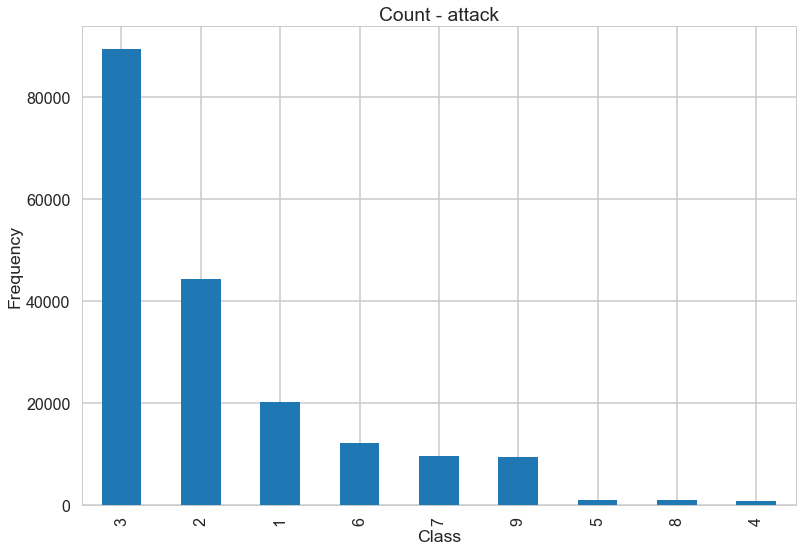

In [194]:
from collections import Counter
from matplotlib import pyplot

# summarize class distribution
counter = Counter(df_dropna['attacktype1'])
print(counter)
pd.value_counts(df_dropna['attacktype1']).plot.bar()
plt.title('Count - attack')
plt.xlabel('Class')
plt.ylabel('Frequency')

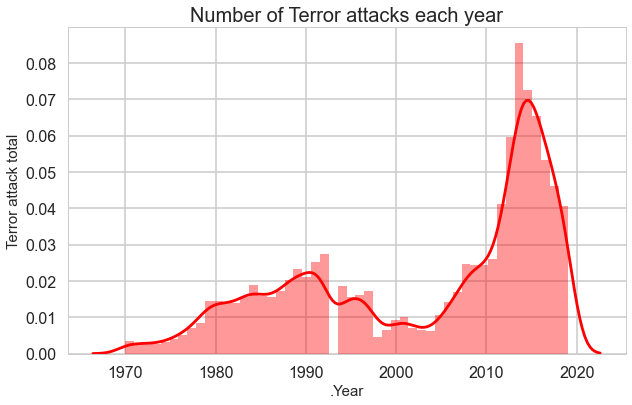

In [195]:
#no. of terror attacks
plt.figure(figsize=(10,6))
fig = sns.distplot(df_dropna["Year"].values, color = 'r')
fig.set_xlabel(".Year",size=15)
fig.set_ylabel("Terror attack total",size=15)
plt.title('Number of Terror attacks each year',size = 20)
plt.show()

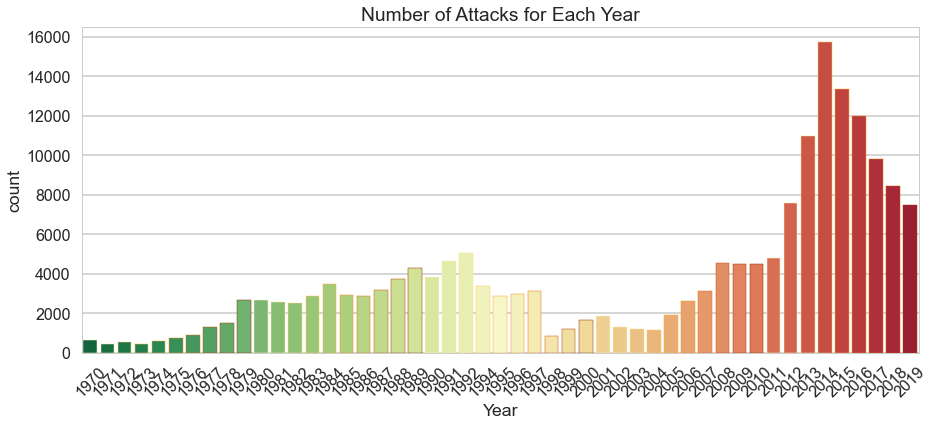

In [196]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=df_dropna,palette='RdYlGn_r',edgecolor=sns.color_palette("YlOrBr", 10))
plt.xticks(rotation=45)
plt.title('Number of Attacks for Each Year')
plt.show()

### 4.6.2 Selecting Importance Features 

In [197]:
model_tree = RandomForestClassifier(random_state=100, n_estimators=50)
model_tree.fit(X1, y1)
print(model_tree.feature_importances_)
sel_model_tree = SelectFromModel(estimator=model_tree, prefit=True, threshold='mean')  
      # since we already fit the data, we specify prefit option here
      # Features whose importance is greater or equal to the threshold are kept while the others are discarded.
X_sfm_tree = sel_model_tree.transform(X1)
print(sel_model_tree.get_support())

[2.16578823e-02 1.21249828e-02 1.48193220e-02 3.00032478e-02
 4.19045685e-03 4.03927712e-03 1.07539056e-02 1.27049089e-02
 1.82061664e-02 1.70852340e-02 3.59182183e-03 1.28148688e-03
 5.33549718e-04 3.50500496e-04 4.75304782e-03 8.97351422e-03
 2.78915123e-03 1.42553678e-02 2.95394244e-03 2.26475301e-02
 2.36866144e-02 4.79330935e-03 8.55294818e-03 1.22719838e-03
 6.75488475e-05 7.26324751e-03 1.05944077e-03 1.70657449e-03
 2.58568416e-01 1.52626883e-01 2.87872146e-02 1.40492274e-04
 3.81816849e-03 1.90303322e-02 1.14201515e-04 1.22267690e-03
 3.99211395e-02 6.58912470e-02 5.16996727e-03 3.21527732e-03
 4.12727317e-03 1.45730318e-03 3.64407451e-03 5.70855287e-03
 8.06484680e-03 5.51701933e-03 5.06246014e-03 5.59478438e-03
 5.13790712e-03 6.71818326e-03 6.07300760e-03 6.46452981e-03
 7.34527008e-03 6.70158214e-03 2.59981701e-03 4.78689067e-03
 1.49399998e-03 8.20908373e-03 6.47784325e-03 6.51339568e-03
 2.94689092e-03 5.67866953e-03 6.68883989e-03 1.10001875e-02
 6.23882482e-03 1.648756

In [198]:
print(X_sfm_tree.shape)

(187483, 14)


### 4.6.3 Creating Random Forest Model and Evaluation

In [199]:
# Import libraries and classes required for this example:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import pandas as pd 

# Split dataset into random train and test subsets:
X_train, X_test, y_train, y_test = train_test_split(X_sfm_tree, y1, test_size=0.20) 

# Standardize features by removing mean and scaling to unit variance:
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test) 

# Use the KNN classifier to fit data:
classifier = RandomForestClassifier()
classifier.fit(X_train, y_train) 

# Predict y data with classifier: 
y_predict = classifier.predict(X_test)

# Print results: 
print(confusion_matrix(y_test, y_predict))
print(classification_report(y_test, y_predict)) 

[[ 3232   515   269     0     0    49    12     4    54]
 [  252  8046   313     1    17    60   152     9    16]
 [   45   181 17537     0     0     9    25     2    52]
 [    9    20     1    39     1    51     6     0     8]
 [    1    29    10     1    88    63     0     0     7]
 [   19    35     4     3    27  2339     2     1    10]
 [    3   207     7     0     2    12  1551     4    46]
 [    5    10     0     0     1     0    12   139     0]
 [   21     6     6     0     1     7    17     0  1814]]
              precision    recall  f1-score   support

           1       0.90      0.78      0.84      4135
           2       0.89      0.91      0.90      8866
           3       0.97      0.98      0.97     17851
           4       0.89      0.29      0.44       135
           5       0.64      0.44      0.52       199
           6       0.90      0.96      0.93      2440
           7       0.87      0.85      0.86      1832
           8       0.87      0.83      0.85       167

Text(0.5, 1.0, 'Confusion Matrix')

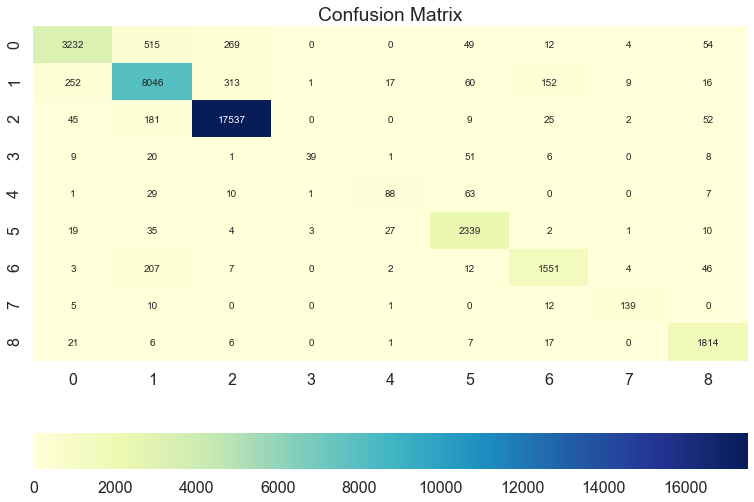

In [200]:
from sklearn import metrics
conf_matrix = metrics.confusion_matrix(y_test, y_predict)
grid_kws = {"height_ratios": (.8, .05), "hspace": .3}
ax = sns.heatmap(conf_matrix, annot = True, fmt='d', cmap="YlGnBu",  cbar_kws={"orientation": "horizontal"})
ax.set_title("Confusion Matrix")

## 4.7 Classification Problem Q7 - Will the attack be a part of multiple attacks

In [201]:
df_Q7 = df.copy()

### 4.7.1 - Target Variable - multiple

Counter({0: 160467, 1: 27016})


Text(0, 0.5, 'Frequency')

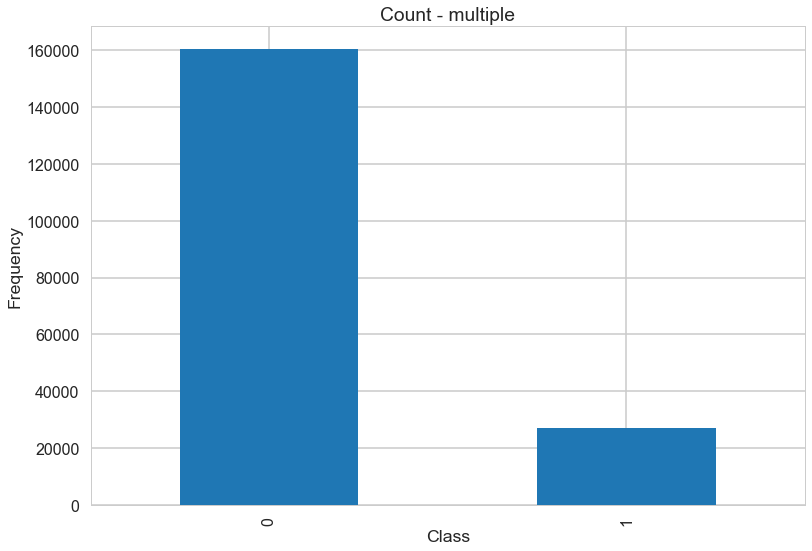

In [202]:
from collections import Counter
from matplotlib import pyplot

# summarize class distribution
counter = Counter(df_Q7['multiple'])
print(counter)
pd.value_counts(df_Q7['multiple']).plot.bar()
plt.title('Count - multiple')
plt.xlabel('Class')
plt.ylabel('Frequency')

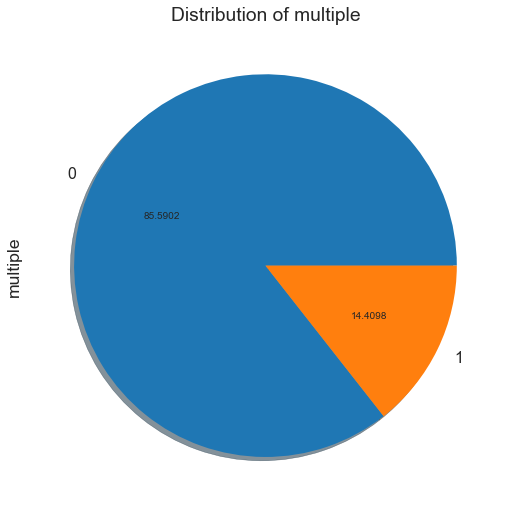

In [203]:
ax = df_Q7['multiple'].value_counts().plot(kind='pie',autopct='%.4f', shadow=True)
ax.set_title("Distribution of multiple")
plt.show()

### 4.7.2  Univariate Analysis 

In [204]:
cols_Q7 = df_Q7.columns.difference(['suicide','success','multiple','gname'])
cols_Q7

Index(['CO2_emissions', 'GDP_per_capita', 'INT_ANY', 'INT_IDEO', 'INT_LOG',
       'INT_MISC', 'Year', 'agriculture', 'attacktype1', 'city', 'claimed',
       'country', 'crit1', 'crit2', 'crit3', 'dbsource', 'doubtterr',
       'electric_power_consumption', 'energy_use',
       'exports_of_goods_and_services', 'extended', 'external_debt_stocks',
       'fertility_rate', 'foreign_direct_investment', 'forest_area',
       'gni_per_capita_atlas_method', 'guncertain1', 'high_technology_exports',
       'iday', 'immunization', 'imonth', 'individual', 'industry', 'inflation',
       'ishostkid', 'latitude', 'life_expectancy_at_birth', 'longitude',
       'market_capitalization', 'merchandise_trade', 'military_expenditure',
       'mobile_cellular_subscriptions', 'mortality_rate', 'natlty1',
       'ncome_share', 'net_migration', 'nkill', 'nkillter', 'nkillus',
       'nperpcap', 'nperps', 'nwound', 'nwoundte', 'nwoundus',
       'personal_remittances', 'poverty_headcount_ratio', 'prevalence

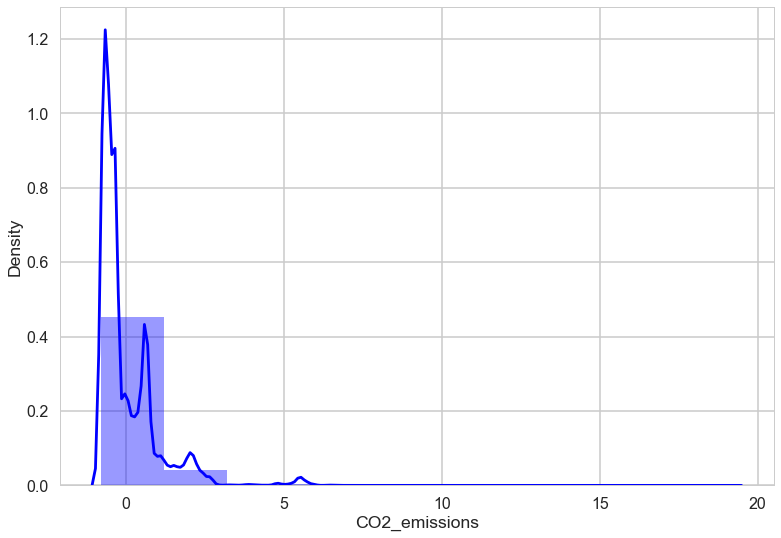

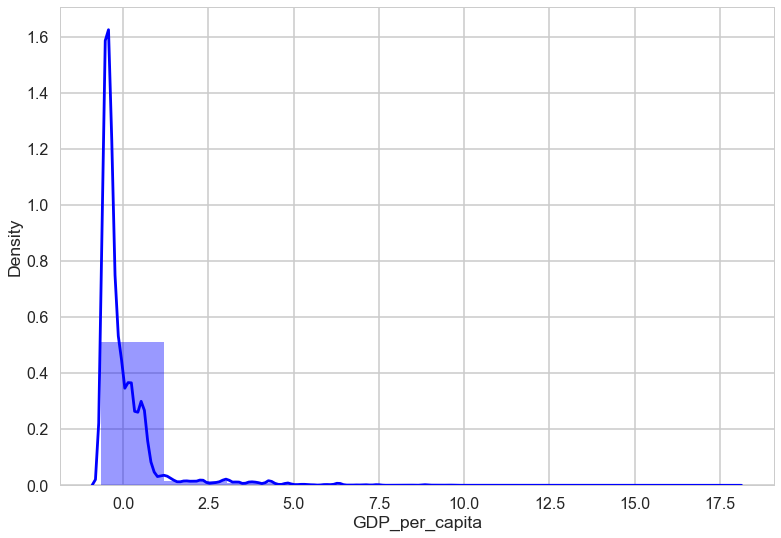

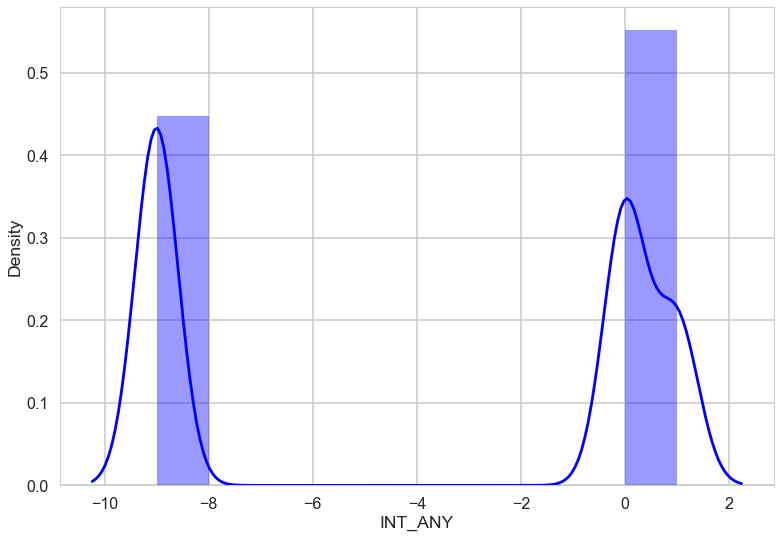

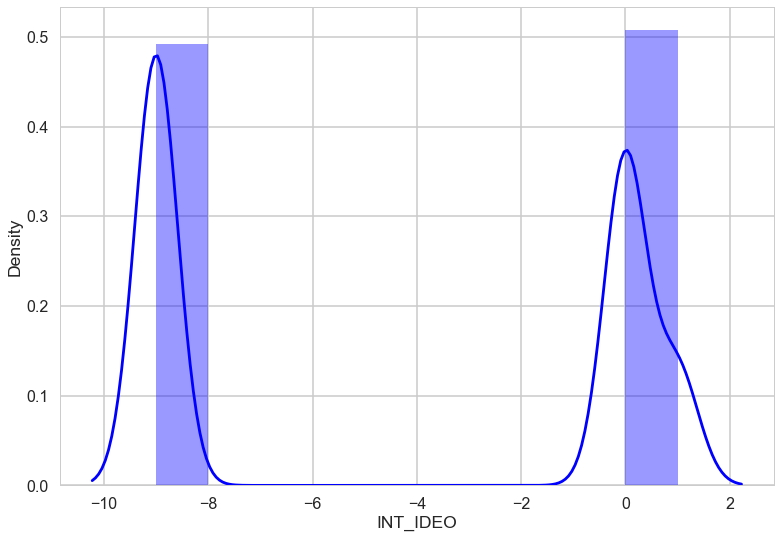

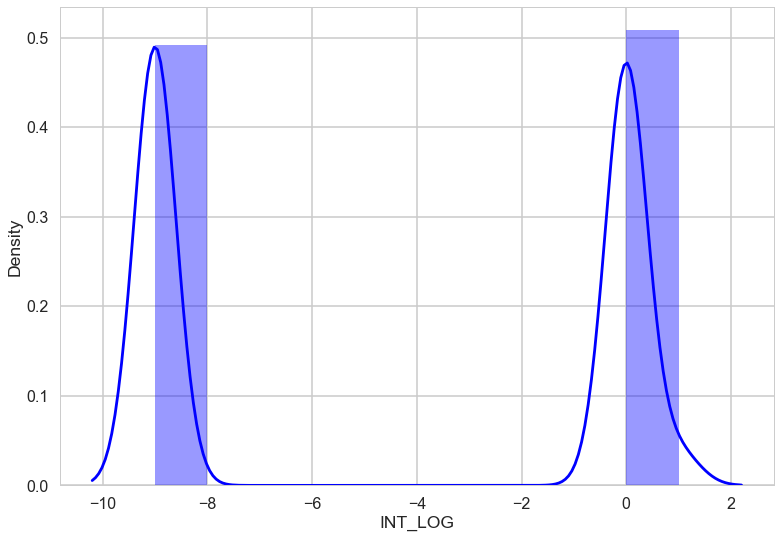

...

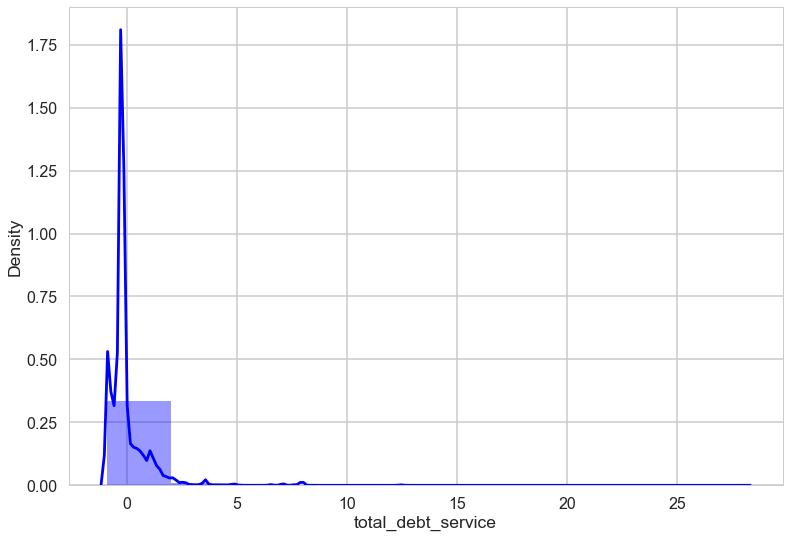

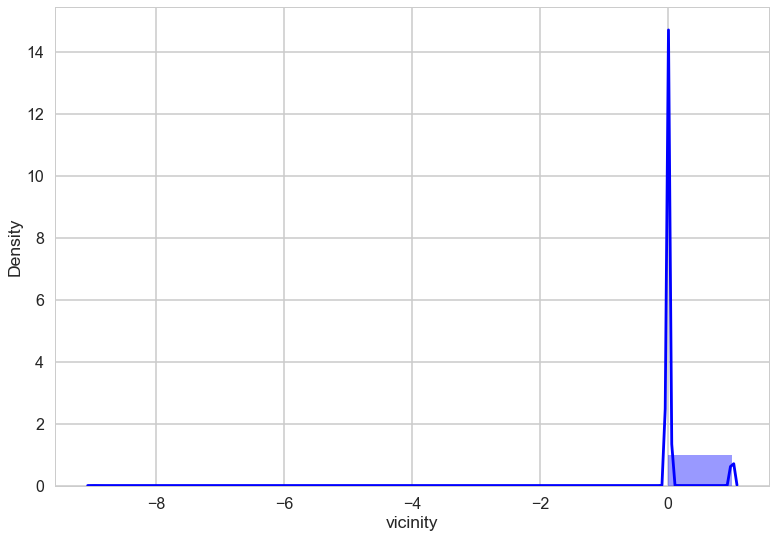

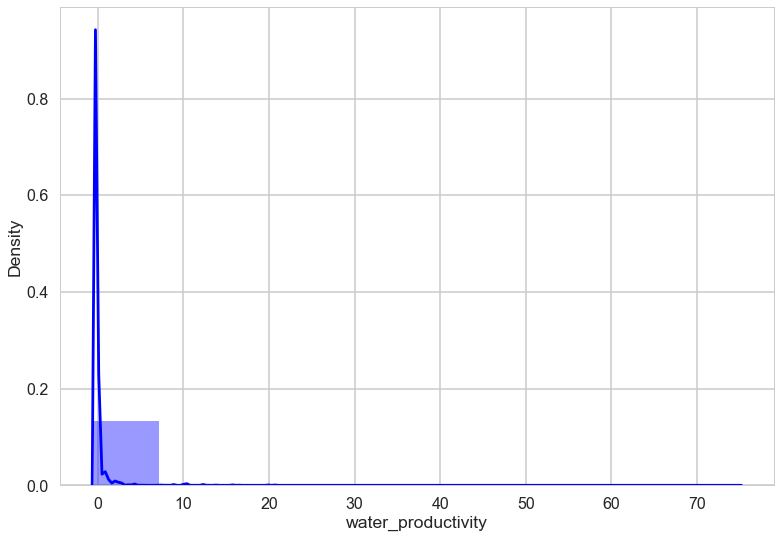

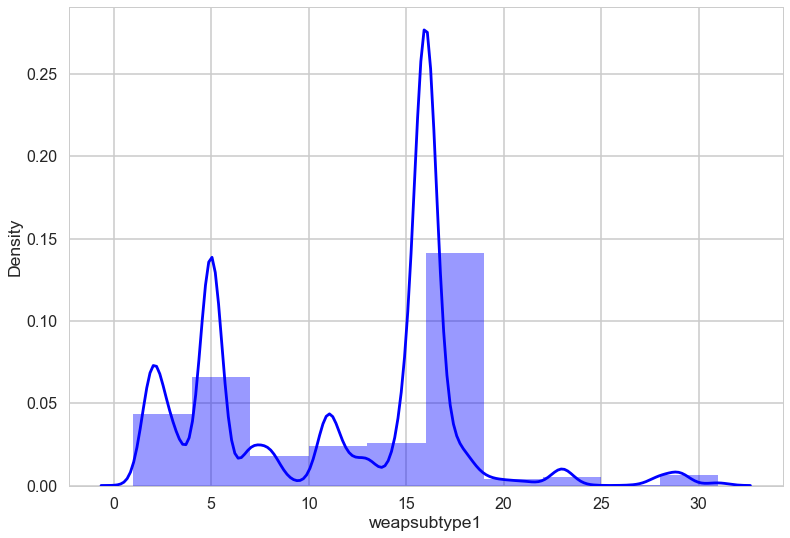

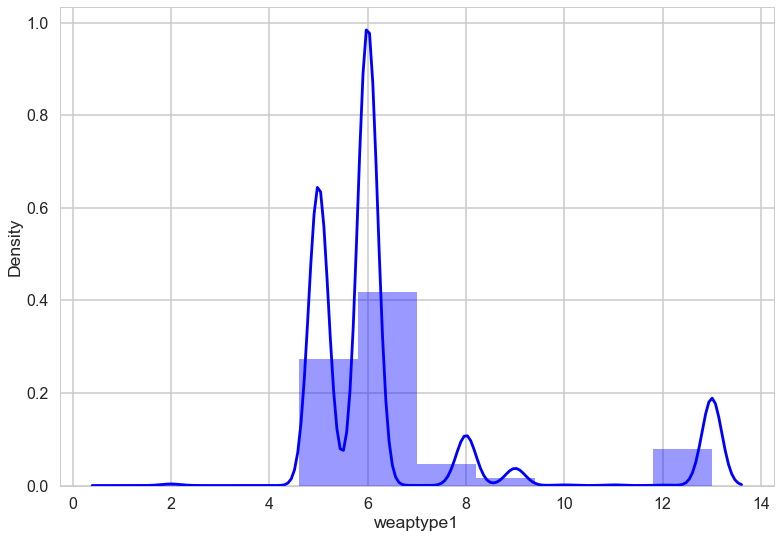

In [205]:
# distribution plot for each predictor 
for c in cols_Q7:
    sns.distplot(df_Q7[c], kde=True, color='blue',bins=10)
    plt.show() 

### 4.7.3  Bivariate Analysis

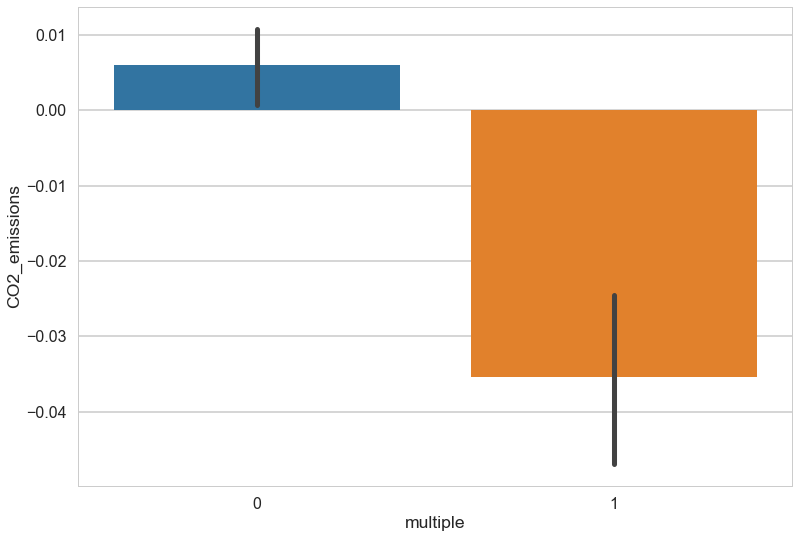

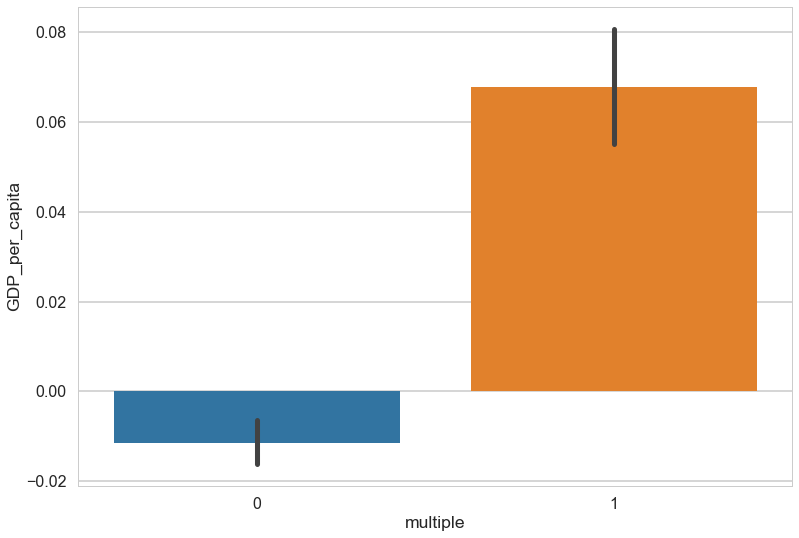

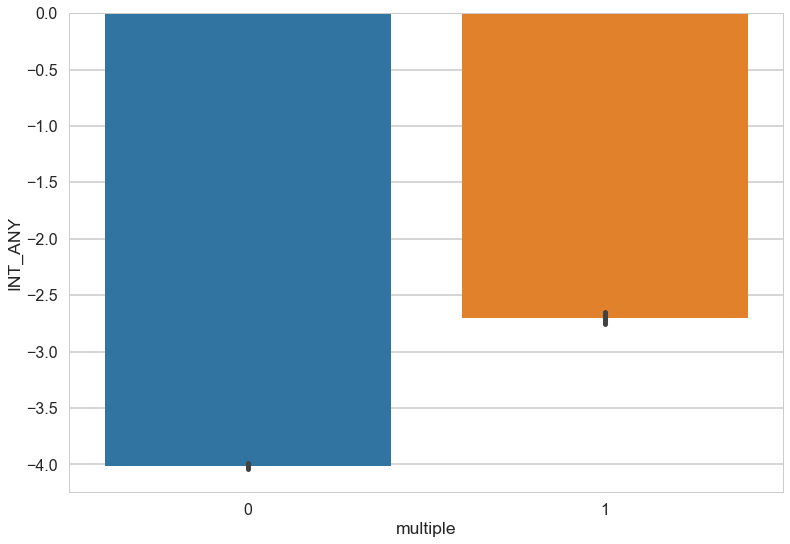

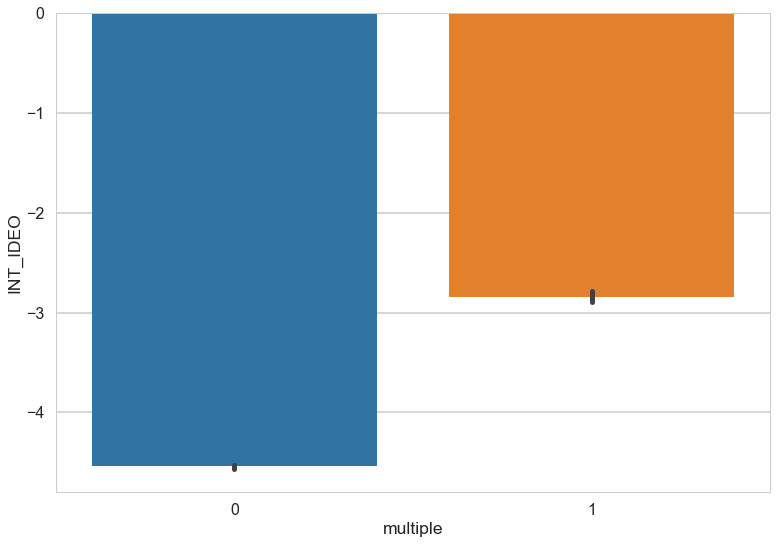

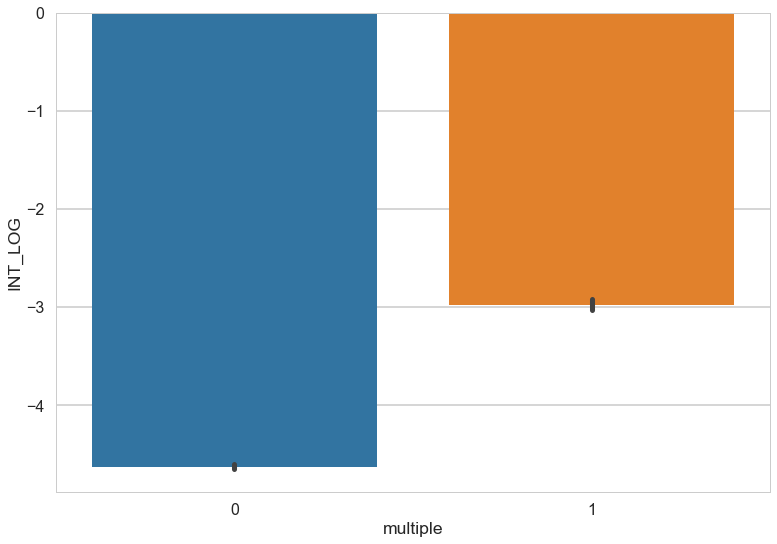

...

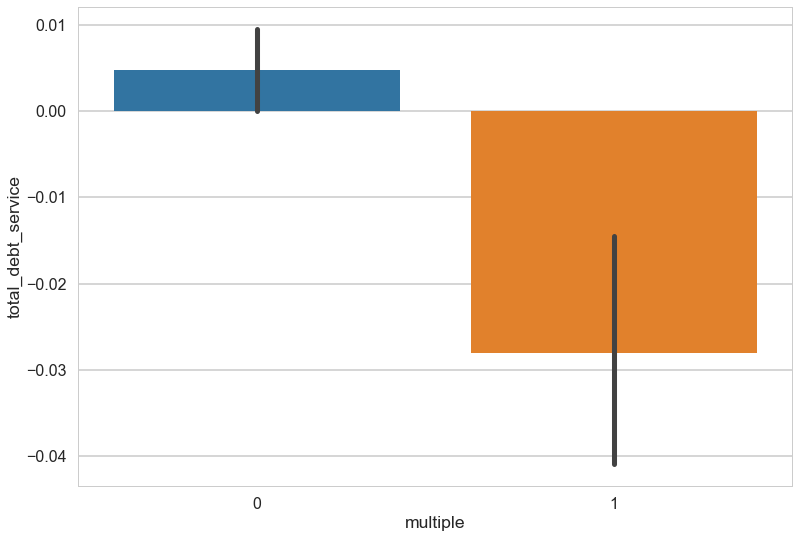

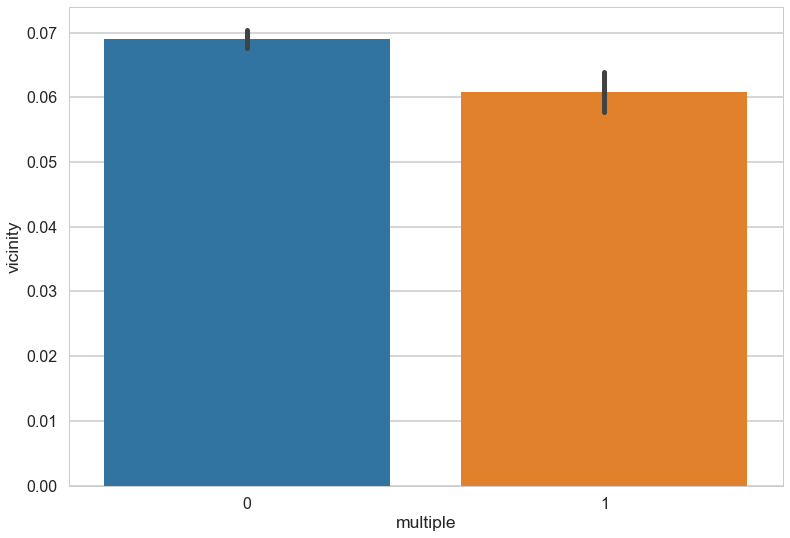

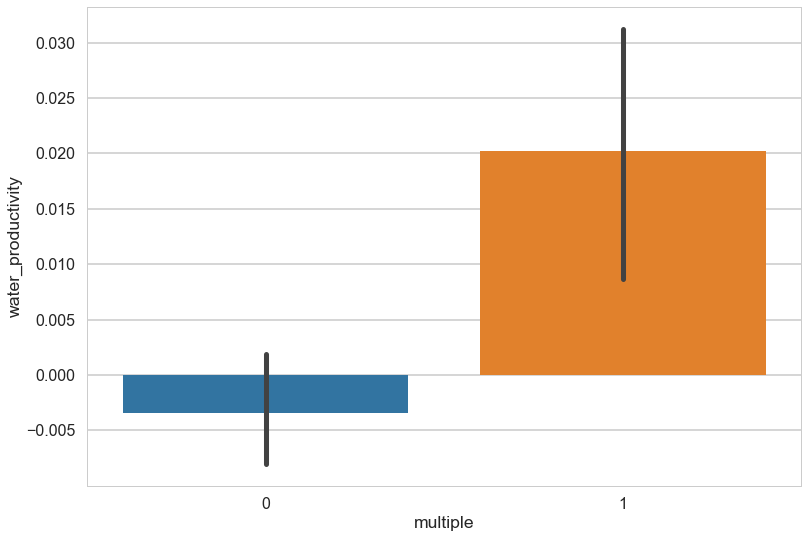

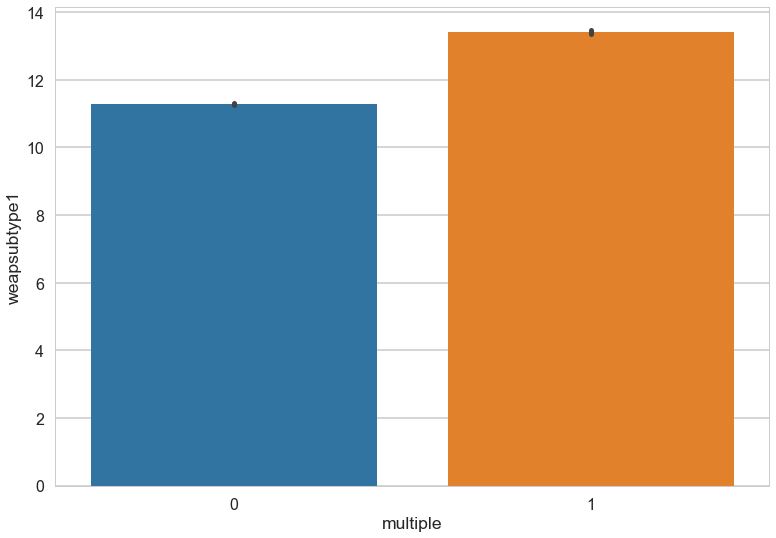

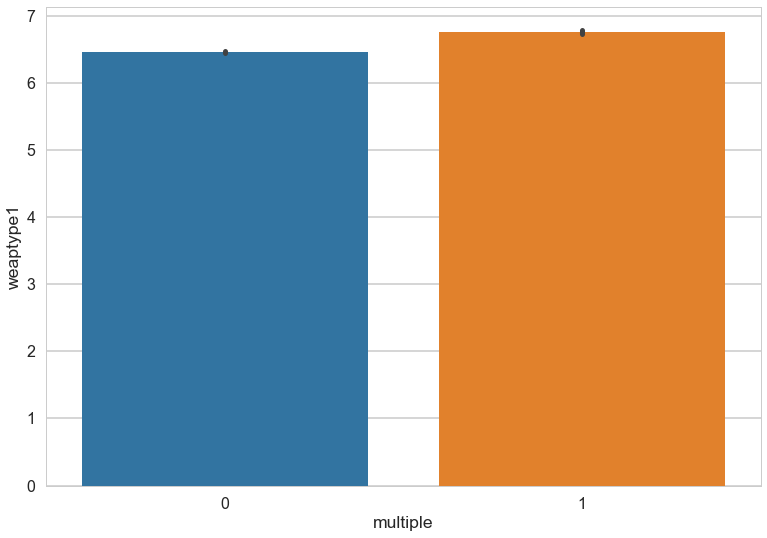

In [206]:
import seaborn as sns
for c in cols_Q7:
    sns.barplot(x='multiple',y=c,data=df_Q7)
    plt.show()

### 4.7.4 Separate predictor and target variables

In [207]:
results_multiple = df_Q7

In [208]:
X_Q7=df_Q7.drop(['success','multiple','suicide','gname'],axis = 1)
X_Q7.shape

(187483, 71)

In [209]:
y_Q7=df_Q7['multiple']
y_Q7.shape

(187483,)

### 4.7.5 Train and Test split

In [210]:
X_Q7_train,X_Q7_test,y_Q7_train,y_Q7_test=train_test_split(X_Q7,y_Q7,test_size=0.20, random_state=42)

In [211]:
#print shape of train 
print(X_Q7_train.shape,y_Q7_train.shape)

(149986, 71) (149986,)


In [212]:
#print shape of test
print(X_Q7_test.shape,y_Q7_test.shape)

(37497, 71) (37497,)


### 4.7.6 Benchmark model

#### 4.7.6a Algorithm 1 - Random Forest Classifier

In [213]:
from sklearn.ensemble import RandomForestClassifier

#create instance of classifier with default parameters
rf_Q7 = RandomForestClassifier()

#fit the model
rf_Q7 .fit(X_Q7_train,y_Q7_train)

RandomForestClassifier()

In [214]:
#make predictions on training data
y_pred_train_rf_Q7  = rf_Q7.predict(X_Q7_train)
y_pred_train_rf_Q7

array([0, 0, 0, ..., 0, 1, 0], dtype=int64)

In [215]:
#training accuracy 
from sklearn.metrics import accuracy_score
rf_train_accuracy_Q7  = accuracy_score(y_Q7_train,y_pred_train_rf_Q7)
rf_train_accuracy_Q7 

0.999799981331591

In [216]:
y_pred_test_rf_Q7  = rf_Q7.predict(X_Q7_test)
y_pred_test_rf_Q7 

array([0, 1, 0, ..., 0, 0, 1], dtype=int64)

In [217]:
#test accuracy
rf_test_accuracy_Q7 = accuracy_score(y_Q7_test,y_pred_test_rf_Q7)
rf_test_accuracy_Q7

0.945862335653519

#### 4.7.6b Algorithm 2 - Logistic Regression Classifier

In [218]:
from sklearn.linear_model import LogisticRegression
lr_Q7 = LogisticRegression()

#fit the model
lr_Q7.fit(X_Q7_train,y_Q7_train)

LogisticRegression()

In [219]:
#make predictions on training data
y_pred_train_lr_Q7 = lr_Q7.predict(X_Q7_train)

In [220]:
#training accuracy
lr_train_accuracy_Q7 = accuracy_score(y_Q7_train,y_pred_train_lr_Q7)
lr_train_accuracy_Q7

0.8559065512781193

In [221]:
#training accuracy
lr_train_accuracy_Q7 = accuracy_score(y_Q7_train,y_pred_train_lr_Q7)
lr_train_accuracy_Q7

0.8559065512781193

In [222]:
#make predictions on test data
y_pred_test_lr_Q7 = lr_Q7.predict(X_Q7_test)

In [223]:
#test accuracy
lr_test_accuracy_Q7 = accuracy_score(y_Q7_test,y_pred_test_lr_Q7)
lr_test_accuracy_Q7

0.8558818038776436

#### 4.7.6c Algorithm 3 - XgBoost Classifier

In [224]:
import xgboost 
from xgboost.sklearn import XGBClassifier

xg_Q7=XGBClassifier(max_depth=7,
                        learning_rate=0.05,
                       eta=1,
                        objective='binary:logistic',
                        use_label_encoder=False,
                        eval_metric='error') 

xg_Q7.fit(X_Q7_train, y_Q7_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eta=1, eval_metric='error', gamma=0, gpu_id=-1,
              importance_type=None, interaction_constraints='',
              learning_rate=0.05, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1, predictor='auto',
              random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
              subsample=1, tree_method='exact', use_label_encoder=False,
              validate_parameters=1, ...)

In [225]:
#make predictions on training data
y_pred_train_xg_Q7 = xg_Q7.predict(X_Q7_train)

In [226]:
#training accuracy
xg_train_accuracy_Q7 = accuracy_score(y_Q7_train,y_pred_train_xg_Q7)
xg_train_accuracy_Q7

0.886742762657848

In [227]:
#make predictions on test data
y_pred_test_xg_Q7 = xg_Q7.predict(X_Q7_test)

In [228]:
#test accuracy
xg_test_accuracy_Q7 = accuracy_score(y_Q7_test,y_pred_test_xg_Q7)
xg_test_accuracy_Q7

0.8832706616529322

As random forest is giving us the best accuracy results, we will perform parameter tuning for it.

### 4.7.7 Hyper-parameter tuning of Random Forest model

In [229]:
from sklearn.model_selection import GridSearchCV

n_estimators = [25, 50]
max_depth = [5, 10]
min_samples_split = [2, 5]
min_samples_leaf = [3, 6] 

grid_params_rf_Q7 = dict(n_estimators = n_estimators, 
                  max_depth = max_depth,  
                  min_samples_split = min_samples_split, 
                 min_samples_leaf = min_samples_leaf)

rf_cv_Q7 = GridSearchCV(rf_Q7,
                     grid_params_rf_Q7, 
                     cv = 5,
                     verbose = 1, 
                     n_jobs = -1)

rf_cv_Q7.fit(X_Q7_train, y_Q7_train)

Fitting 5 folds for each of 16 candidates, totalling 80 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [5, 10], 'min_samples_leaf': [3, 6],
                         'min_samples_split': [2, 5],
                         'n_estimators': [25, 50]},
             verbose=1)

In [230]:
#find the best parameters
rf_cv_Q7.best_params_

{'max_depth': 10,
 'min_samples_leaf': 3,
 'min_samples_split': 5,
 'n_estimators': 50}

In [231]:
#find the best score
rf_cv_Q7.best_score_


0.8753217000034115

In [232]:
#find the best estimator
rf_cv_Q7.best_estimator_

RandomForestClassifier(max_depth=10, min_samples_leaf=3, min_samples_split=5,
                       n_estimators=50)

### 4.7.8 Rebuild the optimized model

In [233]:
rf_best_Q7 = RandomForestClassifier(n_estimators=25, 
                                    max_depth=10,
                                    max_features='auto', 
                                    min_samples_leaf=3,
                                    min_samples_split=5,
                                    bootstrap=True, 
                                    n_jobs=-1, 
                                    random_state=0)

rf_best_Q7.fit(X_Q7_train, y_Q7_train)

y_pred_best_Q7 = rf_best_Q7.predict(X_Q7_test)

accuracy_score(y_Q7_test,y_pred_best_Q7)

0.8757233912046297

### 4.7.9 Feature Importance

Text(88.675, 0.5, 'FEATURE IMPORTANCE')

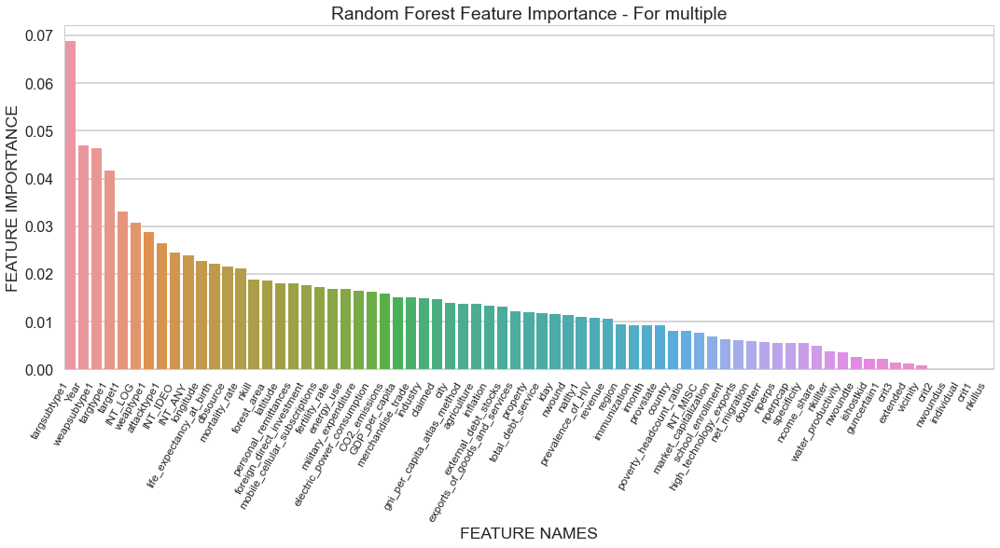

In [234]:
feature_importance_Q7 = np.array(rf_best_Q7.feature_importances_)
feature_names_Q7 = np.array(X_Q7_train.columns)

#create a DataFrame using a Dictionary
data_Q7={'feature_names':feature_names_Q7,'feature_importance':feature_importance_Q7}
fi_df_Q7 = pd.DataFrame(data_Q7)

#sort the DataFrame in order decreasing feature importance
fi_df_Q7.sort_values(by=['feature_importance'], ascending=False,inplace=True)

#define size of bar plot
plt.figure(figsize=(15,8))

#Plot Searborn bar chart
#sns.barplot(x=fi_df_Q1['feature_importance'], y=fi_df_Q1['feature_names'])
ax = sns.barplot(x=fi_df_Q7['feature_names'], y=fi_df_Q7['feature_importance'])

#add chart labels
ax.set_xticklabels(ax.get_xticklabels(), fontsize=12,rotation=60, ha="right")  #it will rotate text on x axis

plt.tight_layout()
plt.title('Random Forest Feature Importance - For multiple')
plt.xlabel('FEATURE NAMES')
plt.ylabel('FEATURE IMPORTANCE')

### 4.7.10 Confusion Matrix

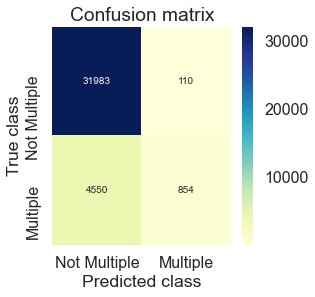

In [235]:
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve
LABELS = ['Not Multiple', 'Multiple']
cm_Q7 = confusion_matrix(y_Q7_test, y_pred_best_Q7)
plt.figure(figsize=(4, 4))
sns.heatmap(cm_Q7, annot=True, fmt='d', cmap='YlGnBu',xticklabels=LABELS, yticklabels=LABELS)
plt.title("Confusion matrix")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

### 4.7.11 ROC-AUC Curve

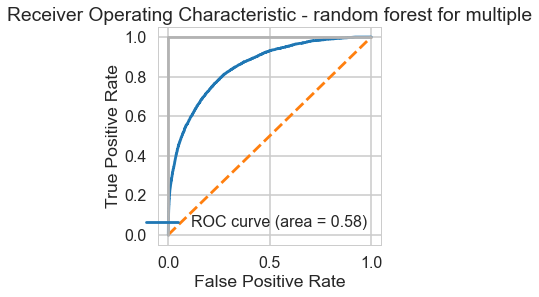

In [236]:
auc_score = metrics.roc_auc_score( y_Q7_test, y_pred_best_Q7)
round( float( auc_score ), 2 )
score = rf_best_Q7.predict_proba(X_Q7_test)[:,1]
false_positive_rate, true_positive_rate, thresholds = roc_curve(y_Q7_test, score)
plt.subplots(1, figsize=(4,4))
plt.title('Receiver Operating Characteristic - random forest for multiple')
plt.plot(false_positive_rate, true_positive_rate, label='ROC curve (area = %0.2f)' % auc_score)
plt.plot([0, 1], ls="--")
plt.plot([0, 0], [1, 0] , c=".7"), plt.plot([1, 1] , c=".7")
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc="lower right")
plt.show()

### 4.7.12 F1-score

In [237]:
f1_positive_Q7 = metrics.f1_score(y_Q7_test, y_pred_best_Q7, pos_label=1)
f1_negative_Q7 = metrics.f1_score(y_Q7_test, y_pred_best_Q7, pos_label=0)
f1_positive_Q7, f1_negative_Q7 

(0.26821608040201, 0.9320957071663801)

### 4.7.13 Precision

In [238]:
precision_positive_Q7 = metrics.precision_score(y_Q7_test, y_pred_best_Q7, pos_label=1)
precision_negative_Q7 = metrics.precision_score(y_Q7_test,y_pred_best_Q7, pos_label=0)
precision_positive_Q7, precision_negative_Q7 

(0.8858921161825726, 0.8754550680206936)

### 4.7.14 Recall

In [239]:
recall_sensitivity_Q7 = metrics.recall_score(y_Q7_test, y_pred_best_Q7, pos_label=1)
recall_specificity_Q7 = metrics.recall_score(y_Q7_test, y_pred_best_Q7, pos_label=0)
recall_sensitivity_Q7, recall_specificity_Q7 

(0.15803108808290156, 0.9965724612843923)

### 4.7.15 Run predictions on the whole data

In [240]:
y_pred_Q7 = rf_best_Q7.predict(X_Q7)
y_pred_Q7

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

### 4.7.16 Save prediction results to CSV

In [241]:
results_multiple.head(5)

results_multiple['multiple_predicted_value'] = y_pred_Q7
results_multiple['multiple_predicted_value'].value_counts()

results_multiple.to_csv("results_multiple.csv", index=False)

# 5. Visualization

In [393]:
conda install -c plotly chart-studio

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\visha\anaconda3

  added / updated specs:
    - chart-studio


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    chart-studio-1.1.0         |             py_0          50 KB  plotly
    retrying-1.3.3             |     pyhd3eb1b0_2          14 KB
    ------------------------------------------------------------

Note: you may need to restart the kernel to use updated packages.
                                           Total:          64 KB

The following NEW packages will be INSTALLED:

  chart-studio       plotly/noarch::chart-studio-1.1.0-py_0
  retrying           pkgs/main/noarch::retrying-1.3.3-pyhd3eb1b0_2




chart-studio-1.1.0   | 50 KB     |            |   0% 
chart-studio-1.1.0   | 50 KB     | ########## | 100% 
chart-studio-1.1.0   | 50 KB     | ########## | 100% 

retrying-1.3.3       |

In [399]:
import numpy as np
import pandas as pd
pd.options.mode.chained_assignment = None

#pip install chart-studio
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly import tools
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

#terror_1 = pd.read_excel('globalterrorismdb_0221dist.xlsx')
terror_1 = data_terrorism.copy()
terror_1.head()                         

,eventid,Year,imonth,iday,approxdate,extended,resolution,country,Country Name,region,region_txt,provstate,city,latitude,longitude,specificity,vicinity,location,summary,crit1,crit2,crit3,doubtterr,alternative,alternative_txt,multiple,success,suicide,attacktype1,attacktype1_txt,attacktype2,attacktype2_txt,attacktype3,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,target1,natlty1,natlty1_txt,targtype2,targtype2_txt,targsubtype2,targsubtype2_txt,corp2,target2,natlty2,natlty2_txt,targtype3,targtype3_txt,targsubtype3,targsubtype3_txt,corp3,target3,natlty3,natlty3_txt,gname,gsubname,gname2,gsubname2,gname3,gsubname3,motive,guncertain1,guncertain2,guncertain3,individual,nperps,nperpcap,claimed,claimmode,claimmode_txt,claim2,claimmode2,claimmode2_txt,claim3,claimmode3,claimmode3_txt,compclaim,weaptype1,weaptype1_txt,weapsubtype1,weapsubtype1_txt,weaptype2,weaptype2_txt,weapsubtype2,weapsubtype2_txt,weaptype3,weaptype3_txt,weapsubtype3,weapsubtype3_txt,weaptype4,weaptype4_txt,weapsubtype4,weapsubtype4_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,property,propextent,propextent_txt,propvalue,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,ransomamt,ransomamtus,ransompaid,ransompaidus,ransomnote,hostkidoutcome,hostkidoutcome_txt,nreleased,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaT,58,Dominican Republic,2,Central America & Caribbean,National,Santo Domingo,18.456792,-69.951164,1.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,1,Assassination,NaN,NaN,NaN,NaN,14,Private Citizens & Property,68.0,Named Civilian,NaN,Julio Guzman,58.0,Dominican Republic,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MANO-D,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaT,130,Mexico,1,North America,Federal,Mexico city,19.371887,-99.086624,1.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,6,Hostage Taking (Kidnapping),NaN,NaN,NaN,NaN,7,Government (Diplomatic),45.0,"Diplomatic Personnel (outside of embassy, consulate)",Belgian Ambassador Daughter,"Nadine Chaval, daughter",21.0,Belgium,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23rd of September Communist League,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,1.0,1.0,0.0,NaN,NaN,NaN,Mexico,1.0,800000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaT,160,Philippines,5,Southeast Asia,Tarlac,Unknown,15.478598,120.599741,4.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,1,Assassination,NaN,NaN,NaN,NaN,10,Journalists & Media,54.0,Radio Journalist/Staff/Facility,Voice of America,Employee,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaT,78,Greece,8,Western Europe,Attica,Athens,37.997490,23.762728,1.0,0,NaN,NaN,1,1,1,0,NaN,NaN,0,1,0,3,Bombing/Explosion,NaN,NaN,NaN,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,U.S. Embassy,217.0,United States,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6,Explosives,16.0,Unknown Explosive Type,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Explosive,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN

In [401]:
terror_1.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country Name':'Country','provstate':'State','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
terror=terror_1[['Year','Month','Day','country','State','Region','city','latitude','longitude','AttackType','Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]
terror['casualities']=terror['Killed']+terror['Wounded']
terror.head(3)

,Year,Month,Day,country,State,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,casualities
0,1970,7,2,58,National,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,130,Federal,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0
2,1970,1,0,160,Tarlac,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1.0


In [402]:
!pip install folium
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
import numpy as np
plt.style.use('fivethirtyeight')
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
#from mpl_toolkits.basemap import Basemap
import folium
import folium.plugins
from matplotlib import animation,rc
import io
import base64
from IPython.display import HTML, display
import warnings
warnings.filterwarnings('ignore')
#from scipy.misc import imread
import codecs
from subprocess import check_output
#print(check_output(["ls", "../input"]).decode("utf8"))

In [403]:
terror = terror.drop_duplicates()
terror

## 5.1 Frequency with Some Features by NLP

Country with the most attacks: 95
City with the most attacks: Baghdad
Region with the most attacks: Middle East & North Africa
Year with the most attacks: 2014
Month with the most attacks: 5
Group with the most attacks: Taliban
Most Attack Types: Bombing/Explosion


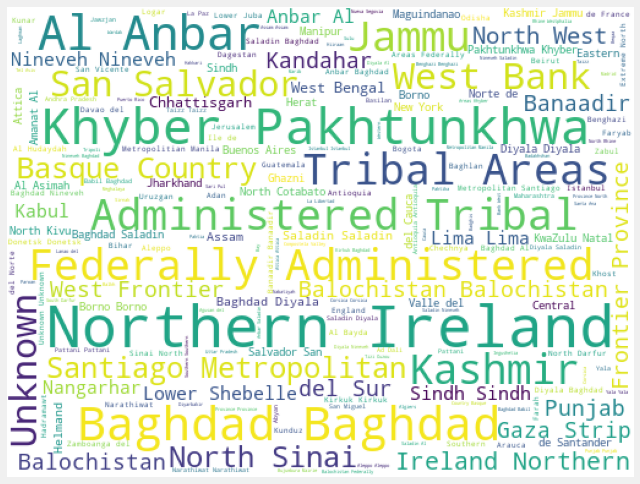

In [407]:
!pip install matplotlib
!pip install pandas
!pip install wordcloud
print("Country with the most attacks:",terror['country'].value_counts().idxmax())
print("City with the most attacks:",terror['city'].value_counts().index[1]) #as first entry is 'unknown'
print("Region with the most attacks:",terror['Region'].value_counts().idxmax())
print("Year with the most attacks:",terror['Year'].value_counts().idxmax())
print("Month with the most attacks:",terror['Month'].value_counts().idxmax())
print("Group with the most attacks:",terror['Group'].value_counts().index[1])
print("Most Attack Types:",terror['AttackType'].value_counts().idxmax())
from wordcloud import WordCloud
from scipy import signal
cities = terror.State.dropna(False)
plt.subplots(figsize=(10,10))
wordcloud = WordCloud(background_color = 'white',
                     width = 512,
                     height = 384).generate(' '.join(cities))
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

## 5.2 Number of Terrorist Activities in Each Year

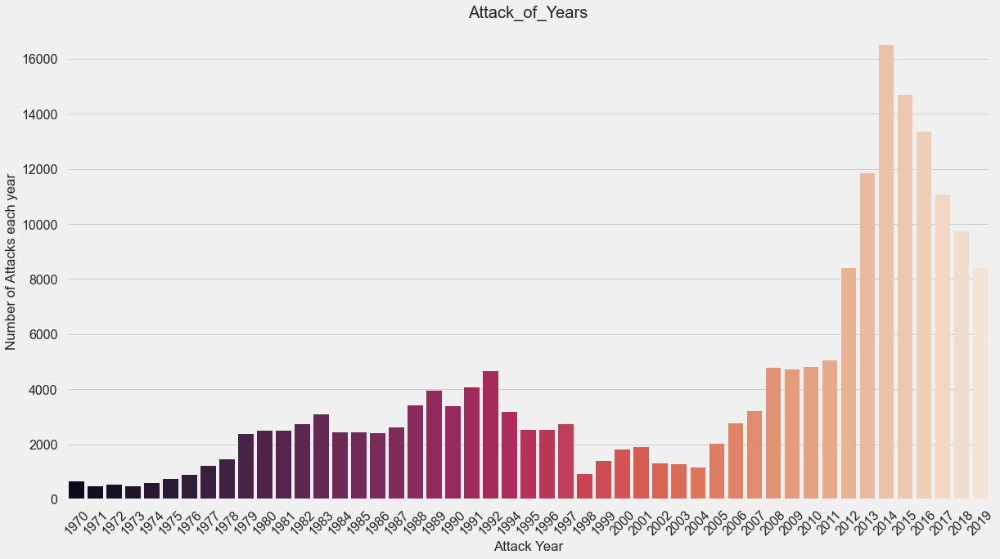

In [408]:
x_year = terror['Year'].unique()
y_count_years = terror['Year'].value_counts(dropna = False).sort_index()
plt.figure(figsize = (18,10))
sns.barplot(x = x_year,
           y = y_count_years,
           palette = 'rocket')
plt.xticks(rotation = 45)
plt.xlabel('Attack Year')
plt.ylabel('Number of Attacks each year')
plt.title('Attack_of_Years')
plt.show()

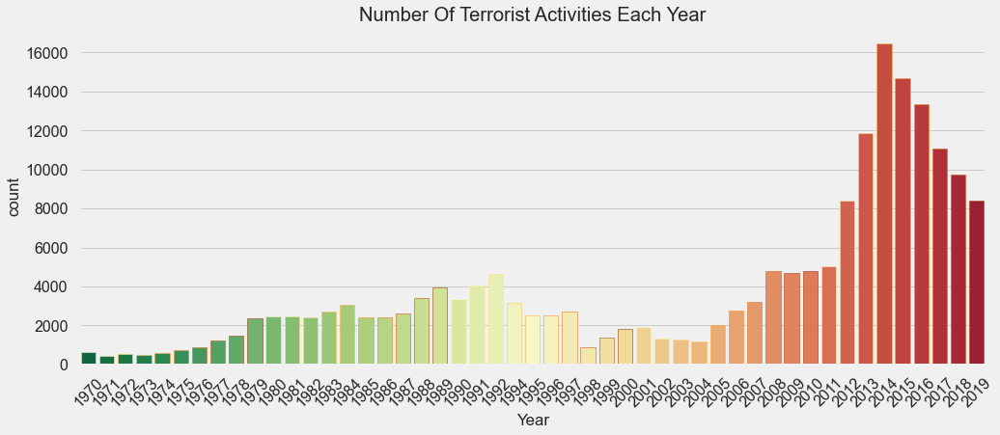

In [409]:
plt.subplots(figsize=(15,6))
sns.countplot('Year',data=terror,palette='RdYlGn_r',edgecolor=sns.color_palette("YlOrBr", 10))
plt.xticks(rotation=45)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()

## 5.3 The top 20 worst terror attacks by Heatmap Visualization

In [412]:
terror1 = terror.sort_values(by='casualities',ascending=False)[:20]
heat=terror1.pivot_table(index='country',columns='Year',values='casualities')
heat.fillna(0,inplace=True)
heat.head()
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
colorscale = [[0, '#edf8fb'], [.3, '#00BFFF'],  [.6, '#8856a7'],  [1, '#810f7c']]
heatmap = go.Heatmap(z=heat.values, x=heat.columns, y=heat.index, colorscale=colorscale)
data = [heatmap]
layout = go.Layout(
    title='Top 20 Worst Terror Attacks in History from 1982 to 2016',
    xaxis = dict(ticks='', nticks=20),
    yaxis = dict(ticks='')
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='heatmap',show_link=False)
terror.country.value_counts()[:15]

95     25545
4      16018
153    14633
92     13100
45      7941
160     7837
228     5463
603     5183
159     5061
182     5012
147     4981
61      4302
209     4258
205     4038
185     3078
Name: country, dtype: int64

## 5.4 Top 10 Countries affected by Terror Attacks

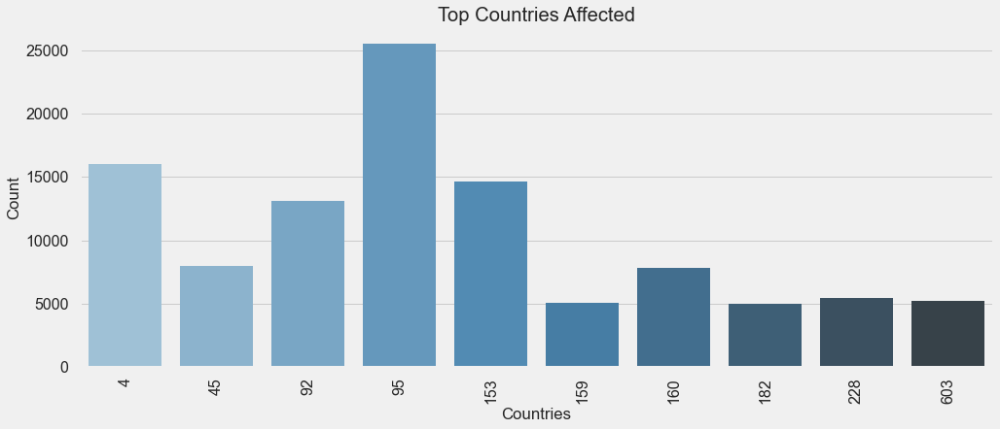

In [413]:
plt.subplots(figsize=(15,6))
sns.barplot(terror['country'].value_counts()[:10].index,terror['country'].value_counts()[:10].values,palette='Blues_d')
plt.title('Top Countries Affected')
plt.xlabel('Countries')
plt.ylabel('Count')
plt.xticks(rotation= 90)
plt.show()

## 5.5 Main weapon: Explosives

In [414]:
from pandas import DataFrame


weapons = terror_1['Weapon_type'].value_counts()
weapons = DataFrame(weapons)

weapons.reset_index(level=0, inplace=True)
weapons.columns = ['Weapon used', 'Weapon Count']
weapons

,Weapon used,Weapon Count
0,Explosives,100333
1,Firearms,64923
2,Unknown,18462
3,Incendiary,12445
4,Melee,4115
5,Chemical,344
6,Sabotage Equipment,175
7,"Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)",170
8,Other,134
9,Biological,36


<AxesSubplot:xlabel='Weapon used'>

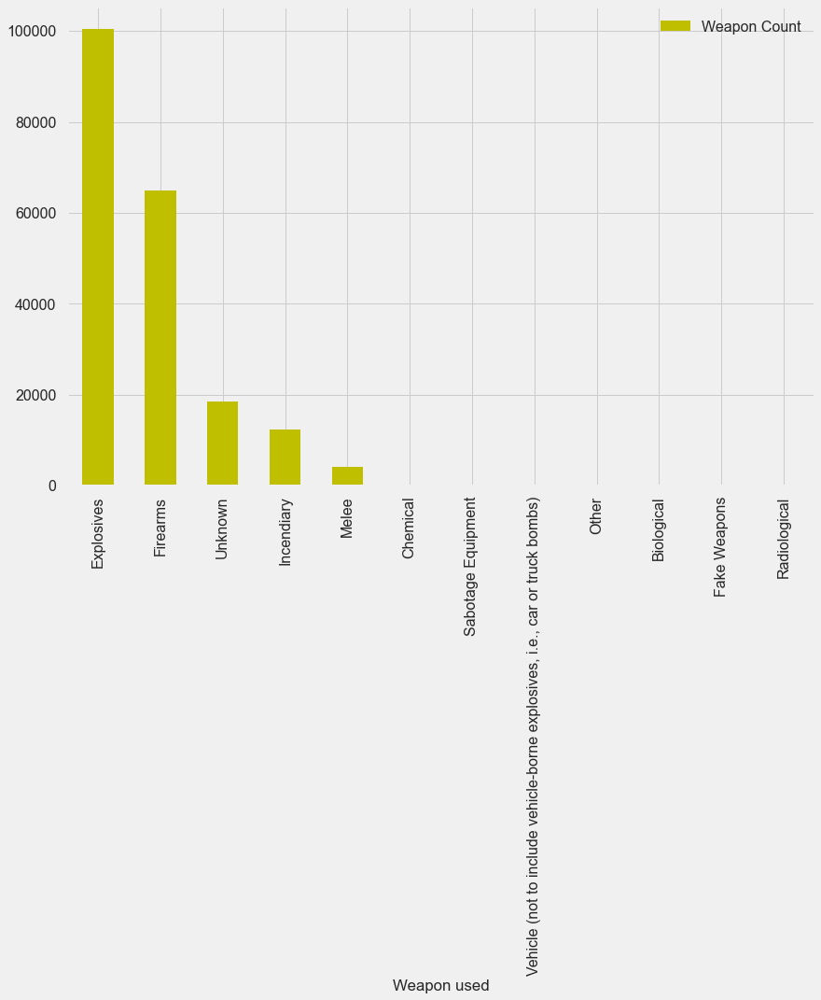

In [415]:
weapons.plot.bar(x='Weapon used', y='Weapon Count', rot=90, color = 'y')

## 5.6 Time Series for Suicide in Year, Month, Day

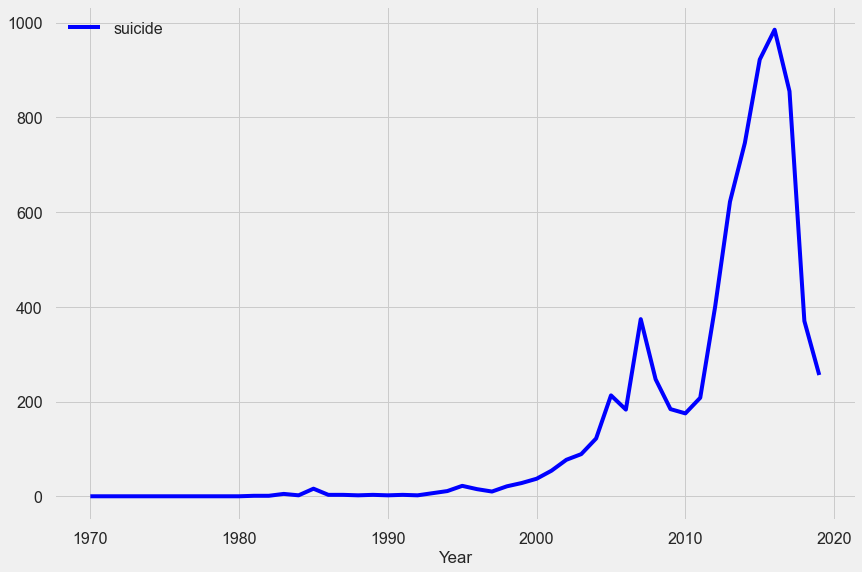

In [416]:
#suicide attacks, both success's and fails
suicides_by_year = terror_1[["Year","suicide"]].groupby("Year").aggregate(np.sum)
suicides_by_year.plot(color = 'b');

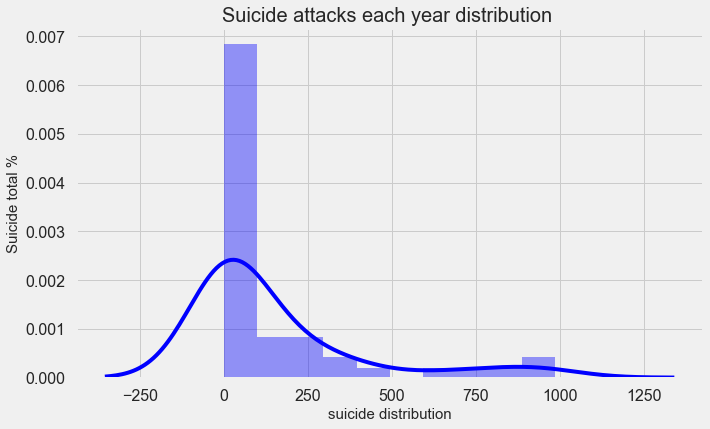

In [417]:
plt.figure(figsize=(10,6))
fig = sns.distplot(terror_1[["Year","suicide"]].groupby("Year").aggregate(np.sum), color = 'b')
fig.set_xlabel("suicide distribution",size=15)
fig.set_ylabel("Suicide total %",size=15)
plt.title('Suicide attacks each year distribution ',size = 20)
plt.show()

In [418]:
#suicide attacks, both success's and fails
suicides_by_year = terror_1[["Year","suicide"]].groupby("Year").aggregate(np.sum)

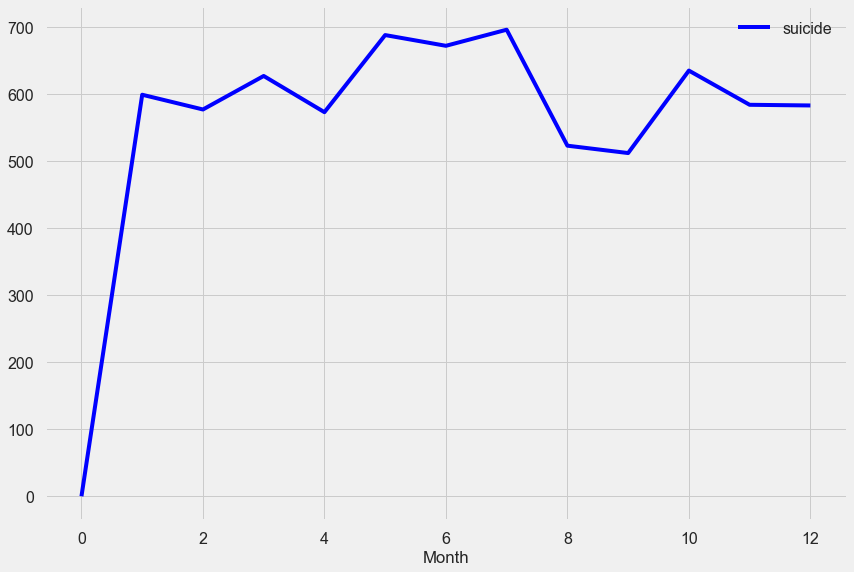

In [419]:
#suicide attacks, both success's and fails
suicides_by_month = terror_1[["Month","suicide"]].groupby("Month").aggregate(np.sum)
suicides_by_month.plot(color = 'b');

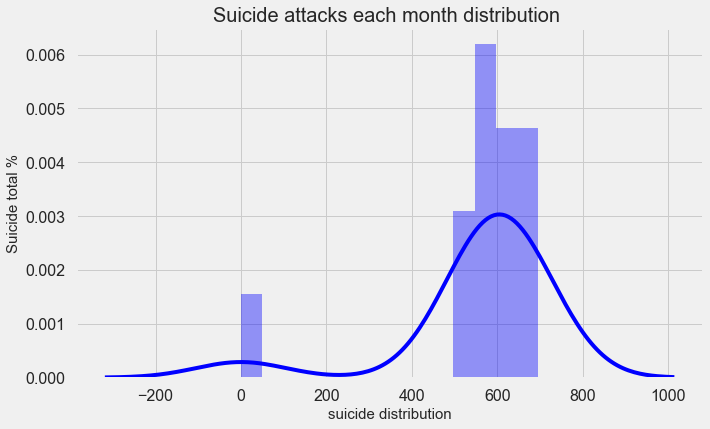

In [420]:
plt.figure(figsize=(10,6))
fig = sns.distplot(terror_1[["Month","suicide"]].groupby("Month").aggregate(np.sum), color = 'b')
fig.set_xlabel("suicide distribution",size=15)
fig.set_ylabel("Suicide total %",size=15)
plt.title('Suicide attacks each month distribution ',size = 20)
plt.show()

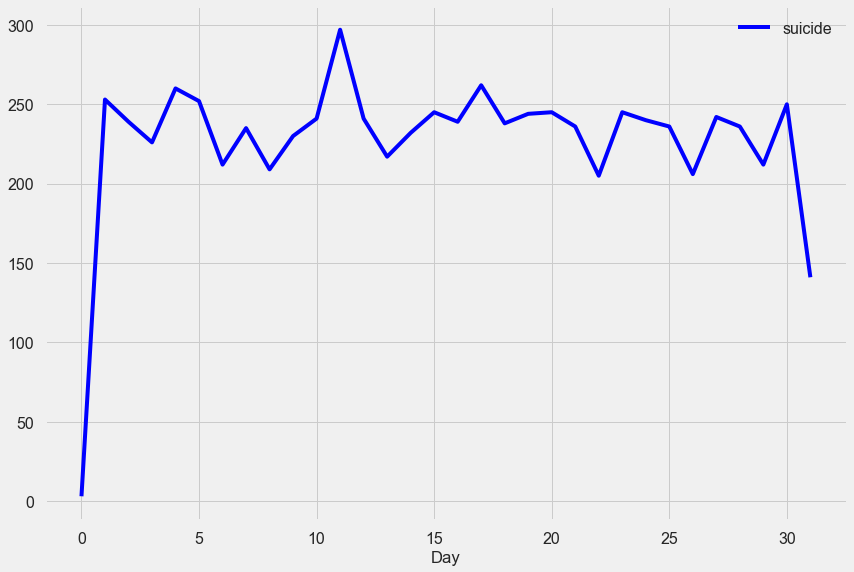

In [421]:
#suicide attacks, both success's and fails
suicides_by_month = terror_1[["Day","suicide"]].groupby("Day").aggregate(np.sum)
suicides_by_month.plot(color = 'b');

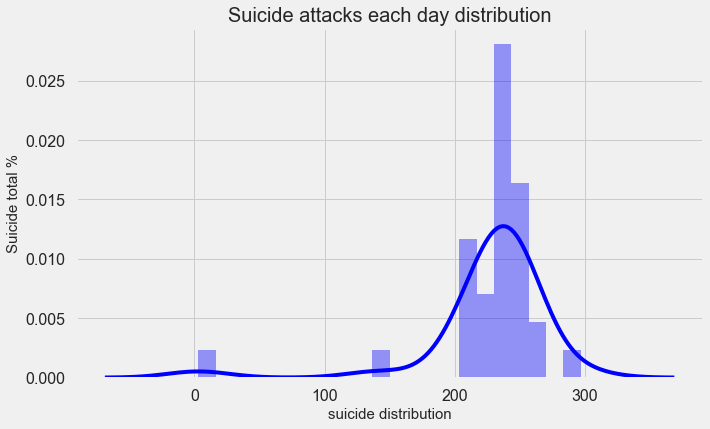

In [422]:
plt.figure(figsize=(10,6))
fig = sns.distplot(terror_1[["Day","suicide"]].groupby("Day").aggregate(np.sum), color = 'b')
fig.set_xlabel("suicide distribution",size=15)
fig.set_ylabel("Suicide total %",size=15)
plt.title('Suicide attacks each day distribution',size = 20)
plt.show()